## Initialization

In [4]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr" ## "all"

%matplotlib inline
# %matplotlib qt
%load_ext autoreload
%autoreload 2

import numpy as np
import cv2
import glob
import pickle
import sys, os, pprint
from datetime import datetime, time
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
pp.pprint(sys.path)

try:
    user_paths = os.environ['PYTHONPATH'].split(os.pathsep)
except KeyError:
    user_paths = []
# pp.pprint(user_paths)

if '.' not in sys.path:
    print("appending '.' to sys.path")
    sys.path.append('.')
try:
    sys.path.remove('../classes')
except:
    pass
try:
    sys.path.remove('..')
except:
    pass
# pp.pprint(sys.path)

# if './classes' not in sys.path:
#     print("appending ./classes to sys.path")
#     sys.path.append('./classes')
    
pp.pprint(sys.path)

print('-'*50)

from classes.camera import Camera

# sampleImages = glob.glob('./test_images/*.jpg')
# sampleCount = len(sampleImages)
# sampleIndexes = range(sampleCount)
sampleVideos = glob.glob('./test_videos/*.mp4')
sampleCount = len(sampleVideos)
sampleIndexes = range(sampleCount)

print()
print(' Sample Videos Filenames: ')
print(' ----------------------- ')
for fn in sampleVideos:
    print('  ', fn)
print()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines
[ 'D:\\Anaconda3\\envs\\carnd-t1\\python36.zip',
  'D:\\Anaconda3\\envs\\carnd-t1\\DLLs',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1',
  '',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\Pythonwin',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\IPython\\extensions',
  'C:\\Users\\kevin\\.ipython',
  '.']
[ 'D:\\Anaconda3\\envs\\carnd-t1\\python36.zip',
  'D:\\Anaconda3\\envs\\carnd-t1\\DLLs',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1',
  '',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32',
  'D:\

In [8]:
try: 
    del cameraConfig
    print(' Existing Camera object deleted')
except: 
    print(' Camera object doesnt exist')
    pass
with open('./cameraConfig_0.pkl', 'rb') as infile:
    cameraConfig = pickle.load(infile)
    print(' Camera calibration file loaded ...')
    
print()
print(' Camera Calibration Matrix :')
print(' ---------------------------')
print(cameraConfig.cameraMatrix)

print(datetime.now())
print(datetime.time(datetime.now()))

 Camera object doesnt exist
 Camera calibration file loaded ...

 Camera Calibration Matrix :
 ---------------------------
[[1.15777818e+03 0.00000000e+00 6.67113857e+02]
 [0.00000000e+00 1.15282217e+03 3.86124583e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
2020-02-18 14:54:49.637031
14:54:49.637031


## ALF Pipeline - Load Sample Image 

###  Instantiate Pipeline

In [5]:
# del acceptFittedPolynoms
from classes.pipeline import ALFPipeline
from classes.videofile import VideoFile
from common.utils      import display_one, display_two, displayFittingInfo

###  Process one frame

In [172]:
videoPipeline = ALFPipeline(cameraConfig) ## , debug = False, outputPath = './output_videos')
# videoPipeline.displayConfig()

inVideo = VideoFile(sampleVideos[0], mode = 'input', fromFrame = 0, toFrame = 150)

 Line init() complete 
 Line init() complete 
 Pipeline initialization complete...

 VideoFile init() routine
 ------------------------
 input args:  {'fromFrame': 0, 'toFrame': 150}

 Information on : .\challenge_video.mp4
 ---------------------------------------
 Width     :  1280.0  Height  :  720.0  Frame Rate:  29.97  Codec     :  828601953.0  Ttl number of frames:  484.0
 Next_frame:  0.0  time(ms):  0.0
 FromFrame :  0    toFrame :  150    ttlFrames:  484
 Next frame to read set to :  0.0
 openVideoFile complete  .\challenge_video.mp4
 videoFile _init() complete  .\challenge_video.mp4


In [173]:
inVideo.setNextFrame(40)
videoPipeline.slidingWindowBootstrap = False
videoPipeline.reset()
outVideo = VideoFile(sampleVideos[0], mode= 'output', suffix = 'Kevin_A', like = inVideo)

 Next frame to read set to :  40.0
 Line init() complete 
 Line init() complete 

 VideoFile init() routine
 ------------------------
 input args:  {'suffix': 'Kevin_A', 'like': <classes.videofile.VideoFile object at 0x000001B8829869E8>}
 opened mp4 file:  ./output_videos\challenge_video_output_Kevin_A.mp4
 videoFile _init() complete  ./output_videos\challenge_video_output_Kevin_A.mp4


In [174]:
# videoPipeline.x_src_top_left       =  630
# videoPipeline.x_src_top_right      =  720
# videoPipeline.x_src_bot_left       =  295
# videoPipeline.x_src_bot_right      = 1105

# videoPipeline.y_src_top            =  470
# videoPipeline.y_src_bot            =  700  

# videoPipeline.RoI_src_points = np.array([ (videoPipeline.x_src_top_left , videoPipeline.y_src_top),
#                                  (videoPipeline.x_src_top_right, videoPipeline.y_src_top),
#                                  (videoPipeline.x_src_bot_right, videoPipeline.y_src_bot),      
#                                  (videoPipeline.x_src_bot_left , videoPipeline.y_src_bot)],dtype = np.float32)  
# videoPipeline.RoI_src_points_list =     [ (videoPipeline.x_src_top_left , videoPipeline.y_src_top),
#                                  (videoPipeline.x_src_top_right, videoPipeline.y_src_top), 
#                                  (videoPipeline.x_src_bot_right, videoPipeline.y_src_bot),
#                                  (videoPipeline.x_src_bot_left , videoPipeline.y_src_bot)]                             


# videoPipeline.RoI_dst_points = np.array([ (videoPipeline.x_dst_left     , videoPipeline.y_dst_top), 
#                                  (videoPipeline.x_dst_right    , videoPipeline.y_dst_top), 
#                                  (videoPipeline.x_dst_right    , videoPipeline.y_dst_bot), 
#                                  (videoPipeline.x_dst_left     , videoPipeline.y_dst_bot)],dtype = np.float32)        
# videoPipeline.RoI_dst_points_list =     [ (videoPipeline.x_dst_left , videoPipeline.y_dst_top), 
#                                  (videoPipeline.x_dst_right, videoPipeline.y_dst_top), 
#                                  (videoPipeline.x_dst_right, videoPipeline.y_dst_bot), 
#                                  (videoPipeline.x_dst_left , videoPipeline.y_dst_bot)]

In [175]:
# videoPipeline.RoI_dst_points.shape

print(videoPipeline.RoI_src_points_list)
print(videoPipeline.RoI_dst_points_list)


print(type(videoPipeline.RoI_src_points), videoPipeline.RoI_src_points.shape, videoPipeline.RoI_src_points.dtype )
print(videoPipeline.RoI_src_points)

print(type(videoPipeline.RoI_dst_points), videoPipeline.RoI_dst_points.shape, videoPipeline.RoI_dst_points.dtype )
print(videoPipeline.RoI_dst_points)


[(600, 480), (740, 480), (1105, 700), (295, 700)]
[(300, 0), (1000, 0), (1000, 719), (300, 719)]
<class 'numpy.ndarray'> (4, 2) float32
[[  600.0000   480.0000]
 [  740.0000   480.0000]
 [ 1105.0000   700.0000]
 [  295.0000   700.0000]]
<class 'numpy.ndarray'> (4, 2) float32
[[  300.0000     0.0000]
 [ 1000.0000     0.0000]
 [ 1000.0000   719.0000]
 [  300.0000   719.0000]]


[[    0.2000    -0.7636   540.0000]
 [   -0.0000    -0.4715   460.0000]
 [    0.0000    -0.0012     1.0000]]
 x_src_top_left : 640   x_src_top_right: 710   x_src_bot_left: 295   x_src_bot_right: 1105
 y_src_top      : 470   y_src_bot      : 700 

[[    0.2000    -0.7636   540.0000]
 [   -0.0000    -0.4715   460.0000]
 [    0.0000    -0.0012     1.0000]]
 x_src_top_left : 625   x_src_top_right: 730   x_src_bot_left: 295   x_src_bot_right: 1105
 y_src_top      : 470   y_src_bot      : 700 

####  Read next image and process

Frame: 40   Curr pos(ms): 1334.67
 Warped img RGB Mean: 133.63   Normal Conditions: True   use: cmb_rgb_lvl_sat  


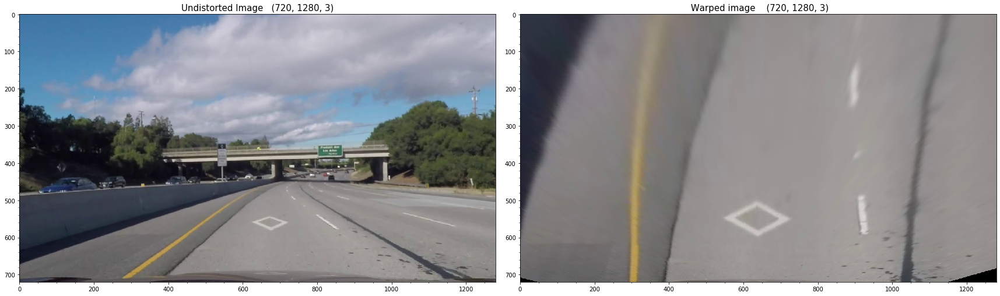

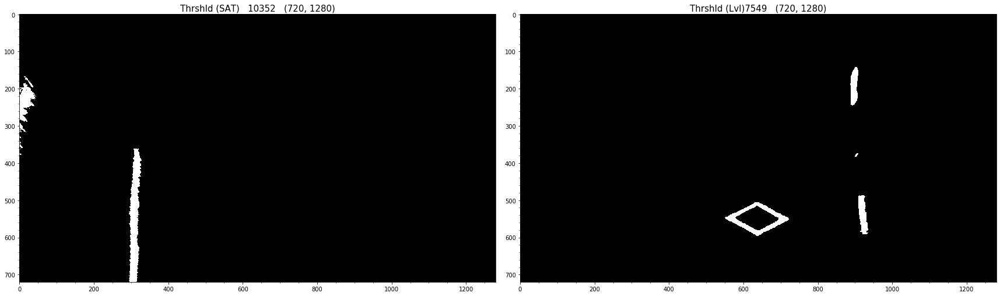

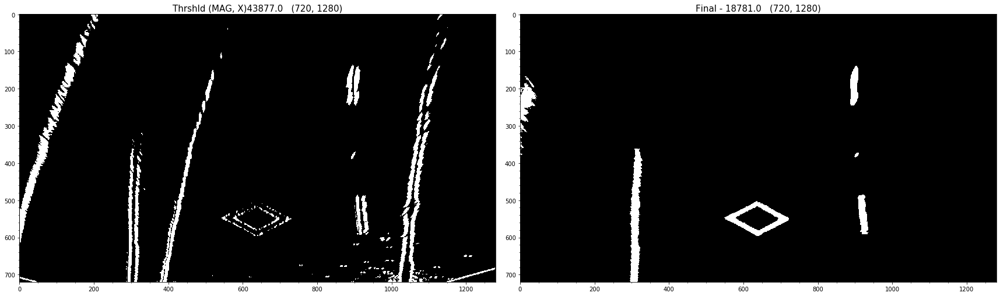

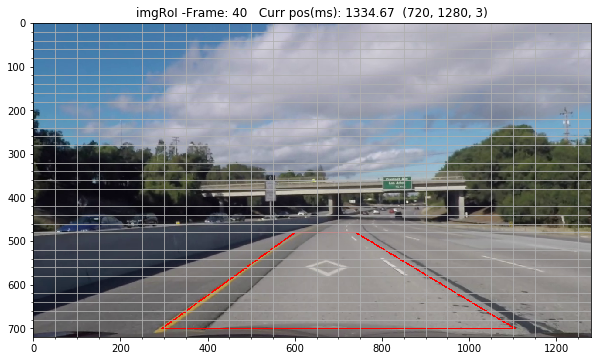

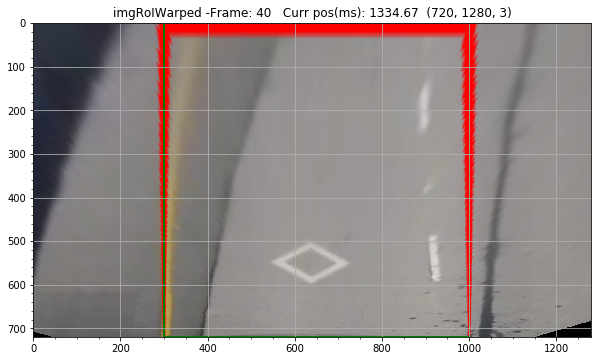

[[    0.2000    -0.7636   540.0000]
 [   -0.0000    -0.4993   480.0000]
 [    0.0000    -0.0012     1.0000]]
 x_src_top_left : 600   x_src_top_right: 740   x_src_bot_left: 295   x_src_bot_right: 1105
 y_src_top      : 480   y_src_bot      : 700 

 histogram shape before padding:  (740,)
 histogram shape after padding :  (1280,)
 Run find_lane_pixels()  - histRange: (270, 1010)
 Midpoint (histogram//2): 640 
 Histogram left side max: 302  right side max: 281
 Histogram left side max: 302  right side max: 921
 MX                : 0.0053  0.0053 
 MX_nominator   is : 3.7  3.7 
 MX_denominator is : 700  700 
 MY                : 0.0417  0.0417 
 MY_nominator   is : 30  30 
 MY_denominator is : 720  720 
 left x base       :  302   right x base : 921
 window_height     :  60
 nonzero x count   :  18781
 nonzero y count   :  18781
 Starting Positions: left x : 302   right x:  921

 Window:  0  y range:  660  to  720
--------------------------------------------------
 Left  lane X range :  22

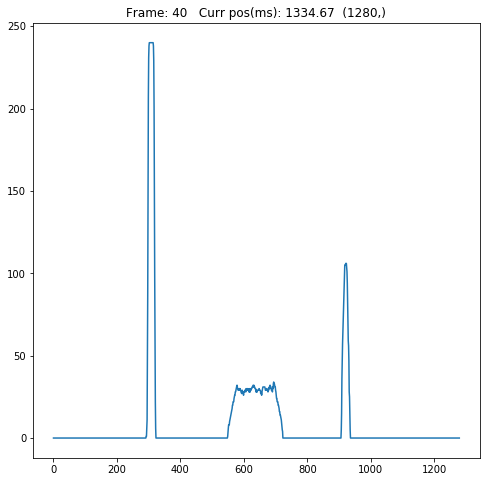

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


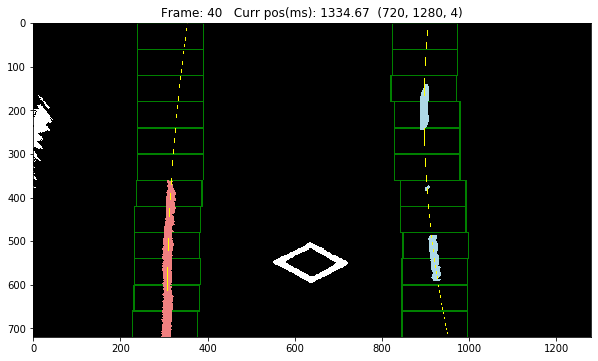

 Accept propsed polynomials  for Frame: 40   Curr pos(ms): 1334.67


In [176]:
rc1, image = inVideo.getNextFrame()
print(inVideo.frameTitle)

if rc1:
    videoPipeline(image,mode = 2, frameTitle = inVideo.frameTitle, displayResults = True,  debug = True, debug2 = False)
#     print(output.shape)

 Part 2 -  Frame: 40   Curr pos(ms): 1334.67


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Figure size 1800x3024 with 0 Axes>

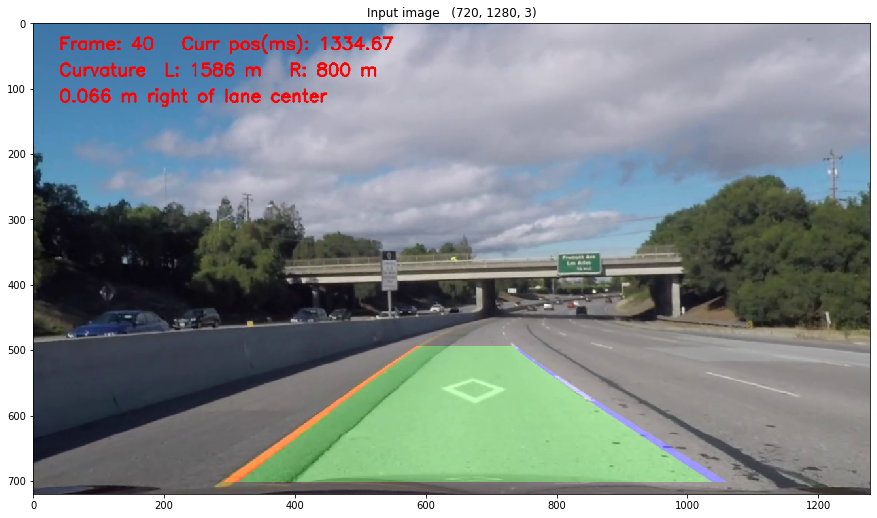

In [177]:
output, disp = videoPipeline.part2(image, mode = 2, frameTitle = inVideo.frameTitle, displayResults = True, debug = True, debug2 = False)

display_one(output, size= 15)

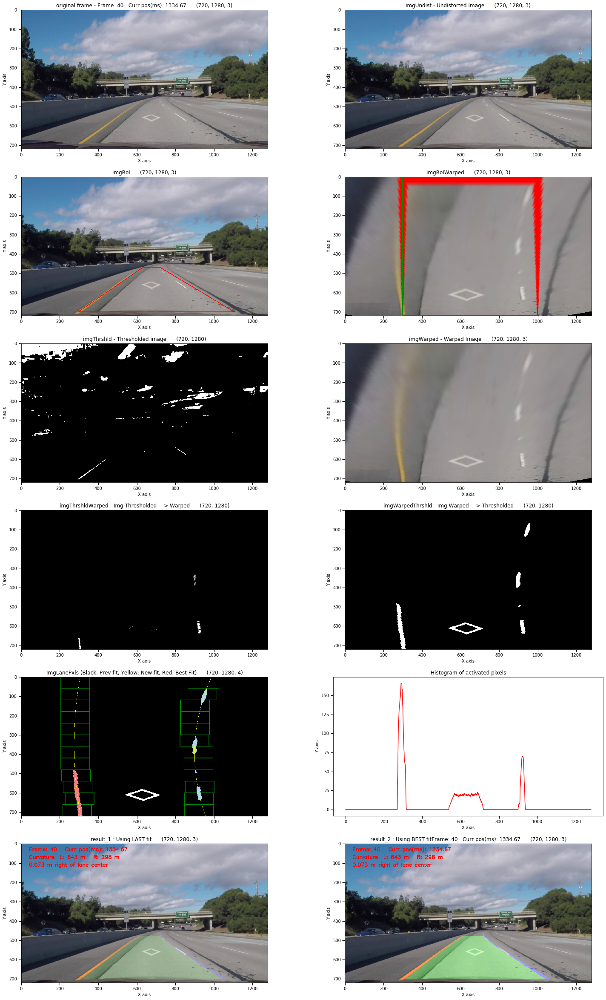

In [134]:
disp.closePlot()

In [326]:
# else:
#     if image == 0: 
#         print(' at ending frame ', videoPipeline.toFrame, videoPipeline.currFrameNum)
#     else:
#         print(' getNextFrame() failed : ',image)    

In [327]:
# print(videoPipeline.LeftLane.best_avg_RSE, videoPipeline.LeftLane.best_prev_avg_RSE)
# print(videoPipeline.LeftLane.best_RSE)
# print(videoPipeline.LeftLane.best_RSE_history)

# print(videoPipeline.LeftLane.fit_avg_RSE, videoPipeline.LeftLane.fit_prev_avg_RSE)
# print(videoPipeline.LeftLane.fit_RSE)
# print(videoPipeline.LeftLane.fit_RSE_history)

# print(videoPipeline.LeftLane.y_checkpoints)
# print(videoPipeline.LeftLane.y_checkpoints >= videoPipeline.LeftLane.y_src_top)

#### Display Fitting Info

Display fitting info for  Frame: 130   Curr pos(ms): 4337.67
----------------------------------------------------------------------

Proposed Polynomial:
left      : [   -0.001423     1.769520  -226.311070]    right     : [    0.000332    -0.515449  1138.084794] 

Current Best Fit Polynomial:
----------------------------------------
left      : [    0.000105    -0.205525   409.810447]    right     : [    0.000309    -0.446108  1097.796125] 

Diff beteween proposed and best_fit polynomial 
Difference: [    0.001529    -1.975045   636.121518]    right     : [   -0.000023     0.069341   -40.288669] 

Proposed RSE with best fit - LLane: 636.125   RLane :  40.289 

Best fit RSE Hist LeftLane  :  ['   0.349', '   4.843', '   6.558', '  10.487', '   3.024', '   5.069', '   1.243', '   1.167']
Best fit RSE Hist RightLane :  ['   0.730', '   1.691', '   4.001', '   2.610', '   3.332', '   2.223', '   1.122', '   3.382']

Previously Accepted Fit Polynomials:
-------------------------------------

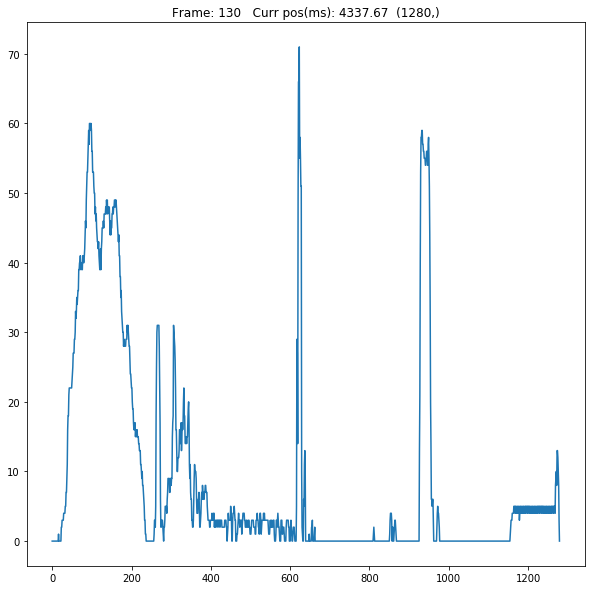

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


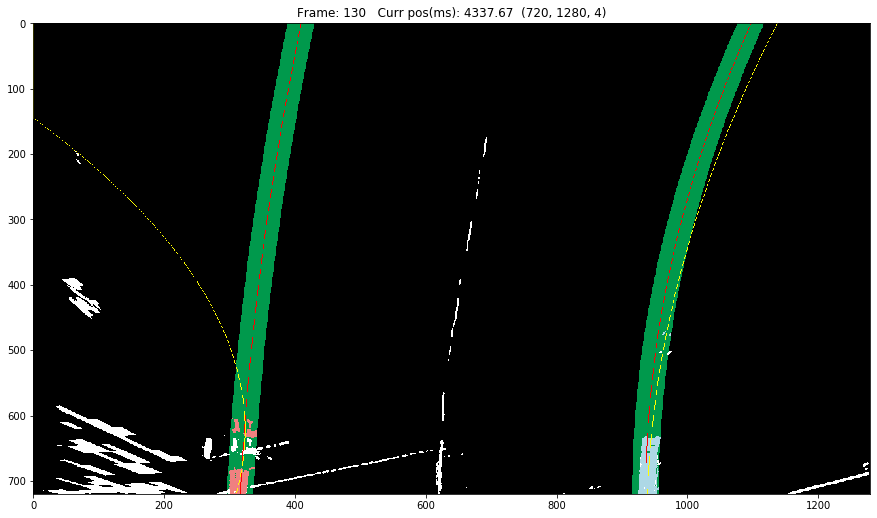

In [305]:
displayFittingInfo(inVideo.frameTitle, videoPipeline.LeftLane, videoPipeline.RightLane, videoPipeline.histogram, videoPipeline.out_img)

#### Close input/output files

In [178]:
# outVideo.saveFrameToImage(output, frameNum = inVideo.currFrameNum)
outVideo.closeVideoFile()

inVideo.closeVideoFile()

 output video file closed
 input video file closed


### Process frame range

In [6]:
from classes.pipeline import ALFPipeline
from classes.videofile import VideoFile
from common.utils import display_one, display_two

In [9]:
try: 
    del videoPipeline
except: 
    pass
finally:
    videoPipeline = ALFPipeline(cameraConfig, debug = False, outputPath = './output_videos')

inVideo = VideoFile(sampleVideos[0], mode = 'input', fromFrame = 0)

try:
    outVideo.closeVideoFile()    
except:
    pass
finally:
    outVideo = VideoFile(sampleVideos[0], mode= 'output', outputPath = './challenge_output_videos',suffix = '02-18-20', like = inVideo)
# inVideo.toFrame = 484
# inVideo.setNextFrame(100)
# videoPipeline.reset()
# videoPipeline.displayConfig()

 Line init() complete 
 Line init() complete 
 Pipeline initialization complete...

 VideoFile init() routine
 ------------------------
 input args:  {'fromFrame': 0}

 Information on : ./test_videos\challenge_video.mp4
 ---------------------------------------------------
 Width     :  1280.0  Height  :  720.0  Frame Rate:  29.97  Codec     :  828601953.0  Ttl number of frames:  484.0
 Next_frame:  0.0  time(ms):  0.0
 FromFrame :  0    toFrame :  484    ttlFrames:  484
 Next frame to read set to :  0.0
 openVideoFile complete  ./test_videos\challenge_video.mp4
 videoFile _init() complete  ./test_videos\challenge_video.mp4

 VideoFile init() routine
 ------------------------
 input args:  {'suffix': '02-18-20', 'like': <classes.videofile.VideoFile object at 0x000001E19CD5E470>}
 opened mp4 file:  ./challenge_output_videos\challenge_video_output_02-18-20.mp4
 videoFile _init() complete  ./challenge_output_videos\challenge_video_output_02-18-20.mp4


In [181]:
# inVideo.setFrameRange(300, 380)
# videoPipeline.reset()

In [10]:
print(' Next frame to read set to : ', inVideo.videoFile.get(cv2.CAP_PROP_POS_FRAMES), ' currFrameNum: ', inVideo.currFrameNum)
print(' Frame range starting from: ', inVideo.fromFrame, ' ending at frame: ', inVideo.toFrame) 
print('---------------------------------------------------------------------------------------------------')
print()

 Next frame to read set to :  0.0  currFrameNum:  -1
 Frame range starting from:  0  ending at frame:  484
---------------------------------------------------------------------------------------------------



In [188]:
i = 1
rc1, image = inVideo.getNextFrame()
print(inVideo.frameTitle)

Frame: 0   Curr pos(ms): 0.0


In [189]:
while rc1:
# if rc1:
    i += 1
#   display_one(output, title = videoPipeline.frame_title)|

#     print(inVideo.frameTitle)
    if i % 10 == 0:
        print(' > ',datetime.time(datetime.now())," - " , inVideo.frameTitle  )
        
    videoPipeline(image, mode = 2, frameTitle = inVideo.frameTitle, displayResults = False, debug = False, debug2 = False)
    output, disp = videoPipeline.part2(image, mode = 2, frameTitle = inVideo.frameTitle, displayResults = False, debug = False, debug2 = False)
    
    outVideo.saveFrameToVideo(output, debug = False)        
#     outVideo.saveFrameToImage(output, frameNum = inVideo.currFrameNum, debug = False)
    
    rc1, image = inVideo.getNextFrame()
    if i > 1000:
        print(' break 1')
        
else:
    if image != 0: 
        print(' getNextFrame() failed : ',image)
    outVideo.closeVideoFile()

 Part 2 -  Frame: 0   Curr pos(ms): 0.0
 Part 2 -  Frame: 1   Curr pos(ms): 33.37
 Part 2 -  Frame: 2   Curr pos(ms): 66.73
 Part 2 -  Frame: 3   Curr pos(ms): 100.1
 Part 2 -  Frame: 4   Curr pos(ms): 133.47
 Part 2 -  Frame: 5   Curr pos(ms): 166.83
 Part 2 -  Frame: 6   Curr pos(ms): 200.2
 Part 2 -  Frame: 7   Curr pos(ms): 233.57
 >  15:23:24.010383  -  Frame: 8   Curr pos(ms): 266.93
 Part 2 -  Frame: 8   Curr pos(ms): 266.93
 Part 2 -  Frame: 9   Curr pos(ms): 300.3
 Part 2 -  Frame: 10   Curr pos(ms): 333.67
 Part 2 -  Frame: 11   Curr pos(ms): 367.03
 Part 2 -  Frame: 12   Curr pos(ms): 400.4
 Part 2 -  Frame: 13   Curr pos(ms): 433.77
 Part 2 -  Frame: 14   Curr pos(ms): 467.13
 Part 2 -  Frame: 15   Curr pos(ms): 500.5
 Part 2 -  Frame: 16   Curr pos(ms): 533.87
 Part 2 -  Frame: 17   Curr pos(ms): 567.23
 >  15:23:28.580382  -  Frame: 18   Curr pos(ms): 600.6
 Part 2 -  Frame: 18   Curr pos(ms): 600.6
 Part 2 -  Frame: 19   Curr pos(ms): 633.97
 Part 2 -  Frame: 20   Curr p

 Part 2 -  Frame: 163   Curr pos(ms): 5438.77
 Part 2 -  Frame: 164   Curr pos(ms): 5472.13
 Part 2 -  Frame: 165   Curr pos(ms): 5505.5
 Part 2 -  Frame: 166   Curr pos(ms): 5538.87
 Part 2 -  Frame: 167   Curr pos(ms): 5572.23
 >  15:24:37.290380  -  Frame: 168   Curr pos(ms): 5605.6
 Part 2 -  Frame: 168   Curr pos(ms): 5605.6
 Part 2 -  Frame: 169   Curr pos(ms): 5638.97
 Part 2 -  Frame: 170   Curr pos(ms): 5672.33
 Part 2 -  Frame: 171   Curr pos(ms): 5705.7
 Part 2 -  Frame: 172   Curr pos(ms): 5739.07
 Part 2 -  Frame: 173   Curr pos(ms): 5772.43
 Part 2 -  Frame: 174   Curr pos(ms): 5805.8
 Part 2 -  Frame: 175   Curr pos(ms): 5839.17
 Part 2 -  Frame: 176   Curr pos(ms): 5872.53
 Part 2 -  Frame: 177   Curr pos(ms): 5905.9
 >  15:24:42.256385  -  Frame: 178   Curr pos(ms): 5939.27
 Part 2 -  Frame: 178   Curr pos(ms): 5939.27
 Part 2 -  Frame: 179   Curr pos(ms): 5972.63
 Part 2 -  Frame: 180   Curr pos(ms): 6006.0
 Part 2 -  Frame: 181   Curr pos(ms): 6039.37
 Part 2 -  Fram

 Part 2 -  Frame: 322   Curr pos(ms): 10744.07
 Part 2 -  Frame: 323   Curr pos(ms): 10777.43
 Part 2 -  Frame: 324   Curr pos(ms): 10810.8
 Part 2 -  Frame: 325   Curr pos(ms): 10844.17
 Part 2 -  Frame: 326   Curr pos(ms): 10877.53
 Part 2 -  Frame: 327   Curr pos(ms): 10910.9
 >  15:25:50.234380  -  Frame: 328   Curr pos(ms): 10944.27
 Part 2 -  Frame: 328   Curr pos(ms): 10944.27
 Part 2 -  Frame: 329   Curr pos(ms): 10977.63
 Part 2 -  Frame: 330   Curr pos(ms): 11011.0
 Part 2 -  Frame: 331   Curr pos(ms): 11044.37
 Part 2 -  Frame: 332   Curr pos(ms): 11077.73
 Part 2 -  Frame: 333   Curr pos(ms): 11111.1
 Part 2 -  Frame: 334   Curr pos(ms): 11144.47
 Part 2 -  Frame: 335   Curr pos(ms): 11177.83
 Part 2 -  Frame: 336   Curr pos(ms): 11211.2
 Part 2 -  Frame: 337   Curr pos(ms): 11244.57
 >  15:25:54.694381  -  Frame: 338   Curr pos(ms): 11277.93
 Part 2 -  Frame: 338   Curr pos(ms): 11277.93
 Part 2 -  Frame: 339   Curr pos(ms): 11311.3
 Part 2 -  Frame: 340   Curr pos(ms): 11

In [108]:
videoPipeline.LeftLane.MX_denom

700

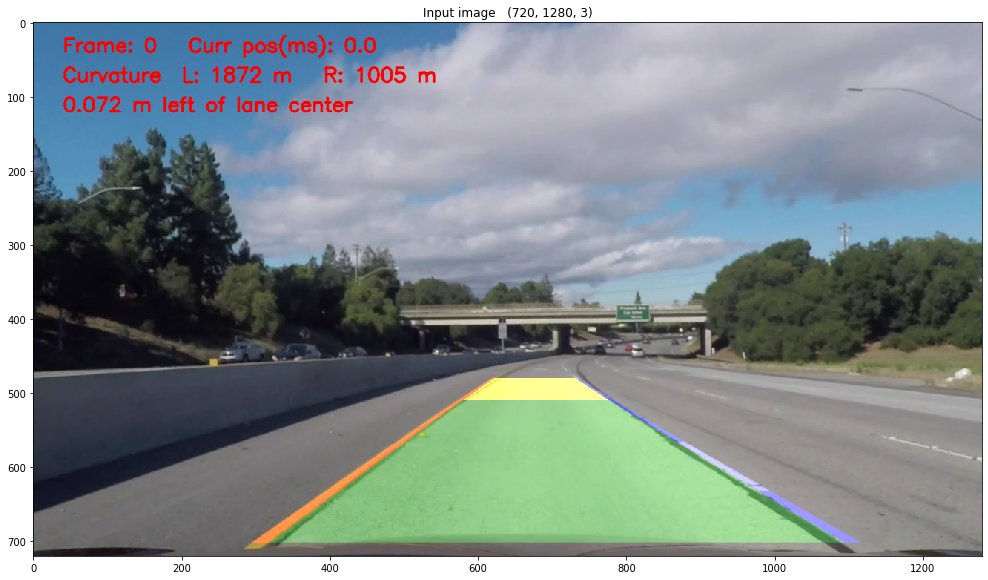

In [109]:
display_one(output, size = 17)

In [89]:
disp

In [372]:
# videoPipeline.displayPipelineInfo()

In [191]:
inVideo.closeVideoFile()
outVideo.closeVideoFile()

 input video file closed
 output video file closed


## Process Video

In [17]:
# Import everything needed to edit/save/watch video clips
import imageio
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### `project_video.mp4`

In [312]:
video_output = './output_videos/project_video_output_V2.mp4'
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("./project_video.mp4")  ## .subclip(0,5)
video_clip = clip1.fl_image(videoPipeline) #NOTE: this function expects color images!!


In [313]:
%time video_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video ./output_videos/project_video_output_V2.mp4
[MoviePy] Writing video ./output_videos/project_video_output_V2.mp4


100%|██████████████████████████████████████████████████████████████████████████▉| 1260/1261 [17:29<00:00,  1.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/project_video_output_V2.mp4 

Wall time: 17min 30s


### `challenge_video.mp4`

In [18]:
video_output = './output_videos/challenge_video_output_V2.mp4'
clip = VideoFileClip("./challenge_video.mp4") ##.subclip(0,5)
video_clip = clip.fl_image(videoPipeline) #NOTE: this function expects color images!!


In [19]:
%time video_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video ./output_videos/challenge_video_output_V2.mp4
[MoviePy] Writing video ./output_videos/challenge_video_output_V2.mp4


100%|█████████████████████████████████████████████████████████████████████████████| 485/485 [03:55<00:00,  2.06it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_videos/challenge_video_output_V2.mp4 

Wall time: 3min 56s


## Run step by step

### Misc Code - Code for debug display section

In [500]:
# print(RightLane.line_base_pixels)
# lanewidth_pixels =  round(RightLane.best_xfitted[700] - LeftLane.best_xfitted[700], 3)
# print(RightLane.best_xfitted[700] ,LeftLane.best_xfitted[700], lanewidth_pixels)
# print(LeftLane.MX_nom, LeftLane.MX_denom, LeftLane.MX)
# print(RightLane.MX_nom, RightLane.MX_denom, RightLane.MX)
# LeftLane.set_MX(3.7, lanewidth_pixels)
# RightLane.set_MX(3.7, lanewidth_pixels)
# print(LeftLane.MX_nom, LeftLane.MX_denom, LeftLane.MX)
# print(RightLane.MX_nom, RightLane.MX_denom, RightLane.MX)


##  Averaging the xfitted_history results in same output as best_xfitted
## 
# LeftLane.avg_xfitted = np.sum(LeftLane.xfitted_history, axis = 0)/ len(LeftLane.xfitted_history)
# RightLane.avg_xfitted = np.sum(RightLane.xfitted_history, axis = 0)/ len(RightLane.xfitted_history)
# print(LeftLane.avg_xfitted.shape, RightLane.avg_xfitted.shape)
# 0.2/LeftLane.MX

# LeftLane.get_slope_v1( 10, LeftLane.current_xfitted, debug=True)
# LeftLane.get_slope_v1(350, LeftLane.current_xfitted, debug=True)
# LeftLane.get_slope_v1(700, LeftLane.current_xfitted, debug=True)
# print()
# RightLane.get_slope_v1( 10, RightLane.current_xfitted, debug=True)
# RightLane.get_slope_v1(350, RightLane.current_xfitted, debug=True)
# RightLane.get_slope_v1(700, RightLane.current_xfitted, debug=True)

# print()
# LeftLane.get_slope( 10 , LeftLane.current_fit, debug=True)
# LeftLane.get_slope(350 , LeftLane.current_fit, debug=True)
# LeftLane.get_slope(700 , LeftLane.current_fit, debug=True)
# print()
# RightLane.get_slope( 10, RightLane.current_fit, debug=True)
# RightLane.get_slope(350, RightLane.current_fit, debug=True)
# RightLane.get_slope(700, RightLane.current_fit, debug=True)

# LeftLane.get_slope_mtrs(700, LeftLane.best_fit, debug=True)
# RightLane.get_slope_mtrs(700, RightLane.best_fit, debug=True)

# print(LeftLane.best_fit, RightLane.best_fit)

# # LeftLane.set_curvature(curvature_y_eval, LeftLane.current_fit, debug = True)
# # RightLane.set_curvature(curvature_y_eval, RightLane.current_fit, debug = True)
# ltt = LeftLane.get_slope(LeftLane.y_checkpoints, LeftLane.current_fit)
# rtt = RightLane.get_slope(RightLane.y_checkpoints, RightLane.current_fit)
# print()
# print(ltt)
# print(rtt)
# print(rtt-ltt)

# print()
# ltt = LeftLane.get_slope(LeftLane.y_checkpoints, LeftLane.best_fit)
# rtt = RightLane.get_slope(RightLane.y_checkpoints, RightLane.best_fit)
# print(ltt)
# print(rtt)
# print(rtt-ltt)

In [ ]:
# image_id = 7
# image = mpimg.imread(sampleImages[image_id])
# filename_ext = os.path.basename(sampleImages[image_id])
# filename = os.path.splitext(filename_ext)
# print(' Input image:', filename_ext)


In [34]:
# warpedRoIVertices_list = [(x_transform_left-2 , 0), 
#                           (x_transform_right+2, 0), 
#                           (x_transform_right+2, height-1), 
#                           (x_transform_left-2 , height-1)]
# warpedRoIVertices = np.array([warpedRoIVertices_list],dtype = np.int32)
 
    
### 
# blurKernel = 3
# imgUndist = gaussian_blur(imgUndist, blurKernel)
## Image Tresholding

In [63]:
# def run_pipeline_on_video_frame_range(pipelineFunction, videoFile, fromFrame = 0 , toFrame = 0, debug = False):
"""
Apply pipeline processing on a range of frames  of a video stream

pipeline_function:  Name of pipeline function to use for processing
videoFile        :  Video file to process
fromFrame        :  Starting frame number 
toFrame          :  Ending frame
"""
# videoFile = sampleVideos[0]
# outputPath = './output_videos'
# cap = cv2.VideoCapture(videoFile)

# if (cap.isOpened()== False): 
#     print("Error opening video stream or file")

# print()
# print(' Information on :', videoFile)
# print(' ','-'*(18+len(videoFile)))
# print(' Next_frame: ', cap.get(1), ' time(ms): ', cap.get(0),' Width: ',cap.get(3),' Height: ',cap.get(4), 'Frame Rate: ',
#       round(cap.get(5),2), ' Ttl number of frames: ', cap.get(7))

# ret, imageBGR = cap.read()
# if imageBGR is not None:
#     currFrame = cap.get(1) - 1
#     print(' Curr Frame:', currFrame, ' Next: ', cap.get(1), ' time(ms): ', round(cap.get(0),2),' H/W: ',cap.get(4), '/',cap.get(3), 'Frame Rate: ',
#           round(cap.get(5),2) ,  'Ttl frames: ', cap.get(7), '\n')
#     image = cv2.cvtColor(imageBGR, cv2.COLOR_BGR2RGB)
#     frame_title = 'Frame: '+str(int(currFrame))+'   Curr pos(ms): '+ str(round(cap.get(0),1))
# else:
#     print(' ERROR')

'\nApply pipeline processing on a range of frames  of a video stream\n\npipeline_function:  Name of pipeline function to use for processing\nvideoFile        :  Video file to process\nfromFrame        :  Starting frame number \ntoFrame          :  Ending frame\n'

In [ ]:
################################################################################################
# Experiment with using historgram on undistorted image to find source x coordinates for perspective 
# Transformation. The detect points ususally correspond to points inside the lanes.
################################################################################################
# hist, reg, leftx_base, rightx_base = pixel_histogram(imgThrshld, 670, 700 , debug = False)
# x_src_bot_left = leftx_base ;  x_src_bot_right = rightx_base
# display_two(reg, hist,title1= ' Thrshld img - Bottom', title2 = ' Thrshld img - Bottom')
# print(' Left base: ', leftx_base, ' Right base:', rightx_base)
################################################################################################


In [ ]:
################################################################################################
# if debug:
#     display_one(image, title = frame_title)
###----------------------------------------------------------------------------------------------
### Display undistorted color image & perpective transformed image -- WITHOUT RoI line display
###----------------------------------------------------------------------------------------------
# if debug:
#     print('imgUndist shape       :', imgUndist.shape, imgUndist.min(), imgUndist.max())
#     print('imgWarped shape       :', imgWarped.shape, imgWarped.min(), imgWarped.max())
#     display_two(imgUndist  , imgWarped, title1 = 'imgUndist',title2 = ' imgWarped', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display undistorted color image & perpective transformed image -- With RoI line display
###----------------------------------------------------------------------------------------------
### imgRoI   = draw_roi(imgUndist, RoI_vertices_list, thickness = 2)
### imgRoIWarped, _, _ = perspectiveTransform(imgRoI, src_points, dst_points, debug = False)
### print('imgRoI shape       :', imgRoI.shape, imgRoI.min(), imgRoI.max())
### print('imgRoIWarped shape       :', imgRoIWarped.shape, imgRoIWarped.min(), imgRoIWarped.max())
### display_two(imgRoI  , imgRoIWarped, title1 = 'imgRoI',title2 = ' imgRoIWarped', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display thresholded image befoire and after Perspective transform WITHOUT RoI line display
###----------------------------------------------------------------------------------------------
# if debug:
#     print('img Thrshld Warped shape:', imgThrshldWarped.shape, imgThrshldWarped.min(), imgThrshldWarped.max())
#     display_two(imgThrshld, imgThrshldWarped, title1 = 'imgThrshld',title2 = 'imgThrshldWarped', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display thresholded image befoire and after Perspective transform WITH RoI line display
###----------------------------------------------------------------------------------------------
### imgThrshldRoI = draw_roi(imgThrshld, RoI_vertices_list, thickness = 1)
### imgThrshldRoIWarped, M, Minv = perspectiveTransform(imgThrshldRoI, src_points, dst_points, debug = False)
### print('imgThrshldRoI shape     :', imgThrshldRoI.shape, imgThrshldRoI.min(), imgThrshldRoI.max())
### print('img Thrshld Warped shape:', imgThrshldWarped.shape, imgThrshldWarped.min(), imgThrshldWarped.max())
### display_two(imgThrshldRoI, imgThrshldRoIWarped, title1 = 'imgThrshldRoI',title2 = 'imgThrshldRoIWarped', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display thresholded image without and with RoI line display
###----------------------------------------------------------------------------------------------
### display_two(imgThrshld, imgThrshldRoI, title1 = 'imgThrshld',title2 = 'imgThrshldRoI', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display MASKED color image with non RoI regions masked out -- With RoI line display
###----------------------------------------------------------------------------------------------
### imgMaskedDbg = region_of_interest(imgRoI, RoI_vertices)
### imgMaskedWarpedDbg, _, _ = perspectiveTransform(imgMaskedDbg, src_points, dst_points, debug = False)
### print('imgMaskedDebug shape    :', imgMaskedDbg.shape, imgMaskedDbg.min(), imgMaskedDbg.max())
### print('imgMaskedWarpedDbg shape:', imgMaskedWarpedDbg.shape, imgMaskedWarpedDbg.min(), imgMaskedWarpedDbg.max())
### display_two(imgMaskedDbg  , imgMaskedWarpedDbg, title1 = 'imgMaskedDebug',title2 = ' imgMaskedWarpedDebug', winttl = frame_title)
###----------------------------------------------------------------------------------------------
### Display MASKED color image with non RoI regions masked out -- WITHOUT RoI line display
###----------------------------------------------------------------------------------------------
### imgMaskedDbg = region_of_interest(imgUndist, RoI_vertices)
### imgMaskedWarpedDbg, _, _ = perspectiveTransform(imgMaskedDbg, src_points, dst_points, debug = False)
### print('imgMaskedDebug shape    :', imgMaskedDbg.shape, imgMaskedDbg.min(), imgMaskedDbg.max())
### print('imgMaskedWarpedDbg shape:', imgMaskedWarpedDbg.shape, imgMaskedWarpedDbg.min(), imgMaskedWarpedDbg.max())
### display_two(imgMaskedDbg  , imgMaskedWarpedDbg, title1 = 'imgMaskedDebug',title2 = ' imgMaskedWarpedDebug', winttl = frame_title)
###----------------------------------------------------------------------------------------------
###  Display Image warped before Thresholding and Warped AFTER Thresholding
###----------------------------------------------------------------------------------------------
# if debug:
#     imgWarpedThrshldList  = apply_thresholds(imgWarped, ksize=ksize, 
#                                          x_thr = grad_x_thr, y_thr = grad_y_thr, 
#                                        mag_thr = (50,255), dir_thr = (0,10), 
#                                        sat_thr = (80, 255), debug = False)
#     imgWarpedThrshld = imgWarpedThrshldList[-1]
#     print(imgWarpedThrshld.shape)
#     display_two( imgWarpedThrshld, imgThrshldWarped, title1 = 'Warped BEFORE Thresholding', 
#                   title2 = 'Image warped AFTER Thresholding', winttl = frame_title)
################################################################################################

### Open video file

In [502]:
# import matplotlib.pyplot as plt
# import matplotlib.image as mpimg
# from matplotlib import colors
from classes.line   import Line 
from classes.plotting import PlotDisplay
from classes.videofile import VideoFile
from classes.camera import Camera

from common.utils   import *
from common.sobel   import apply_thresholds
# try: 
#     del cameraConfig
#     print(' Existing Camera object deleted')
# except: 
#     print(' Camera object doesnt exist')
#     pass
# with open('./cameraConfig_0.pkl', 'rb') as infile:
#     cameraConfig = pickle.load(infile)
#     print(' Camera calibration file loaded ...')
    
# print()
# print(' Camera Calibration Matrix :')
# print(' ---------------------------')
# print(cameraConfig.cameraMatrix)

inVideo = VideoFile(sampleVideos[0], mode = 'input', fromFrame = 0, toFrame = 200)

HISTORY = 8 
HISTOGRAM_SEARCH_MARGIN  = 370
WINDOW_SEARCH_MARGIN     = 40
# POLY_SEARCH_MARGIN     = 75
POLY_SEARCH_MARGIN       = 20
RGB_MEAN_THRESHOLD = 110
UNITS    = 'm'
NWINDOWS = 9
MINPIX   = 90
MAXPIX   = 8000
# str_units  = 'm'
width           = cameraConfig.width
height          = cameraConfig.height
camera_x        = width //2
camera_y        = height
print(' Camera width : ', cameraConfig.width, ' height: ',cameraConfig.height)

#--adjusted for Project video -------------=
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
# sat_thr    = (90,255)
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# sat_thr    = (130,255)

 
#--adjusted for challenge video --------------------------
# ksize      = 7
# grad_x_thr = (30,255)
# grad_y_thr = (70,255)
# mag_thr    = (35,255)
# dir_thr    = (40,65)
# # sat_thr    = (65,255)
# sat_thr    = (100,255)
# lvl_thr    = (180, 255)
# rgb_thr    = (190,255)
# rgb_thr    = (180,255)

## Image Thresholding params challenge video 1/28/20------
ksize      = 7
grad_x_thr = (30,255)
grad_y_thr = (70,255)
mag_thr    = (35,255)
dir_thr    = (40,65)
sat_thr    = (110,255)
lvl_thr    = (205, 255)
rgb_thr    = (205,255)
##--------------------------------------------------------


 

## Warped Image Threshold params - challenge video -------
# ksize_2      = 7
# grad_x_thr_2 = (30,255)
# grad_y_thr_2 = (70,255)
# mag_thr_2    = (10,50) 
# dir_thr_2    = (5,25)  
# ## dark conditions-----------
# mag_thr_2_dark    = (40,150) 
# dir_thr_2_dark    = (0,20)  
# ##---------------------------
# sat_thr_2    = (70, 255)
# lvl_thr_2    = (180, 255)
# rgb_thr_2    = (180,255)

## Warped Image Threshold params (1/28/20) ---------------
ksize_2      = 7
grad_x_thr_2 = (30,255)
grad_y_thr_2 = (70,255)
## Light Conditions ------------
# mag_thr_2    = (10,50) 
# dir_thr_2    = (0,30)  
## dark conditions--------------
mag_thr_2    = (25,250) 
dir_thr_2    = (0,30)
#-------------------------------
# sat_thr_2    = (70, 255)
# lvl_thr_2    = (180, 255)
# rgb_thr_2    = (180,255)
sat_thr_2    = (110, 255)
lvl_thr_2    = (205, 255)
rgb_thr_2    = (205,255)
##-------------------------------------------------------

x_src_bot_left  =  300
x_src_bot_right = 1100
x_src_top_left  =  600
x_src_top_right =  730

y_src_bot       =  700  
y_src_top       =  480

x_dst_left      = 300
x_dst_right     = 1000
y_dst_top       = 0
y_dst_bot       = height - 1

#-------------------------------------------=
RightLane       = Line(history = HISTORY, height = height, y_src_top = y_src_top, y_src_bot = y_src_bot)
LeftLane        = Line(history = HISTORY, height = height, y_src_top = y_src_top, y_src_bot = y_src_bot)
LeftLane.MX_denom  = 700
RightLane.MX_denom = 700
#-------------------------------------------=
src_points = np.array([ (x_src_top_left , y_src_top),
                        (x_src_top_right, y_src_top),
                        (x_src_bot_right, y_src_bot),      
                        (x_src_bot_left , y_src_bot)],dtype = np.float32)  

dst_points = np.array([ (x_dst_left , y_dst_top), 
                        (x_dst_right, y_dst_top), 
                        (x_dst_right, y_dst_bot), 
                        (x_dst_left , y_dst_bot)],dtype = np.float32)

RoI_x_top_left    = x_src_top_left  ## - 3
RoI_x_top_right   = x_src_top_right ## + 3
RoI_x_bot_left    = x_src_bot_left  ## - 3
RoI_x_bot_right   = x_src_bot_right ## + 3
RoI_y_bot         = y_src_bot       ## + 3
RoI_y_top         = y_src_top       ## - 3

RoI_src_vertices_list = [(RoI_x_bot_left , RoI_y_bot), 
                         (RoI_x_top_left , RoI_y_top), 
                         (RoI_x_top_right, RoI_y_top), 
                         (RoI_x_bot_right, RoI_y_bot)]

RoI_src_vertices      = np.array([RoI_src_vertices_list],dtype = np.int32)


RoI_dst_vertices_list = [(x_dst_left , y_dst_top), 
                         (x_dst_right, y_dst_top), 
                         (x_dst_right, y_dst_bot), 
                         (x_dst_left , y_dst_bot)]
UndistRGBMean = [] 
WarpedRGBMean = []

curvature_y_eval = y_src_bot
offCenter_y_eval = y_src_bot
slidingWindowBootstrap   = False
print(' Y bottom: ', y_src_bot, '   y_top : ', y_src_top)

fromFrame = 100
inVideo.setNextFrame(fromFrame)
slidingWindowBootstrap = False
print(' Next frame to read set to : ', inVideo.videoFile.get(cv2.CAP_PROP_POS_FRAMES))
print(' Starting from frame: ', inVideo.fromFrame)    


 VideoFile init() routine
 ------------------------
 input args:  {'fromFrame': 0, 'toFrame': 200}

 Information on : .\challenge_video.mp4
 ---------------------------------------
 Width     :  1280.0  Height  :  720.0  Frame Rate:  29.97  Codec     :  828601953.0  Ttl number of frames:  484.0
 Next_frame:  0.0  time(ms):  0.0
 FromFrame :  0    toFrame :  200    ttlFrames:  484
 Next frame to read set to :  0.0
 Frame range starting from:  0  ending at frame:  200
 self.rangeFinished :  200  Next frame:  0.0  ... Make sure pipeline is RESET
 openVideoFile complete  .\challenge_video.mp4
 videoFile _init() complete  .\challenge_video.mp4
 Camera width :  1280  height:  720
 y_checkpoints:  [       700        600        500        480        400        300        200        100          0]
 Line init() complete 
 y_checkpoints:  [       700        600        500        480        400        300        200        100          0]
 Line init() complete 
 Y bottom:  700    y_top :  480
 N

### Reset thresholding parms if necessary

In [503]:
# POLY_SEARCH_MARGIN = 20
# WINDOW_SEARCH_MARGIN = 25
# firstFrame = True

In [504]:
inVideo.setNextFrame(110)

 Next frame to read set to :  110.0
 Frame range starting from:  0  ending at frame:  200
 self.rangeFinished :  200  Next frame:  110.0  ... Make sure pipeline is RESET


110

In [505]:
np_format = {}
np_format['float'] = lambda x: "%10.4f" % x
np_format['int']   = lambda x: "%10d" % x
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =100, formatter = np_format)

### Read next Frame  and Process

In [612]:
rc1, image = inVideo.getNextFrame()
if not rc1:
    print(' getNextFrame() failed : ',image, ' ending frame: ', inVideo.toFrame, 'curr frame num: ', inVideo.currFrameNum)  
else:    
    print(inVideo.frameTitle,' rc: ', rc1, ' output shape: ', image.shape)
    frame_title = inVideo.frameTitle

Frame: 115   Curr pos(ms): 3837.17  rc:  True  output shape:  (720, 1280, 3)


In [613]:
### PIPELINE 
imgUndist      = cameraConfig.undistortImage(image)
imgGammaCorr   = adjust_gamma(imgUndist, gamma=2.5)
imgContrastAdj = adjust_contrast(imgUndist, alpha = 1.7, beta = 5)
img_to_process = imgUndist
imgWarped, _, Minv_imgUndist = perspectiveTransform(img_to_process, src_points, dst_points, debug = False)
WarpedRGBMean.append(imgWarped.mean())
UndistRGBMean.append(imgUndist.mean())


# thresholdResult = 'cmb_rgb_lvl_sat'
# thresholdResult = 'cmb_mag_x'
# thresholdResult = 'cmb_rgb_lvl_sat_mag_x'

if WarpedRGBMean[-1] < RGB_MEAN_THRESHOLD :
    NormalConditions = False
    thresholdResult  = 'cmb_rgb_lvl_sat_mag_x'
else:
    NormalConditions = True 
    thresholdResult  = 'cmb_rgb_lvl_sat'
    
print(' Undist RGB Mean: {:6.2f}  Warped RGBMean: {:6.2f} '.format(UndistRGBMean[-1],  WarpedRGBMean[-1]))
print(' Normal Conditions is ', NormalConditions, ' use threshold result:', thresholdResult)

##----------------------------------------------------------------------------------------------
### Display undistorted color image & perpective transformed image -- With RoI line display
###----------------------------------------------------------------------------------------------
imgRoI   = displayRoILines(img_to_process, RoI_src_vertices_list, thickness = 2)
imgRoIWarped, _, _ = perspectiveTransform(imgRoI, src_points, dst_points, debug = False)
imgRoIWarped = displayRoILines(imgRoIWarped, RoI_dst_vertices_list, thickness = 2, color = 'green')
# display_one(imgRoI  , title = 'imgRoI -'+frame_title, winttl = frame_title, grid = 'major',size=size)
# display_one(imgRoIWarped  , title = 'imgRoIWarped -'+frame_title, winttl = frame_title, grid = 'major', size = size)
# display_two(imgRoI, imgRoIWarped)

 Undist RGB Mean:  95.36  Warped RGBMean: 100.31 
 Normal Conditions is  False  use threshold result: cmb_rgb_lvl_sat_mag_x


In [614]:
## Image Thresholding params------
ksize      = 7
grad_x_thr = (30,255)
grad_y_thr = (70,255)
mag_thr    = (35,255)
dir_thr    = (40,65)
# sat_thr  = (65,255)
sat_thr    = (110,255)
lvl_thr    = (205, 255)
rgb_thr    = (205,255)
##-------------------------------
print('='*100)
print(' Apply thresholding BEFORE warping - ', frame_title)
print('='*100)      
output1 = apply_thresholds_v2(img_to_process, ksize = ksize, debug = False,
                                       x_thr = grad_x_thr, y_thr = grad_y_thr, mag_thr = mag_thr,  
                                     dir_thr = dir_thr,  sat_thr = sat_thr,    
                                     rgb_thr = rgb_thr,  lvl_thr = lvl_thr)
imgThrshld = output1[thresholdResult]
imgThrshldWarped, _, Minv_imgThrshld = perspectiveTransform(imgThrshld, src_points, dst_points, debug = False)

 Apply thresholding BEFORE warping -  Frame: 115   Curr pos(ms): 3837.17


 Apply thresholding AFTER warping -  Frame: 115   Curr pos(ms): 3837.17
 Undist RGB Mean:  95.36  Warped RGBMean: 100.31 
 Normal Conditions is  False  use threshold result: cmb_rgb_lvl_sat_mag_x


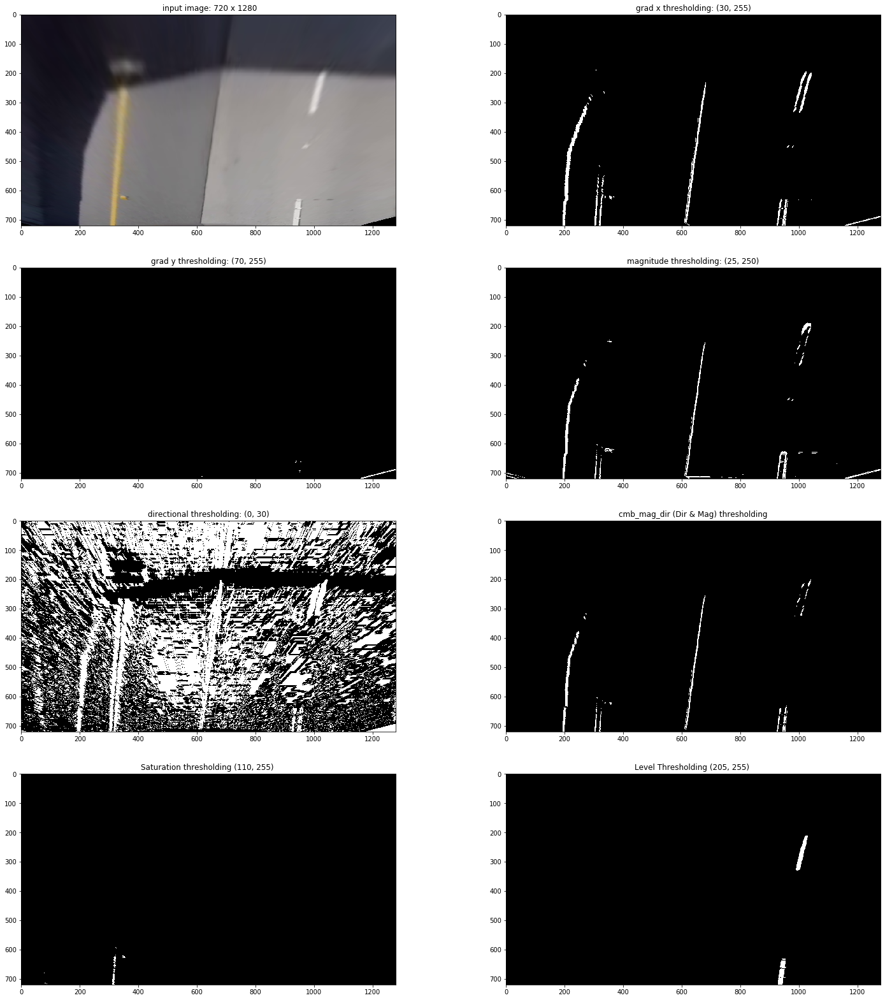

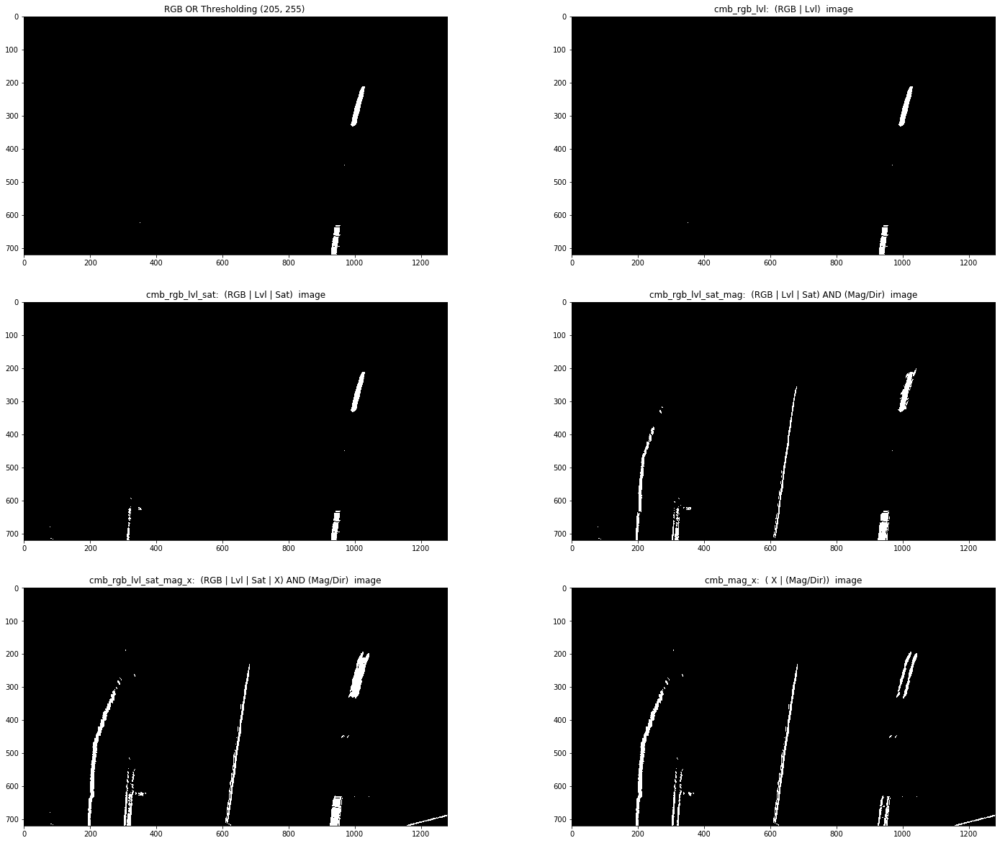

In [615]:
print('='*100)
print(' Apply thresholding AFTER warping - ',frame_title)
print('='*100)      

ksize_2      = 7
grad_x_thr_2 = (30,255)
grad_y_thr_2 = (70,255)

print(' Undist RGB Mean: {:6.2f}  Warped RGBMean: {:6.2f} '.format(UndistRGBMean[-1],  WarpedRGBMean[-1]))
print(' Normal Conditions is ', NormalConditions, ' use threshold result:', thresholdResult)

if NormalConditions:
## Warped Image Threshold params------
    ## Light Conditions ------------
    mag_thr_2    = (10,50) 
    dir_thr_2    = (0,30)  
    sat_thr_2    = (80, 255)
    ## dark conditions--------------
#     mag_thr_2    = (25,250) 
#     dir_thr_2    = (0,30)
#     sat_thr_2    = (110, 255)
    #-------------------------------
    # sat_thr_2    = (70, 255)
    # lvl_thr_2    = (180, 255)
    # rgb_thr_2    = (180,255)
    lvl_thr_2    = (180, 255)
    rgb_thr_2    = (180,255)
else:
    ## Light Conditions ------------
    # mag_thr_2    = (10,50) 
    # dir_thr_2    = (0,30)  
    # sat_thr_2    = (80, 255)
    ## dark conditions--------------
    mag_thr_2    = (25,250) 
    dir_thr_2    = (0,30)
    sat_thr_2    = (110, 255)
    #-------------------------------
    # sat_thr_2    = (70, 255)
    # lvl_thr_2    = (180, 255)
    # rgb_thr_2    = (180,255)
    lvl_thr_2    = (205, 255)
    rgb_thr_2    = (205,255)
##----------------------------------
output2  = apply_thresholds(imgWarped, ksize = ksize_2, debug = True,
                                              x_thr = grad_x_thr_2, y_thr = grad_y_thr_2, sat_thr = sat_thr_2, 
                                            mag_thr = mag_thr_2, dir_thr = dir_thr_2,  
                                            rgb_thr = rgb_thr_2, lvl_thr = lvl_thr_2 )

imgWarpedThrshld     = output2[thresholdResult]

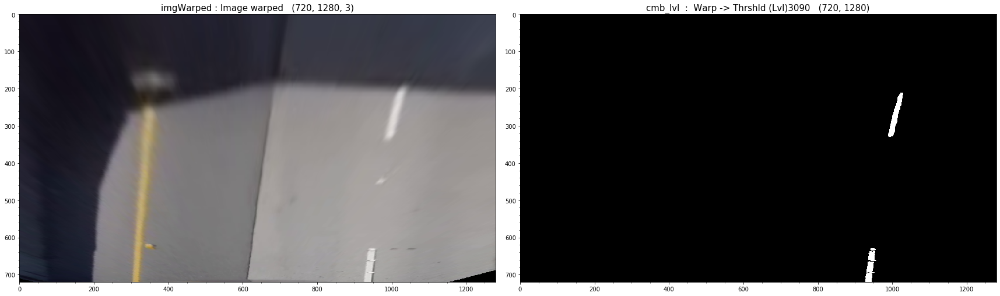

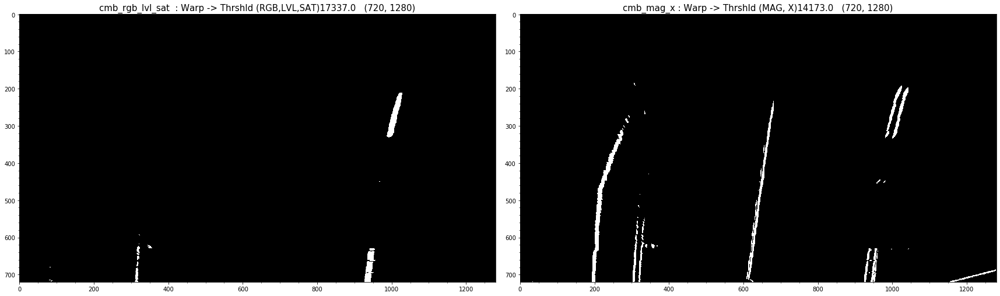

 RESULTS -  Frame: 115   Curr pos(ms): 3837.17


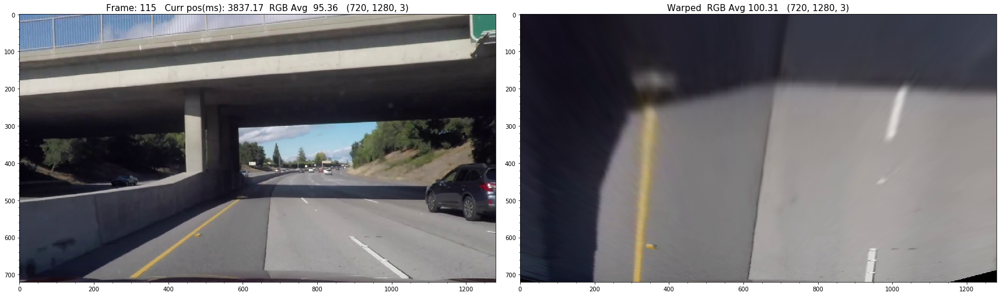

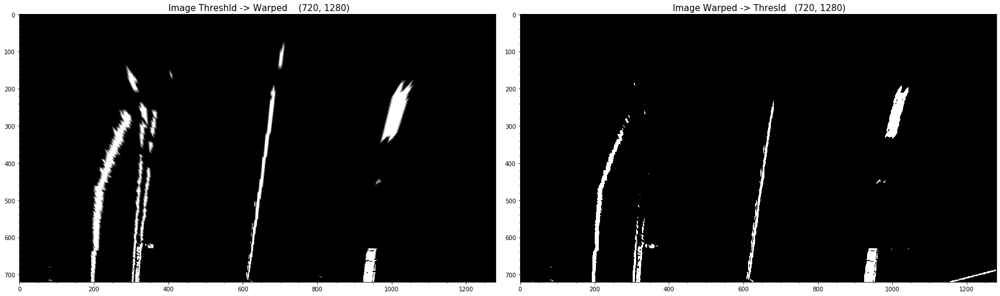

In [616]:
# display_two(image, imgUndist)
# display_two(imgGammaCorr, imgContrastAdj)
ttlT   = np.sum(imgThrshld)
ttlWT  = np.sum(imgWarpedThrshld)

ttlWTL = np.sum(output2['cmb_lvl'] )
ttlWTS = np.sum(output2['cmb_rgb_lvl_sat'])
ttlWTD = np.sum(output2['cmb_mag_x'])

# display_two(imgUndist,  imgThrshld, title2 =  'Image Thresholded '+str(ttlT))
display_two(imgWarped,  output2['cmb_lvl'] , 
            title1 = 'imgWarped : Image warped', 
            title2 = 'cmb_lvl  :  Warp -> Thrshld (Lvl)'+str(ttlWTL))
display_two(output2['cmb_rgb_lvl_sat'], output2['cmb_mag_x'],  
            title1 = 'cmb_rgb_lvl_sat  : Warp -> Thrshld (RGB,LVL,SAT)'+str(ttlWT), 
            title2 = 'cmb_mag_x : Warp -> Thrshld (MAG, X)'+str(ttlWTD))

print('='*100)
print(' RESULTS - ',frame_title)
print('='*100)      


display_two(imgUndist, imgWarped,  
            title1 = frame_title+'  RGB Avg {:6.2f}'.format(UndistRGBMean[-1]), title2 = 'Warped'+'  RGB Avg {:6.2f}'.format(WarpedRGBMean[-1]))
display_two(imgThrshldWarped, imgWarpedThrshld, title1 = ' Image Threshld -> Warped ', title2 = ' Image Warped -> Thresld')

In [576]:
# debug2 = True
# # try_image = imgGammaCorr
# try_image = imgContrastAdj
# print('='*100)
# print(' Apply thresholding BEFORE warping')
# print('='*100)      
# imgThrshld = apply_thresholds(try_image, ret = 'cmb_rgb_lvl_sat', ksize = ksize, debug = debug2,
#                                        x_thr = grad_x_thr, y_thr = grad_y_thr, mag_thr = mag_thr,  
#                                      dir_thr = dir_thr,  sat_thr = sat_thr,    
#                                      rgb_thr = rgb_thr,  lvl_thr = lvl_thr)

# imgThrshldWarped, M1, Minv1 = perspectiveTransform(imgThrshld, src_points, dst_points, debug = False)

# imgWarped, M2, Minv2 = perspectiveTransform(try_image, src_points, dst_points, debug = False)
# print('='*100)
# print(' Apply thresholding AFTER warping')
# print('='*100)      
# imgWarpedThrshld  = apply_thresholds(imgWarped, ret = 'cmb_rgb_lvl_sat', ksize = ksize_2, debug = debug2,
#                                               x_thr = grad_x_thr_2, y_thr = grad_y_thr_2, 
#                                             mag_thr = mag_thr_2, dir_thr = dir_thr_2, sat_thr = sat_thr_2, 
#                                             rgb_thr = rgb_thr_2, lvl_thr = lvl_thr_2 )

In [577]:
# firstFrame = False

# WINDOW_SEARCH_MARGIN = 60
# slidingWindowBootstrap = False
# firstFrame = True

In [617]:
# POLY_SEARCH_MARGIN  = 20
mode = 2
print(frame_title)    

### Select image we want to process further 
if mode == 1:
    working_image = imgThrshldWarped; sfx = '_thr_wrp'   ### Warped AFTER thresholding
    Minv = Minv_imgThrshld
else:
    working_image = imgWarpedThrshld; sfx = '_wrp_thr'   ### Warped BEFORE thresholding
    Minv =  Minv_imgUndist
    
print(' mode:', mode, 'suffix: ', sfx)

### On first frame use sliding window algorithm, On subsequent frames use search_around_poly() 
if slidingWindowBootstrap:
    rc, out_img, histogram  = search_around_poly(working_image, LeftLane, RightLane, search_margin = POLY_SEARCH_MARGIN, debug = True)
    out_img  = displayPolySearchRegion(out_img, LeftLane, RightLane, margin = POLY_SEARCH_MARGIN, debug = True)
else:    
    histRange = (camera_x - HISTOGRAM_SEARCH_MARGIN, camera_x + HISTOGRAM_SEARCH_MARGIN)
    
    rc, out_img, histogram = find_lane_pixels(working_image, LeftLane, RightLane, histRange, 
                                          nwindows = NWINDOWS, window_margin = WINDOW_SEARCH_MARGIN, debug = True) 
    slidingWindowBootstrap  = True

# out_img  = displayPolySearchRegion(out_img, LeftLane, RightLane, margin = POLY_SEARCH_MARGIN, debug = True)
print(' rc: ', rc)
if rc:
    LeftLane.fit_polynomial(debug = True)
    RightLane.fit_polynomial(debug = True)

Frame: 115   Curr pos(ms): 3837.17
 mode: 2 suffix:  _wrp_thr
 Run search_around_poly()
   Histogram Midpoint:  640 
   Histogram left side max: 209  right side max: 299
   Histogram left side max: 209  right side max: 939
 Search_around_poly() 
   fitted_x_left  :  (17337,)   fitted_x_right :  (17337,)
   left_lane_inds :  2068
   right_lane_inds:  5077
displayPolySearchRegion() 
  Search margin :  20
  left_fitx     :  (720,)   right_fitx    :  (720,)
  left_line_pts : (1, 1440, 2)   right_line_pts:  (1, 1440, 2)
 rc:  1

fit_polynomial:
--------------------
 New fitted polynomial  :  [   -0.0002     0.1677   286.2282]
 self.current_xfitted   :  (720,)


fit_polynomial:
--------------------
 New fitted polynomial  :  [    0.0002    -0.3337  1081.5164]
 self.current_xfitted   :  (720,)



Frame: 115   Curr pos(ms): 3837.17
----------------------------------------

Proposed Polynomial:
left      : [   -0.000184     0.167661   286.228211]    right     : [    0.000188    -0.333663  1081.516374] 

Current Best Fit Polynomial:
left      : [    0.000144    -0.284733   443.427556]    right     : [    0.000239    -0.373228  1079.264724] 

Previous Fitted Polynomials:
left      : [    0.000130    -0.253476   428.007671]    right     : [    0.000206    -0.349146  1080.193175] 
left      : [    0.000088    -0.216766   421.542017]    right     : [    0.000246    -0.379090  1082.645484] 
left      : [    0.000122    -0.269316   444.001534]    right     : [    0.000258    -0.384089  1077.008552] 
left      : [    0.000159    -0.305187   450.095835]    right     : [    0.000246    -0.378598  1080.287384] 
left      : [    0.000224    -0.378919   473.490724]    right     : [    0.000241    -0.375216  1076.189023] 

Diff beteween current and last accepted polynomial 
Difference: [    0.

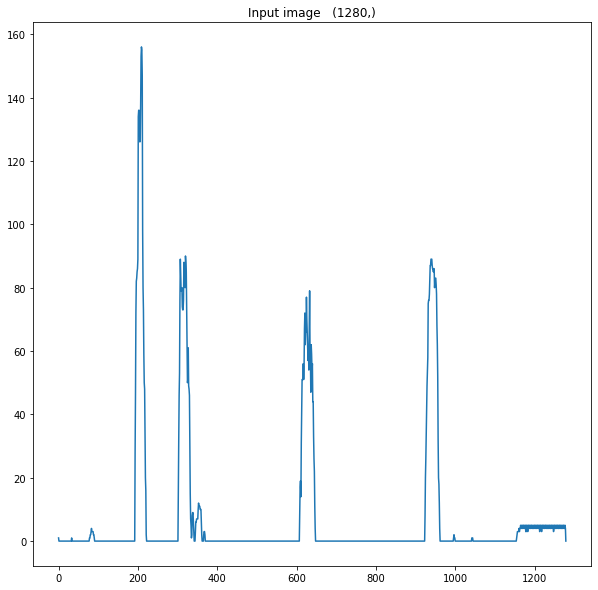

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


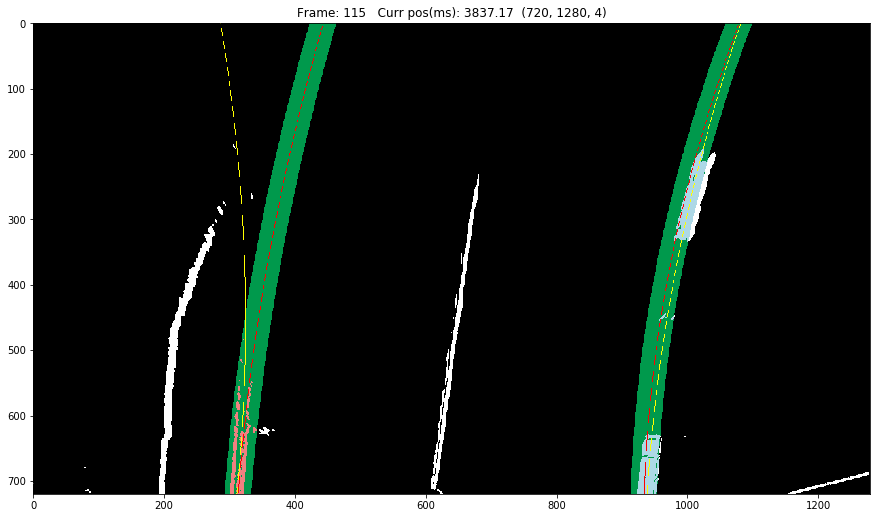

In [618]:
print(frame_title)
print('-'*40)
displayFittingInfo(LeftLane, RightLane)

display_one(histogram, size = 10)
dbg = colorLanePixels(out_img, LeftLane, RightLane)

# dbg = displayPolynomial(dbg, LeftLane.avg_xfitted, RightLane.avg_xfitted, color = 'black')
if not firstFrame:
    dbg = displayPolynomial(dbg, LeftLane.best_xfitted, RightLane.best_xfitted, color = 'red')
dbg = displayPolynomial(dbg, LeftLane.current_xfitted, RightLane.current_xfitted, iteration = -1, color = 'yellow', debug = True)
display_one(dbg, title = frame_title)

In [606]:
fitAccepted = True

In [607]:
print(frame_title)
if firstFrame or fitAccepted:
    LeftLane.acceptFittedPolynomial(debug = True)
    RightLane.acceptFittedPolynomial(debug = True)
    firstFrame = False
else:
    LeftLane.rejectFittedPolynomial(debug = True)
    RightLane.rejectFittedPolynomial(debug = True)
    print(LeftLane.detected, RightLane.detected)
    print(LeftLane.framesSinceDetected, RightLane.framesSinceDetected)



Frame: 114   Curr pos(ms): 3803.8

acceptFittedLine():
--------------------
 start fit hist length  :  4   best_fit_history length   :  4
 previous fit           :  [    0.0001    -0.2168   421.5420]
 current polyfit        :  [    0.0001    -0.2535   428.0077]
 current best_fit       :  [    0.0001    -0.2925   447.2825]
 Fit  RSE(current, prev):     22.460   prev avg_RSE:    167.660    fit_avg_RSE:     131.360 
 Best RSE(current, best):      8.580   prev avg_RSE:    163.707    best_avg_RSE:    124.925 
 set_fit()
   Previous fit       :  [    0.0001    -0.2168   421.5420]
   New/Accepted       :  [    0.0001    -0.2535   428.0077]
   fit Diff           :  [    0.0000    -0.0367     6.4657]
   fit history length :  5  fit_diffs_history length   :  5
   fit RSE(current,prev) :  6.466    fit_avg_RSE:  131.36  new fit_avg RSE: 106.381
 set_best_fit()
   Previous best fit      :  [    0.0001    -0.2925   447.2825]
   New best fit           :  [    0.0001    -0.2847   443.4276]    [    0.0

In [608]:
if not(LeftLane.detected and RightLane.detected) and (LeftLane.framesSinceDetected > 8 or RightLane.framesSinceDetected > 8):
    print(' No detection and many non-detected frames')
    missingSequence = True
    polyRegionColor1 = 'red'
    polyRegionColor2 = 'red'
else:
    print(' Good detection or less than 8 no-detection frames ')
    missingSequence = True
    polyRegionColor1 = 'green'
    polyRegionColor2 = 'yellow'


 Good detection or less than 8 no-detection frames 


In [609]:
# print(LeftLane.current_xfitted[700:705], '   ', RightLane.current_xfitted[700:705])
# print(LeftLane.best_xfitted[700:705], '   ', RightLane.best_xfitted[700:705])
print()
print(' Curvature using current fit:')
LeftLane.get_curvature(curvature_y_eval, LeftLane.current_fit, debug = True)
RightLane.get_curvature(curvature_y_eval, RightLane.current_fit, debug = True)
print(' Curvature using best fit:')
LeftLane.get_curvature(curvature_y_eval, LeftLane.best_fit, debug = True)
RightLane.get_curvature(curvature_y_eval, RightLane.best_fit, debug = True)
print()
print(' Line base pos using current xfitted:')
LeftLane.get_line_base_pos(offCenter_y_eval,  LeftLane.current_xfitted, debug = True)    
RightLane.get_line_base_pos(offCenter_y_eval, RightLane.current_xfitted, debug = True)
print(' Line base pos using best xfitted:')
LeftLane.get_line_base_pos(offCenter_y_eval , LeftLane.best_xfitted, debug = True)    
RightLane.get_line_base_pos(offCenter_y_eval, RightLane.best_xfitted, debug = True)
# print()
# print(LeftLane.line_base_pixels[-1], RightLane.line_base_pixels[-1], RightLane.line_base_pixels[-1] - LeftLane.line_base_pixels[-1])
# print(LeftLane.line_base_meters[-1], RightLane.line_base_meters[-1], RightLane.line_base_meters[-1] - LeftLane.line_base_meters[-1])
print() 
curv_msg = curvatureMsg(LeftLane, RightLane, debug = False)
oc_msg = offCenterMsg(LeftLane, RightLane, camera_x, debug = False)
print(curv_msg, ' Off center message: ' ,oc_msg)

# curv_msg = curvatureMsg(LeftLane, RightLane, debug = False)
# oc_msg = offCenterMsg(LeftLane, RightLane, camera_x, debug = False)
# print(curv_msg, ' Off center message: ' ,oc_msg)
print()
print(' Current fit  - L: ', LeftLane.current_fit, '  R: ', RightLane.current_fit)
print(' Best fit     - L: ', LeftLane.best_fit,    '  R: ', RightLane.best_fit)


 Curvature using current fit:
 get_curvature():  1117.159029482251  (m)
 get_curvature():  703.3136867186969  (m)
 Curvature using best fit:
 get_curvature():  1002.593159557239  (m)
 get_curvature():  605.3409013045413  (m)

 Line base pos using current xfitted:
 get_line_base_pos():  y_eval: 700 current_xfitted[y_eval]: 314.075603279744    MX: 0.005996758508914101    lb_meters: 1.883 
 get_line_base_pos():  y_eval: 700 current_xfitted[y_eval]: 936.65285443282    MX: 0.005996758508914101    lb_meters: 5.617 
 Line base pos using best xfitted:
 get_line_base_pos():  y_eval: 700 current_xfitted[y_eval]: 314.87557286552396    MX: 0.005996758508914101    lb_meters: 1.888 
 get_line_base_pos():  y_eval: 700 current_xfitted[y_eval]: 935.183435034692    MX: 0.005996758508914101    lb_meters: 5.608 

Curvature  L: 1002 m   R: 605 m   Off center message:  0.09 m right of lane center

 Current fit  - L:  [    0.0001    -0.2535   428.0077]   R:  [    0.0002    -0.3491  1080.1932]
 Best fit     

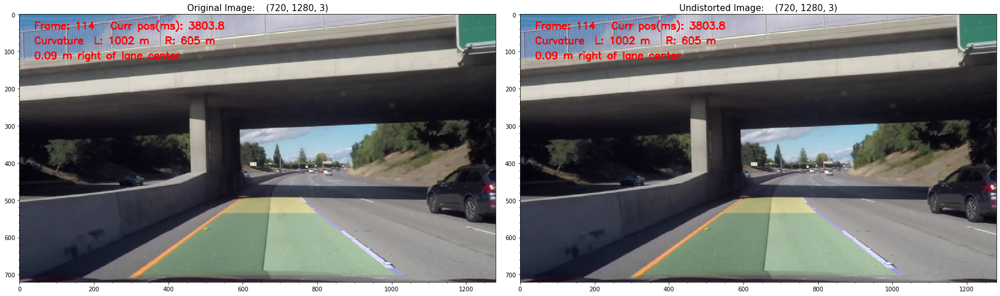

In [610]:
# start_pos = int(15 / LeftLane.MY)
start_pos = LeftLane.y_src_top
result_1 = displayLaneRegion(imgUndist, LeftLane.current_xfitted, RightLane.current_xfitted, Minv, start=start_pos, beta = 0.2, color = polyRegionColor1)
result_1 = displayLaneRegion(result_1 , LeftLane.current_xfitted, RightLane.current_xfitted, Minv, start=200,end=start_pos,beta = 0.2, color = polyRegionColor2)
_= displayText(result_1,  40,40, frame_title, fontHeight = 20)
_= displayText(result_1,  40,80, curv_msg, fontHeight = 20)
_= displayText(result_1, 40,120, oc_msg  , fontHeight = 20)
# displayGuidelines(result_1, draw = 'y');


result_2 = displayLaneRegion(imgUndist, LeftLane.best_xfitted, RightLane.best_xfitted, Minv, start=start_pos, beta = 0.2, color = polyRegionColor1)
result_2 = displayLaneRegion(result_2 , LeftLane.best_xfitted, RightLane.best_xfitted, Minv, start = 200, end=start_pos,beta = 0.2 , color = polyRegionColor2)
_=displayText(result_2, 40,40, frame_title, fontHeight = 20)
_=displayText(result_2, 40,80 , curv_msg, fontHeight = 20)
_=displayText(result_2, 40,120 , oc_msg  , fontHeight = 20)
# displayGuidelines(result_2, draw = 'y');

display_two(result_1, result_2)

 Left lane MR fit      :  [    0.0001    -0.2535   428.0077]     Right lane MR fit     :  [    0.0002    -0.3491  1080.1932]
 Left lane MR best fit :  [    0.0001    -0.2847   443.4276]     Right lane MR best fit:  [    0.0002    -0.3732  1079.2647]
 Left Curvature @ y =  10   : 1119.16 m   Right Curvature   : 705.84 m
 Left Curvature @ y = 700   : 1117.16 m   Right Curvature   : 703.31 m
 Curvature message :  Curvature  L: 1002 m   R: 605 m 
 Off Center Message:  0.09 m right of lane center


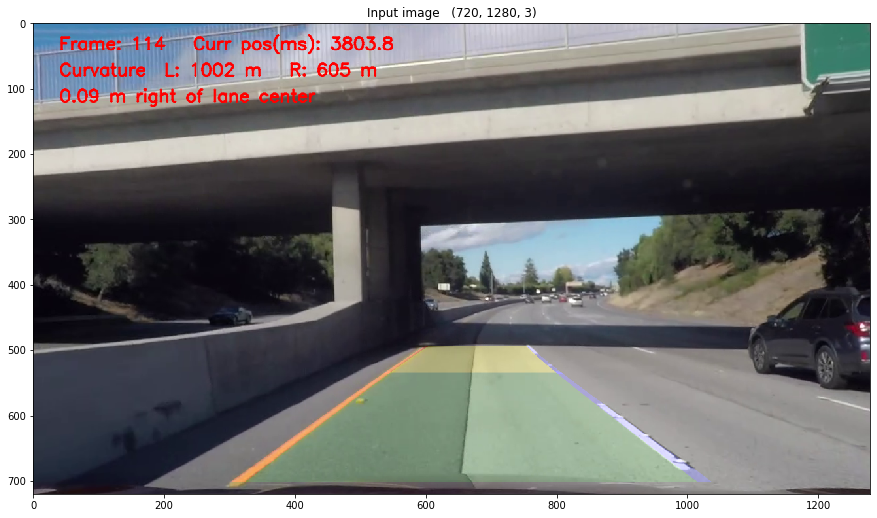

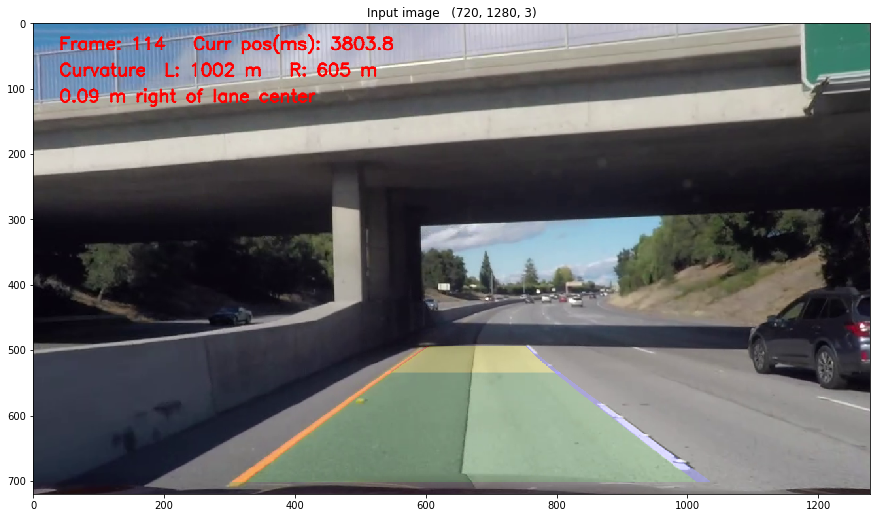

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


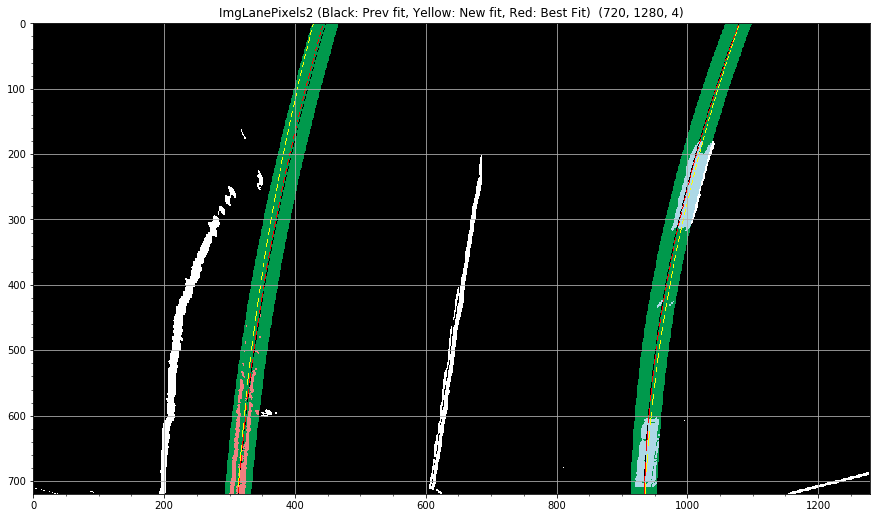

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


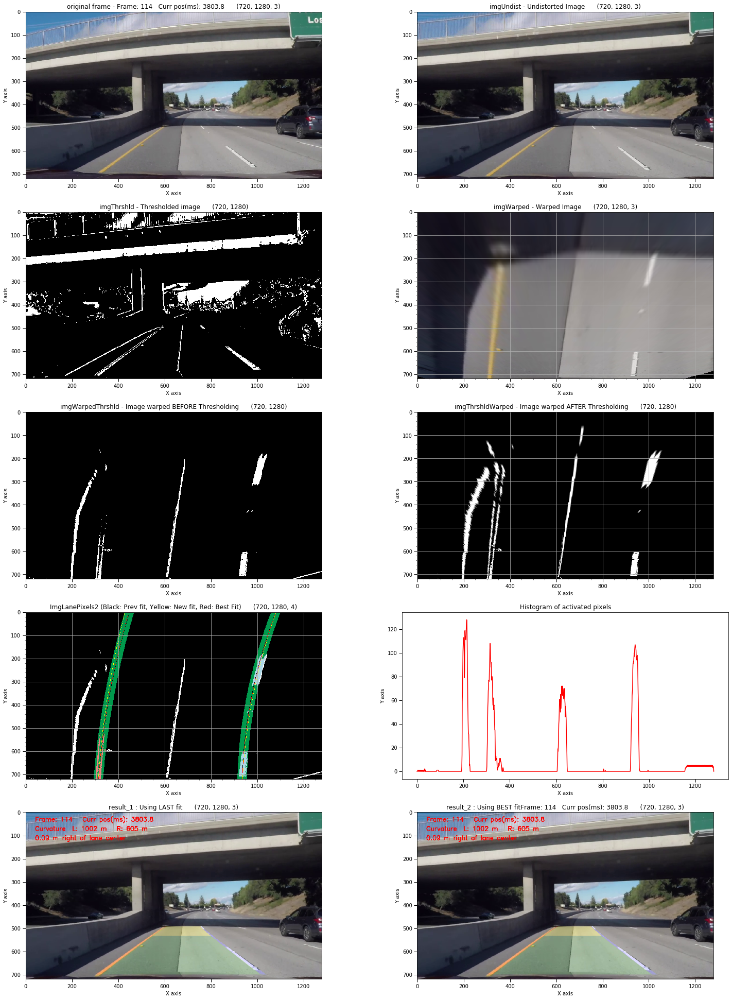

<Figure size 1800x4032 with 0 Axes>

In [611]:
print(' Left lane MR fit      : ', LeftLane.current_fit , '    Right lane MR fit     : ', RightLane.current_fit)
print(' Left lane MR best fit : ', LeftLane.best_fit    , '    Right lane MR best fit: ', RightLane.best_fit)
print(' Left Curvature @ y =  10   : '+str(LeftLane.get_curvature(10))+" m   Right Curvature   : "+str(RightLane.get_curvature(10))+" m")
print(' Left Curvature @ y = 700   : '+str(LeftLane.get_curvature(700))+" m   Right Curvature   : "+str(RightLane.get_curvature(700))+" m")
print(' Curvature message : ', curv_msg)
print(' Off Center Message: ', oc_msg)
imgLanePixels2 = colorLanePixels(out_img, LeftLane, RightLane)
imgLanePixels2 = displayPolynomial(imgLanePixels2, LeftLane.best_xfitted_history, RightLane.best_xfitted_history, iteration = -2, color = 'black')
imgLanePixels2 = displayPolynomial(imgLanePixels2, LeftLane.best_xfitted, RightLane.best_xfitted, color = 'red')
imgLanePixels2 = displayPolynomial(imgLanePixels2, LeftLane.current_xfitted, RightLane.current_xfitted, iteration = -1, color = 'yellow', debug = True)
size = 15
display_one(result_1, size = size)
display_one(result_2, size = size)
display_one(imgLanePixels2, size = size,title= 'ImgLanePixels2 (Black: Prev fit, Yellow: New fit, Red: Best Fit)', grid = 'major' );

disp  = PlotDisplay(8,2)
disp.addPlot(image           , title = 'original frame - '+frame_title);
disp.addPlot(imgUndist       , title = 'imgUndist - Undistorted Image');
disp.addPlot(imgThrshld      , title = 'imgThrshld - Thresholded image');
disp.addPlot(imgWarped       , title = 'imgWarped - Warped Image',grid = 'major');
disp.addPlot(imgWarpedThrshld, title = 'imgWarpedThrshld - Image warped BEFORE Thresholding');
disp.addPlot(imgThrshldWarped, title = 'imgThrshldWarped - Image warped AFTER Thresholding', grid= 'major');
# disp.addPlot(out_img          , title = 'out_img')
# disp.addPlot(imgLanePixels   , title = 'ImgLanePixels: Warped image Lane Pixels')
disp.addPlot(imgLanePixels2  , title = 'ImgLanePixels2 (Black: Prev fit, Yellow: New fit, Red: Best Fit)', grid = 'major' );
disp.addPlot(histogram       , title = 'Histogram of activated pixels', type = 'plot' );
disp.addPlot(result_1        , title = 'result_1 : Using LAST fit');
disp.addPlot(result_2        , title = 'result_2 : Using BEST fit'+frame_title);
disp.closePlot()

###  Display outputs

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


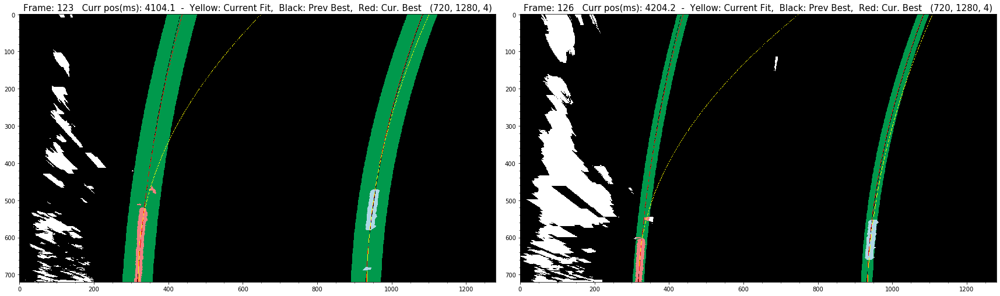

In [531]:
prev_ttl = prev_frame_title+ '  -  Yellow: Current Fit,  Black: Prev Best,  Red: Cur. Best'
ttl = frame_title+ '  -  Yellow: Current Fit,  Black: Prev Best,  Red: Cur. Best'
display_two(prev_imgLanePixels2, imgLanePixels2,title1 = prev_ttl, title2=ttl)

# ttl =  frame_title+ '  -  Yellow: Current Fit,  Black: Prev Best,  Red: Cur. Best'
# display_one(imgLanePixels2, title = ttl, winttl = frame_title, grid = 'major', size = 15)
prev_imgLanePixels2 = imgLanePixels2
prev_frame_title = frame_title

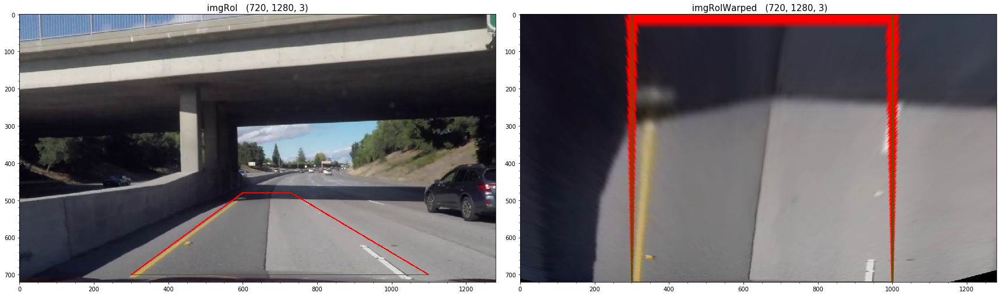

In [383]:
size = 10
# display_two(imgUndist  , imgGammaCorr , title1 = 'imgUndist', title2 = ' imgGammaCorr', winttl = frame_title)
# display_two(imgUndist  , imgContrastAdj, title1 = 'imgUndist', title2 = ' imgContrastAdj'    , winttl = frame_title)
display_two(imgRoI     , imgRoIWarped , title1 = 'imgRoI'   , title2 = ' imgRoIWarped' , winttl = frame_title)

In [348]:
print(' Left current fit: ', LeftLane.current_fit)
print(' Left best fit   : ', LeftLane.best_fit)
print(' LL bestRSE hist : ',LeftLane.best_RSE_history)
print(' Sum: ', np.sum(LeftLane.best_RSE_history), 'Llane avg: ', LeftLane.avg_RSE , ' Last avg RSE:', LeftLane.prev_avg_RSE)
print(' Llane last: ', round(LeftLane.best_RSE,3))
print()
print()
# print(RightLane.best_fit_history)
print(' Right current fit: ', RightLane.current_fit)
print(' Right best fit   : ', RightLane.best_fit)
print(' RL bestRSE hist  : ',RightLane.best_RSE_history)
print(' Sum: {}  Rlane avg: {}  RLane prev avg:  {} Rlane last: {}'.format(np.sum(RightLane.best_RSE_history),RightLane.avg_RSE,
                                                                             RightLane.prev_avg_RSE, RightLane.best_RSE))


 Left current fit:  [ 5.53603901e-05 -1.48308033e-01  3.95219801e+02]
 Left best fit   :  [ 6.38466102e-05 -1.56301845e-01  3.96997508e+02]
 LL bestRSE hist :  deque([62.99, 68.634, 56.38, 10.32, 1.667, 66.643, 89.784, 0.0], maxlen=8)
 Sum:  356.418 Llane avg:  44.552  Last avg RSE: 51.222
 Llane last:  0.0


 Right current fit:  [ 3.21633766e-04 -4.61125597e-01  1.09954086e+03]
 Right best fit   :  [ 2.75971283e-04 -4.15703160e-01  1.09277165e+03]
 RL bestRSE hist  :  deque([11.45, 10.018, 14.405, 6.936, 10.01, 7.001, 6.198, 8.892], maxlen=8)
 Sum: 74.91  Rlane avg: 40.0  RLane prev avg:  40.0 Rlane last: 8.892


In [113]:
from common.utils import *

In [387]:
print()
print(' Fit Polynomial Coeffs  ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.fit_history),reversed(RightLane.fit_history)):
    print('L: {}   R: {} '.format(i,j))

print()
print(' Current Fit ', '\n'+'-'*30)
print('L: {}   R: {} '.format(LeftLane.current_fit ,RightLane.current_fit))    

print()
print(' Diffs ', '\n'+'-'*30)
avg_i = 0; avg_j = 0
for i,j in zip(reversed(LeftLane.diffs_history),reversed(RightLane.diffs_history)):
    avg_i += np.sqrt(np.sum(i**2))
    avg_j += np.sqrt(np.sum(j**2))
    print('L: {}     {:8.2f}      R: {}       {:8.2f}    '.format(i,np.sqrt(np.sum(i**2)), j,np.sqrt(np.sum(j**2))))
    
print('Average             {:8.2f}                       {:8.2f}    '.format(avg_i/len(LeftLane.diffs_history) , avg_j/len(RightLane.diffs_history)))

print()
print(' Best Fit ', '\n'+'-'*30)
print('L: {}   R: {} '.format(LeftLane.best_fit ,RightLane.best_fit))  

print()
print(' Best Fit History ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.best_fit_history),reversed(RightLane.best_fit_history)):
    print('L: {}   R: {} '.format(i ,j))    

print()
print(' Best RSE History ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.best_RSE_history),reversed(RightLane.best_RSE_history)):
    print('L: {:8.3f}   R: {:8.3f} '.format(i ,j))   
    
print()
avg_i = 0; avg_j = 0
print(' Best Diffs History ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.best_diffs_history),reversed(RightLane.best_diffs_history)):
    avg_i += np.sqrt(np.sum(i**2))
    avg_j += np.sqrt(np.sum(j**2))
    print('L: {}     {:8.2f}      R: {}       {:8.2f}    '.format(i,np.sqrt(np.sum(i**2)), j,np.sqrt(np.sum(j**2))))
         
print()
print(' Average Best Diffs ', '\n'+'-'*30)    
print('L: {:8.2f}   R: {:8.2f} '.format(avg_i / len(LeftLane.best_diffs_history),avg_j / len(RightLane.best_diffs_history)))



print()
print(' Slope ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.slope),reversed(RightLane.slope)):
    print('L: {:8.2f}   R: {:8.2f} '.format(i,j))
    
    
print()
avg_diff = 0
print(' radius of curvature ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.radius_of_curvature),reversed(RightLane.radius_of_curvature)):
    avg_diff += (i-j)
    print('L: {:8.2f}   R: {:8.2f}   diff: {:8.2f}'.format(i,j, i-j))

    
print()
print(' Average radius of curvature ', '\n'+'-'*30)    
print('L: {:8.2f}   R: {:8.2f}    Diff: {:8.2f} '.format(np.mean(LeftLane.radius_of_curvature), np.mean(RightLane.radius_of_curvature), avg_diff/len(LeftLane.radius_of_curvature)))

print()
print(' line_base_meters ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.line_base_meters),reversed(RightLane.line_base_meters)):
    print('L: {:8.2}   R: {:8.2f}   width : {:8.2f} '.format( i,  j,  round(j - i,2)))    
    
    
    
print()
sum_i = 0; sum_j = 0
print(' history_xfitted @ Y = 700', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.xfitted_history),reversed(RightLane.xfitted_history)):
    sum_i += i[700]
    sum_j += j[700]
    print('L: {:8.2f}   R: {:8.2f}     Width: {:8.2f}'.format( i[700],  j[700], j[700]-i[700]))    

print()
print(' Average history_xfitted @ Y = 700 ', '\n'+'-'*30)    
print('L: {:8.2f}   R: {:8.2f}     Width: {:8.2f}'.format(sum_i/len(LeftLane.xfitted_history), sum_j /len(RightLane.xfitted_history),
                                                           (sum_j - sum_i) / len(LeftLane.xfitted_history)))



print('\n')
print(' history_xfitted ', '\n'+'-'*30)
for i,j in zip(reversed(LeftLane.xfitted_history),reversed(RightLane.xfitted_history)):
    print('L: {}   R: {}'.format( i[:5],  j[:5]))
print()
print(' current_xfitted ', '\n'+'-'*30)
print('L: {}   R: {}    '.format( LeftLane.current_xfitted[:5],  RightLane.current_xfitted[:5]))       



 Fit Polynomial Coeffs   
------------------------------
L: [ 1.92979470e-04 -3.65470094e-01  4.78898823e+02]   R: [ 3.92808214e-04 -5.80369479e-01  1.14955348e+03] 
L: [ 8.72606254e-05 -1.84907703e-01  4.06271886e+02]   R: [ 4.10124510e-04 -5.90866445e-01  1.14833797e+03] 
L: [ 7.25359466e-05 -1.66978721e-01  4.00545423e+02]   R: [ 3.12816580e-04 -4.63206662e-01  1.10360697e+03] 
L: [ 6.38466102e-05 -1.56301845e-01  3.96997508e+02]   R: [ 3.07033235e-04 -4.54058014e-01  1.10159552e+03] 
L: [ 5.53603901e-05 -1.48308033e-01  3.95219801e+02]   R: [ 3.21633766e-04 -4.61125597e-01  1.09954086e+03] 
L: [ 2.72254215e-04 -4.11331781e-01  4.74318920e+02]   R: [ 3.11862931e-04 -4.45695463e-01  1.09491197e+03] 
L: [ 1.92177729e-04 -3.18451445e-01  4.49323610e+02]   R: [ 3.18231374e-04 -4.46404006e-01  1.09264633e+03] 
L: [ 2.00184395e-05 -1.15036966e-01  3.90005336e+02]   R: [ 3.22642849e-04 -4.47030569e-01  1.09351679e+03] 

 Current Fit  
------------------------------
L: [-8.25597216e-04  9.

In [27]:
# display_one(result_1)
# display_one(result_2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


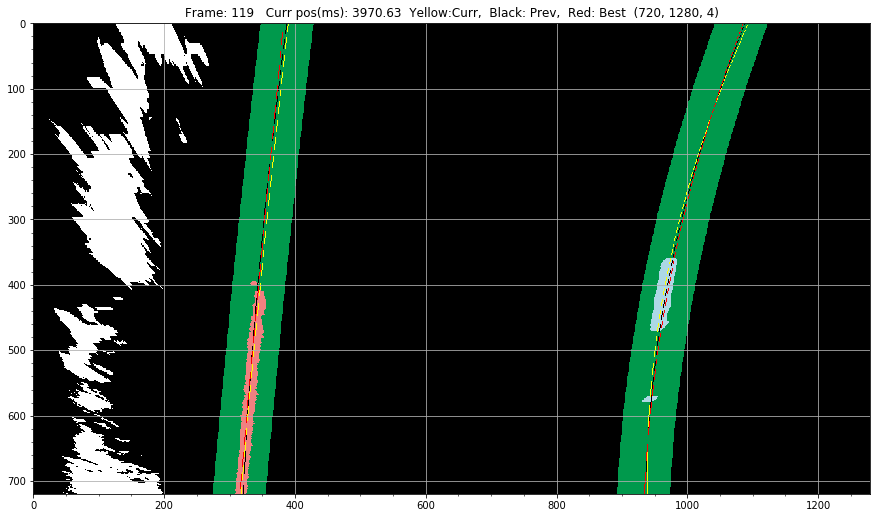

In [328]:
display_one(imgLanePixels2, title = frame_title+ '  Yellow:Curr,  Black: Prev,  Red: Best', winttl = frame_title, grid = 'major', size = 15)

In [29]:
# display_one(imgLanePixels2, title = frame_title+ '  Yellow:Curr,  Black: Prev,  Red: Best', winttl = frame_title, grid = 'major', size = 15)

In [192]:
a = LeftLane.fit_history

print(' Length of LeftLane.fit_history: ', len(a))
print()
for i in reversed(a):
    print(i)
print()
print(' Current fit : ', LeftLane.current_fit)   
print(' Previous fit: ', LeftLane.fit_history[-1])
print(' Diffs       : ', LeftLane.diffs)    
print()
print(' Best fit    : ', LeftLane.best_fit)

 Length of LeftLane.fit_history:  4

[ 1.27594426e-04 -2.78578493e-01  4.51847330e+02]
[ 3.87872785e-05 -2.14470566e-01  4.49909830e+02]
[ 1.58267933e-05 -2.04547206e-01  4.53110015e+02]
[ 1.16347053e-04 -3.42944269e-01  5.00570693e+02]

 Current fit :  [ 1.27594426e-04 -2.78578493e-01  4.51847330e+02]
 Previous fit:  [ 1.27594426e-04 -2.78578493e-01  4.51847330e+02]
 Diffs       :  [ 8.88071478e-05 -6.41079263e-02  1.93750082e+00]

 Best fit    :  [ 7.46388878e-05 -2.60135134e-01  4.63859467e+02]


In [195]:
A, Acov = np.polyfit(LeftLane.ally, LeftLane.allx, 2 , cov = True)
R, Rcov = np.polyfit(RightLane.ally, RightLane.allx, 2 , cov = True)

print(A,  np.sqrt(np.diag(Acov)))
print()
print(R, np.sqrt(np.diag(Rcov)))
print()


In [229]:
# save_video_output_frame(result_3, currFrame, outputPath, videoFile)

In [118]:
# display_two(image, imgUndist, title1 = 'Input Image ', title2 = ' Undistorted Image') 
# display_two(image, imgRoI, title2 = ' Image with RoI overlay')
# display_two(imgRoI, imgMaskedDbg, title2 = ' Image RoI')
# display_two(imgMaskedDbg  , imgMaskedWarpedDbg, title1 = 'imgMaskedDebug',title2 = ' imgMaskedWarpedDebug')

# display_two(imgWarpedDebug, imgWarpedDebug_wRoILines, title1 = 'imgWarpedDebug',title2 = ' imgWarpedDebug w RoI Lines')
# display_two(imgWarped, imgWarped_wRoILines, title1 = 'imgWarped',title2 = ' imgWarped w RoI Lines')

### Curvature calculations 

In [308]:
print("  {:8s}  {:8s}   {:8s}   {:8s}      {:8s}   {:8s}  {:8s} ".format(" y eval" ,"avg pxl", "left_pxl" , "right_pxl", "avg mtr","left_mtr", "right_mtr"))
print('-'*80)
for y_eval in range(20,730,50):
    _, curv_avg_pxl, curv_left_pxl, curv_right_pxl = measure_curvature(y_eval, LeftLane.best_fit, RightLane.best_fit, 'p')
    _, curv_avg_mtr, curv_left_mtr, curv_right_mtr = measure_curvature(y_eval, LeftLane.best_fit, RightLane.best_fit, 'm')
    print(" {:8.0f}   {:8.2f}   {:8.2f}   {:8.2f}      {:8.2f}   {:8.2f}   {:8.2f} ".format(y_eval, 
                                                                                            curv_avg_pxl, curv_left_pxl, curv_right_pxl, 
                                                                                            curv_avg_mtr, curv_left_mtr, curv_right_mtr))
y_eval = 700
_, curv_avg_pxl, curv_left_pxl, curv_right_pxl = measure_curvature(y_eval, LeftLane.best_fit, RightLane.best_fit, 'p')
_, curv_avg_mtr, curv_left_mtr, curv_right_mtr = measure_curvature(y_eval, LeftLane.best_fit, RightLane.best_fit, 'm')
print(" {:8.0f}   {:8.2f}   {:8.2f}   {:8.2f}      {:8.2f}   {:8.2f}   {:8.2f} ".format(y_eval, 
                                                                                        curv_avg_pxl, curv_left_pxl, curv_right_pxl, 
                                                                                        curv_avg_mtr, curv_left_mtr, curv_right_mtr))    

   y eval   avg pxl    left_pxl   right_pxl      avg mtr    left_mtr  right_mtr 
--------------------------------------------------------------------------------
       20    8701.58   14498.91    2904.25       2713.03    4625.79     800.27 
       70    8699.96   14498.02    2901.89       2712.84    4625.68     800.00 
      120    8698.34   14497.14    2899.54       2712.66    4625.58     799.75 
      170    8696.73   14496.25    2897.20       2712.49    4625.47     799.51 
      220    8695.11   14495.36    2894.87       2712.33    4625.37     799.29 
      270    8693.51   14494.48    2892.54       2712.18    4625.27     799.09 
      320    8691.90   14493.59    2890.21       2712.04    4625.18     798.90 
      370    8690.30   14492.71    2887.90       2711.91    4625.09     798.73 
      420    8688.70   14491.82    2885.58       2711.79    4625.00     798.58 
      470    8687.11   14490.94    2883.28       2711.68    4624.91     798.44 
      520    8685.52   14490.06    288

In [408]:
from collections import deque
import itertools
del moving_average
def moving_average(iterable, n=3):
    # moving_average([40, 30, 50, 46, 39, 44]) --> 40.0 42.0 45.0 43.0
    # http://en.wikipedia.org/wiki/Moving_average
    it = iter(iterable)
    print(' it is ', it)
    print(' islice: ', itertools.islice(it, n-1))
    d = deque(itertools.islice(it, n-1))
    print(' d is : ', d)
    d.appendleft(0)
    print(' d is : ', d)
    s = sum(d)
    print(' s  :', s)
    for elem in it:
        
        k = d.popleft()
        print('elem is : ', elem, ' k is : ', k)
        s += elem - k
        d.append(elem)
        print(' d is now: ', d)
        yield s / n

## Gamma Correction

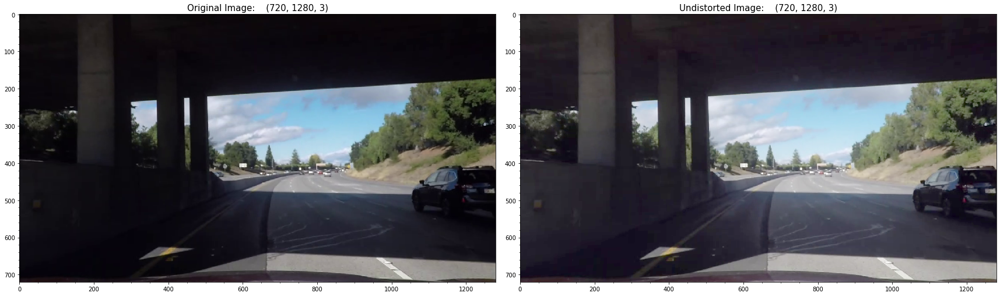

In [79]:
# display_one(imgUndist)
imgCorrected = adjust_gamma(imgUndist, gamma = 1.5)
display_two(imgUndist, imgCorrected)

## Gradient Thresholding

In [34]:
from common.sobel import *

In [107]:
## Combine multiple functions
# image_id = 6
# image = mpimg.imread(sampleImages[image_id])
# print(sampleImages[image_id])

# ksize      = 7
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# dir_thr    = (40,65)
# sat_thr    = (130,255)

ksize      = 5
grad_x_thr = (30,110)
grad_y_thr = (30,110)
mag_thr    = (65,255)
dir_thr    = (40,65)
sat_thr    = (90,255)

ksize      = 7
grad_x_thr = (30,255)
grad_y_thr = (70,255)
mag_thr    = (35,255)
dir_thr    = (40,65)
# sat_thr    = (65,255)
sat_thr    = (100,255)
lvl_thr    = (180, 255)
rgb_thr    = (190,255)

In [357]:
#--adjusted for challenge video -------------=
ksize      = 7
grad_x_thr = (30,255)
grad_y_thr = (70,255)
mag_thr    = (35,255)
dir_thr    = (40,65)
# sat_thr    = (65,255)
sat_thr    = (100,255)
lvl_thr    = (180, 255)
rgb_thr    = (180,255)
rgb_or_thr = (180,255)

# display_one(img_to_process)

E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines


### Gradient X Thresholding

In [19]:
from common.sobel import *

grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  236


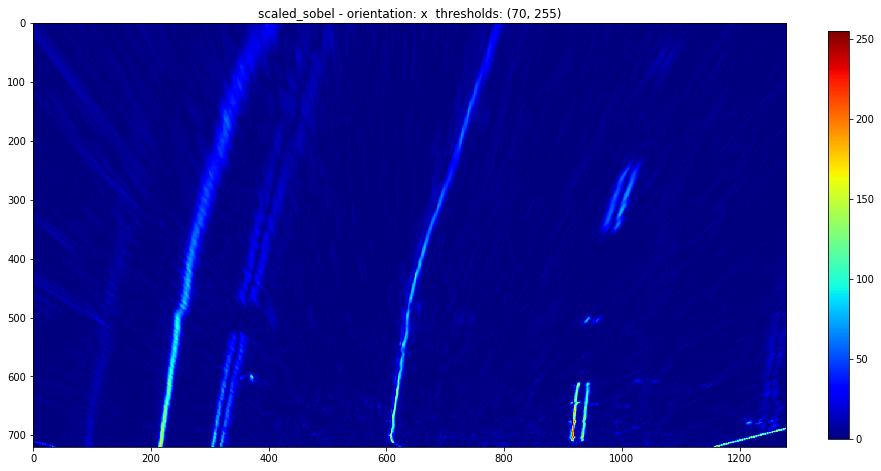

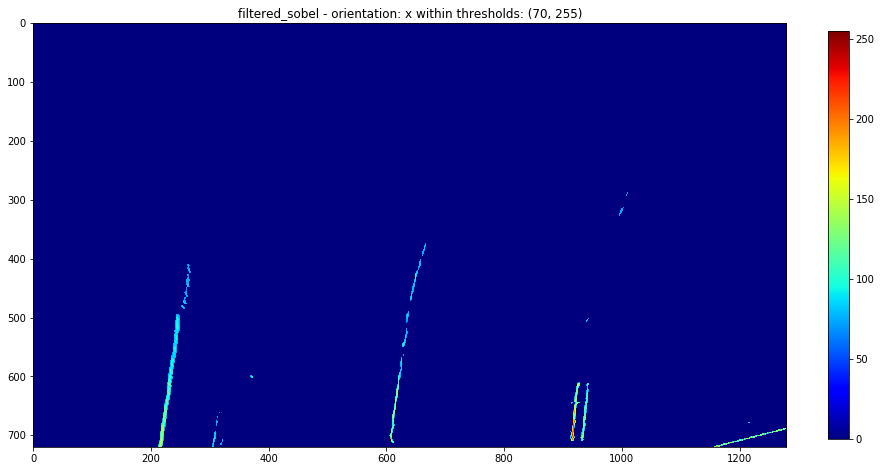

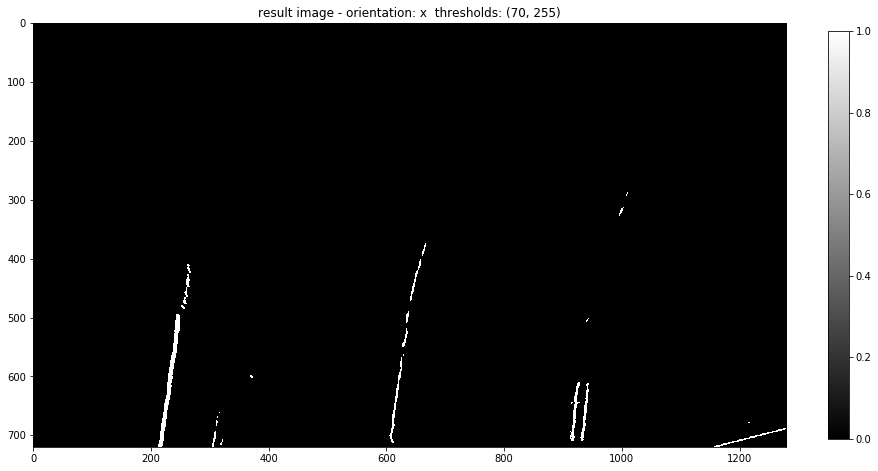

In [355]:
img_to_process = videoPipeline.imgWarped
test_ksize = 7
test_x_thr = (70,255)
# Apply each of the thresholding functions
x_binary   = grad_abs_thresh(img_to_process, orient='x', sobel_kernel=test_ksize, thresh=test_x_thr, display = True)

### Gradient Y Thresholding

grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  236


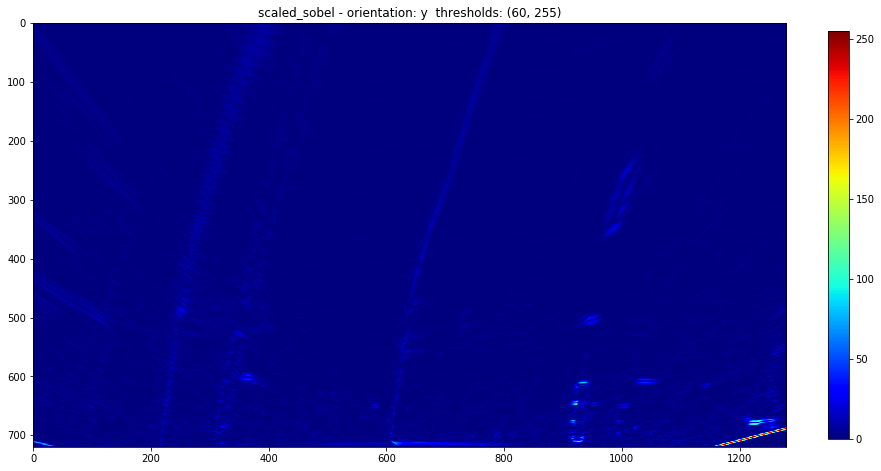

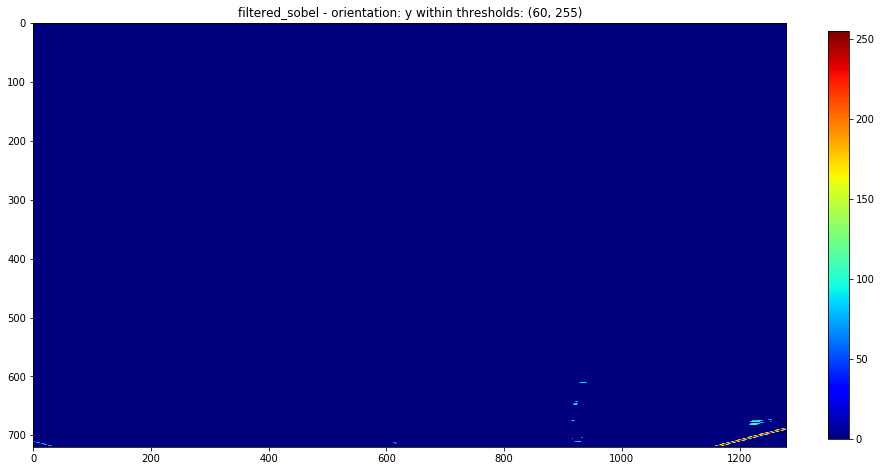

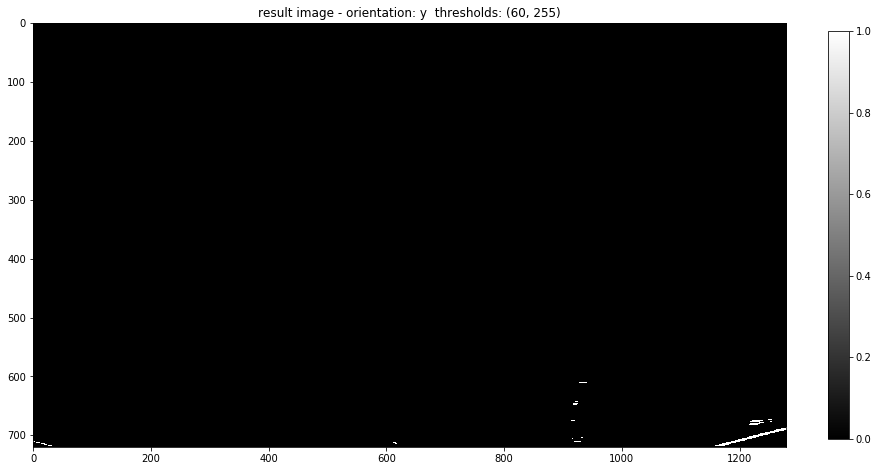

In [21]:
ksize = 7
test_y_thr = (60,255)
# Apply each of the thresholding functions
y_binary   = grad_abs_thresh(img_to_process, orient='y', sobel_kernel=ksize, thresh=test_y_thr, display = True)

### Gradient Directional Thresholding

grad_dir: (720, 1280)  Deg:  (0, 30) Rad: (0.0, 0.5235987755982988)


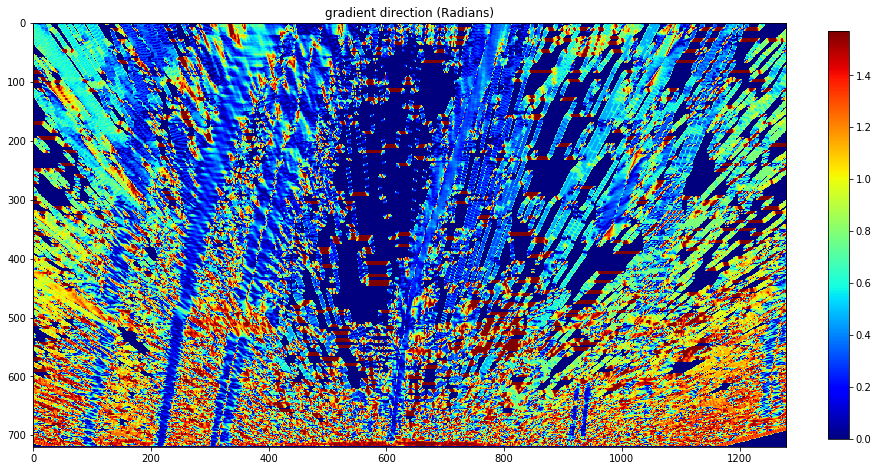

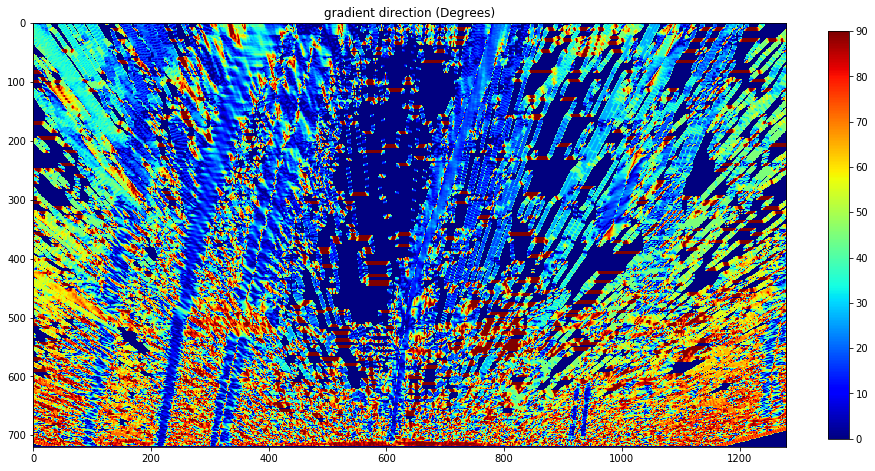

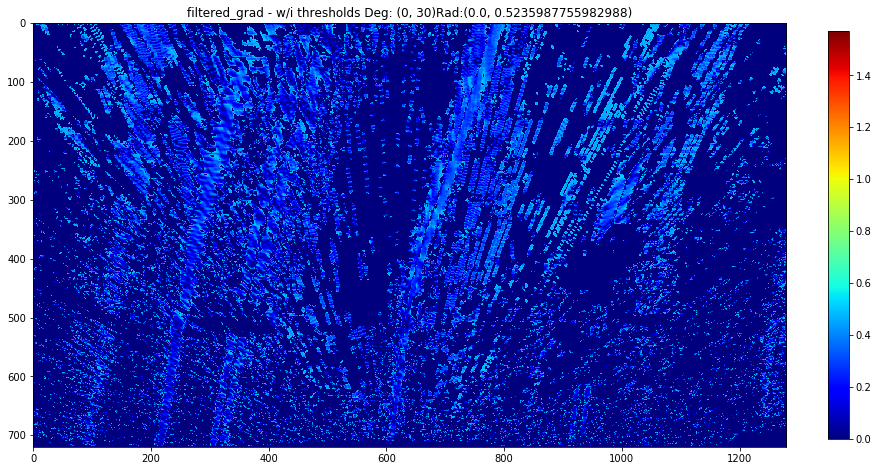

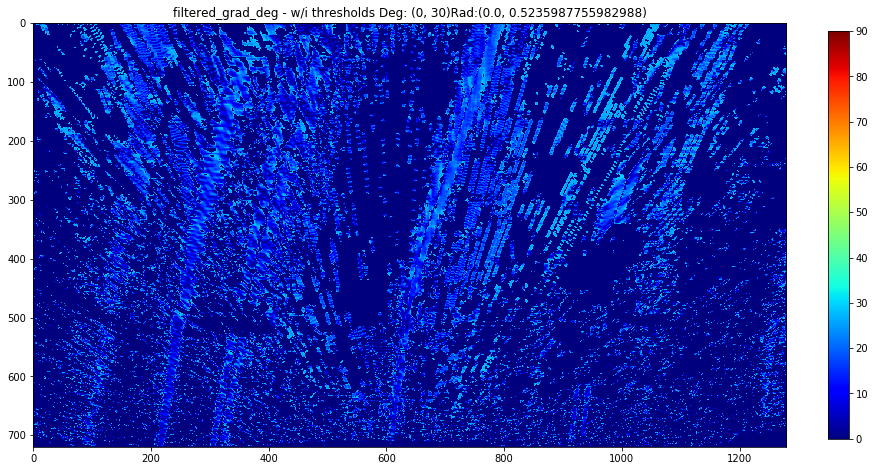

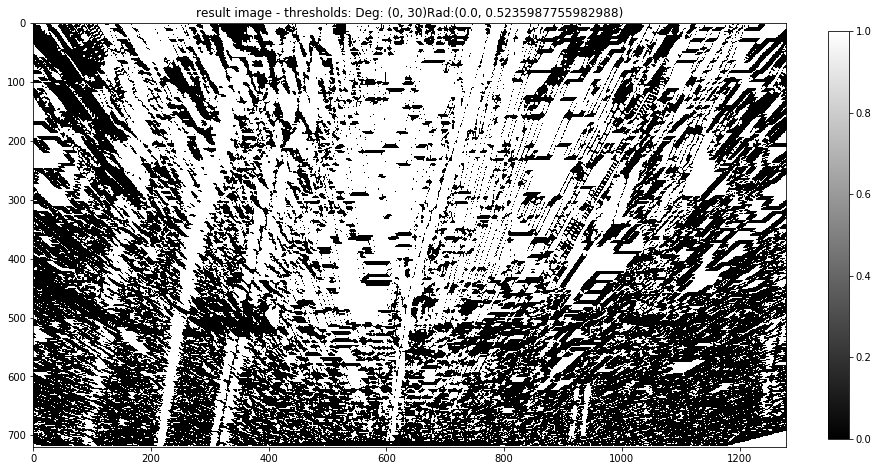

In [22]:
img_to_process = imgWarped
# mag_thr = (90,160)
test_dir_thr = (0,30)
dir_binary = grad_dir_thresh(img_to_process, sobel_kernel=ksize, thresh=test_dir_thr, display = True)

### Gradient Magnitude Thresholding

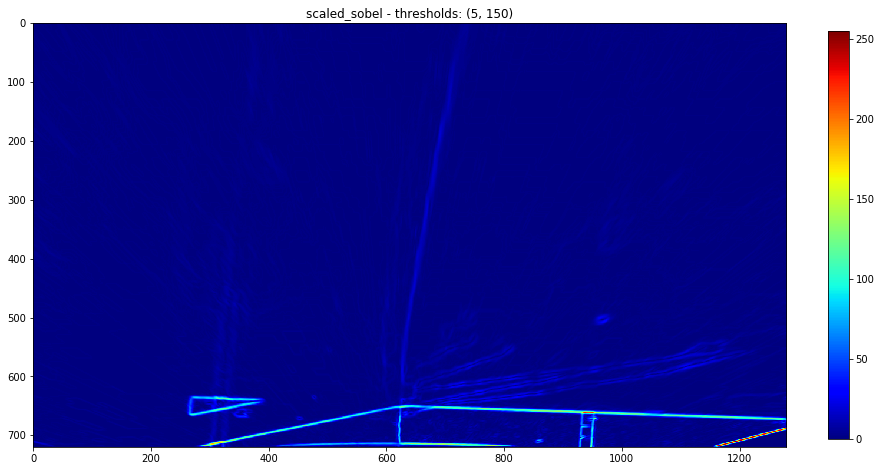

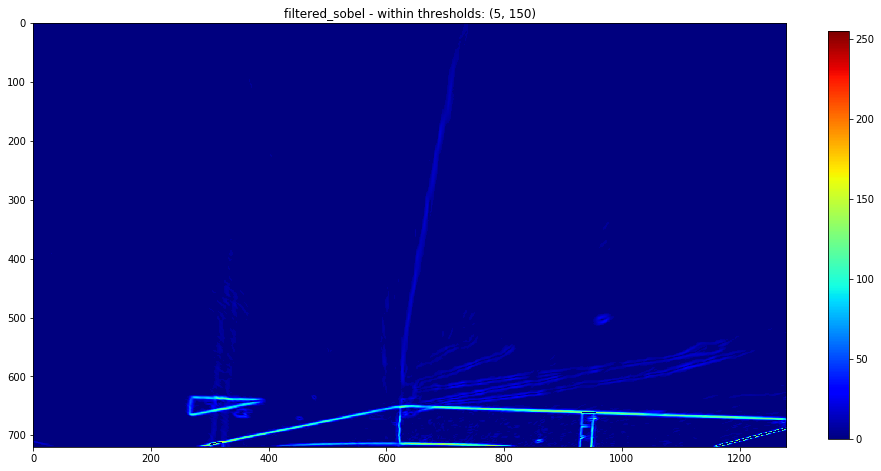

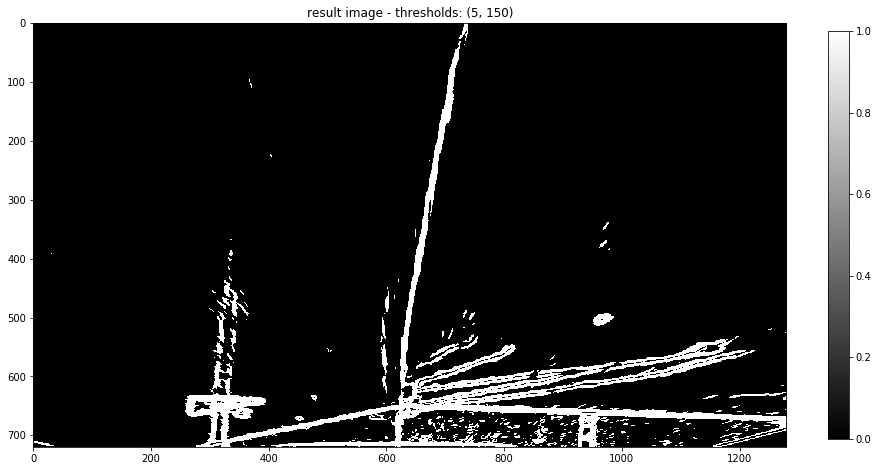

In [260]:
img_to_process = videoPipeline.imgWarped
# mag_thr = (90,160)
test_mag_thr = (5,150)
test_ksize   =  7
mag_binary = grad_mag_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_mag_thr, display = True)


### Gradient Magnitude Thresholding

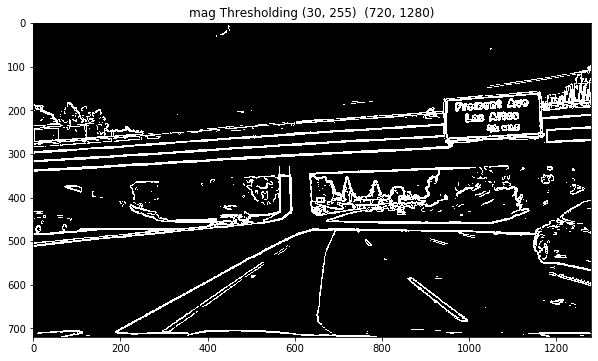

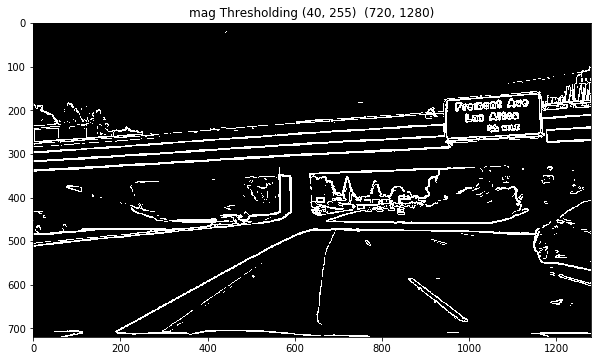

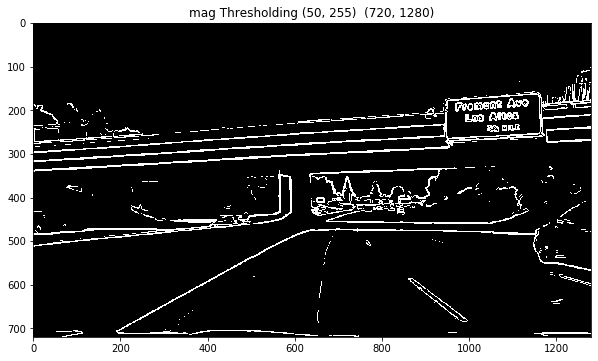

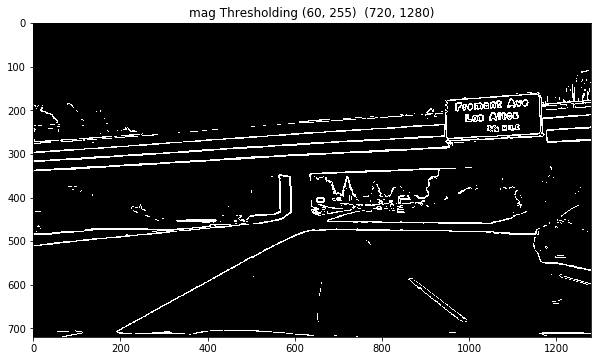

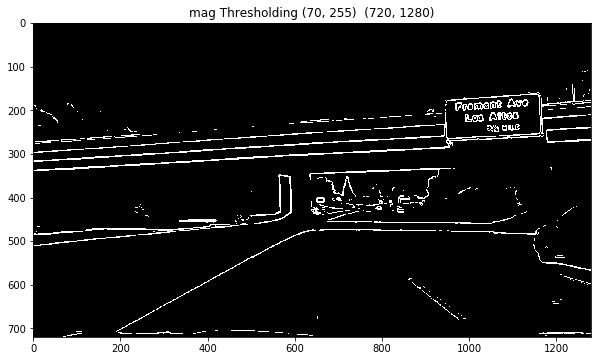

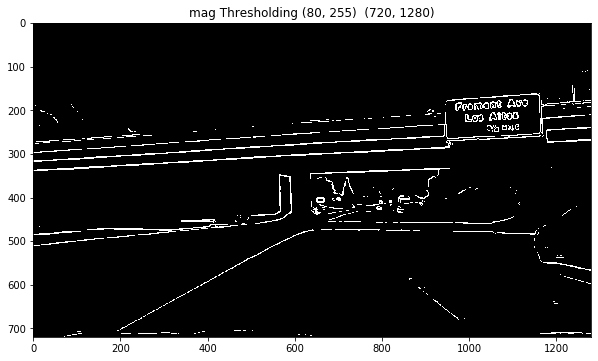

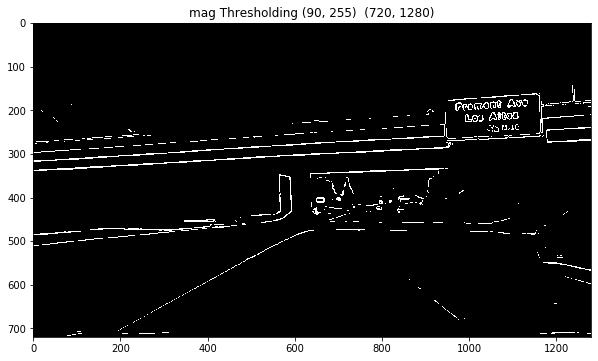

In [39]:
for low_thr in [30, 40, 50, 60,70,80,90]:
    test_mag_thr = (low_thr, 255)
    mag_binary = grad_mag_thresh(imgUndist, sobel_kernel=ksize, thresh=test_mag_thr, display = False)
    display_one(mag_binary, title = 'mag Thresholding '+str(test_mag_thr), size = 10)
#     disp.closePlot()

### Gradient Magnitude  & Direction Thresholding

grad_dir: (720, 1280)  Deg:  (0, 30) Rad: (0.0, 0.5235987755982988)


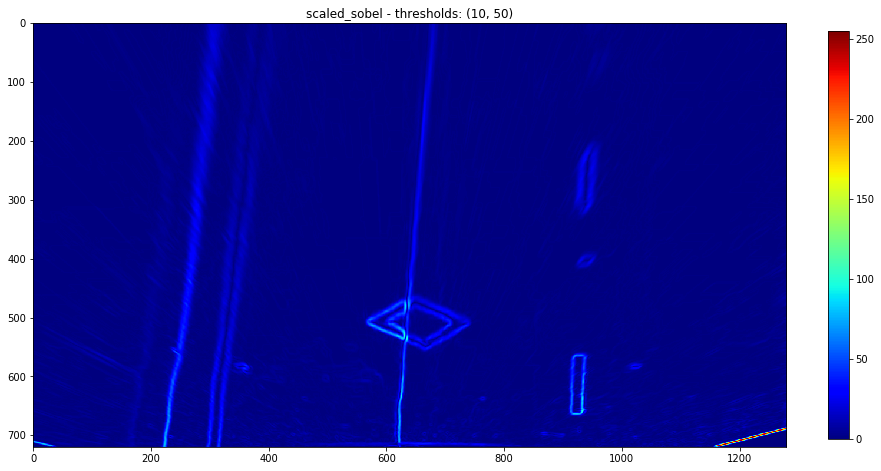

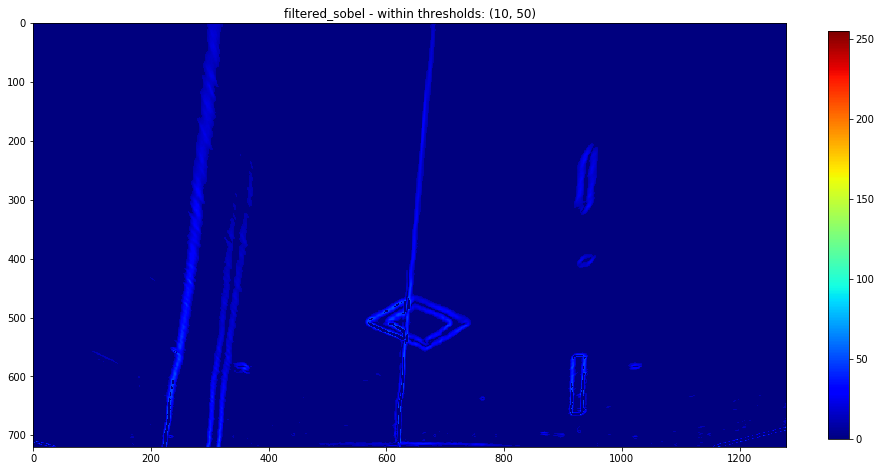

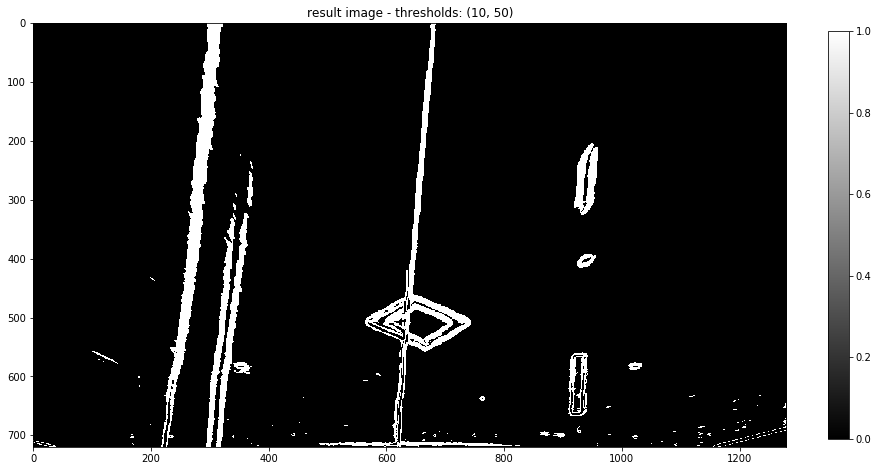

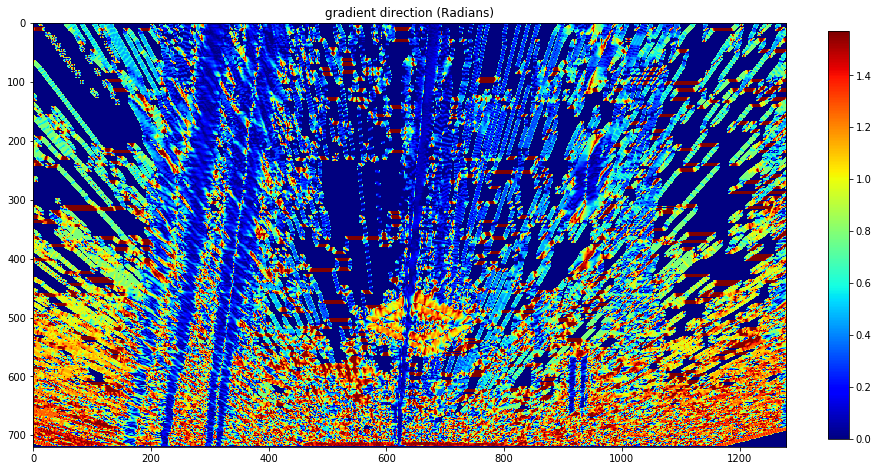

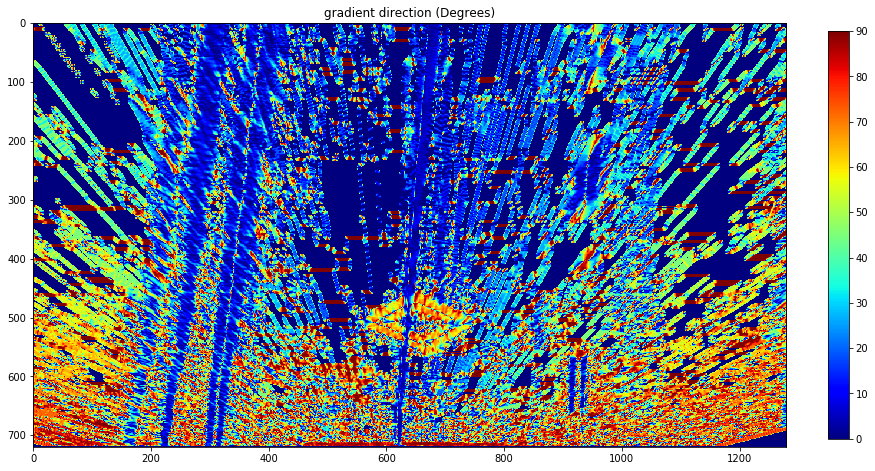

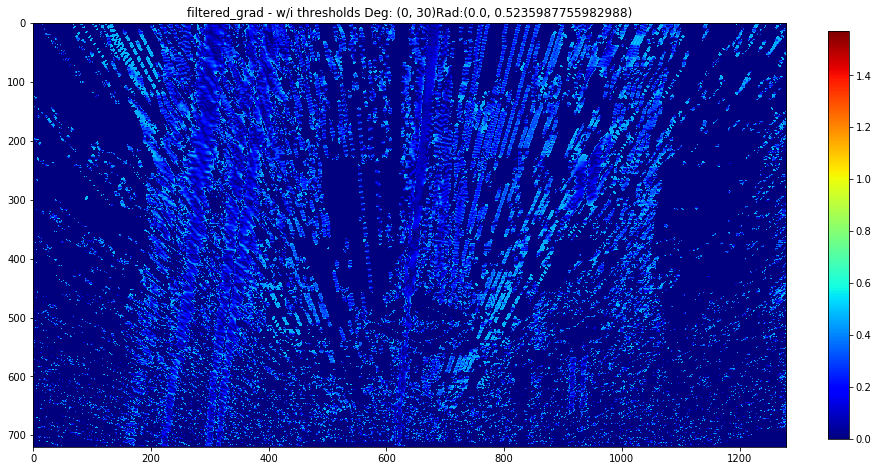

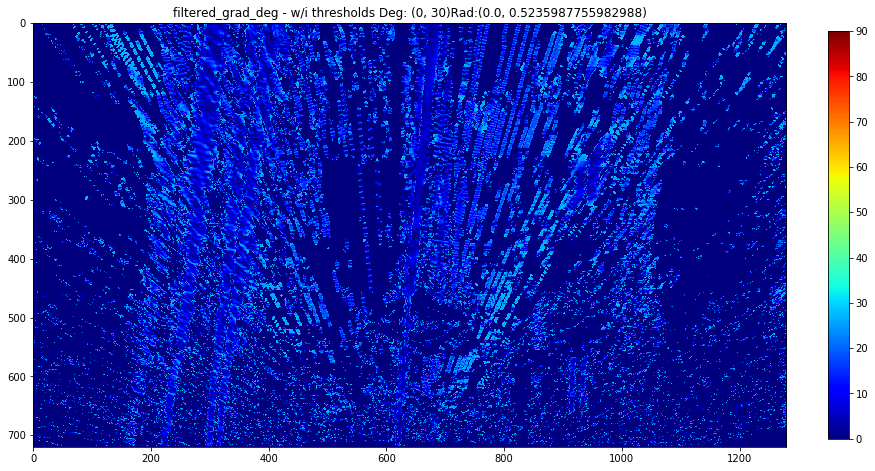

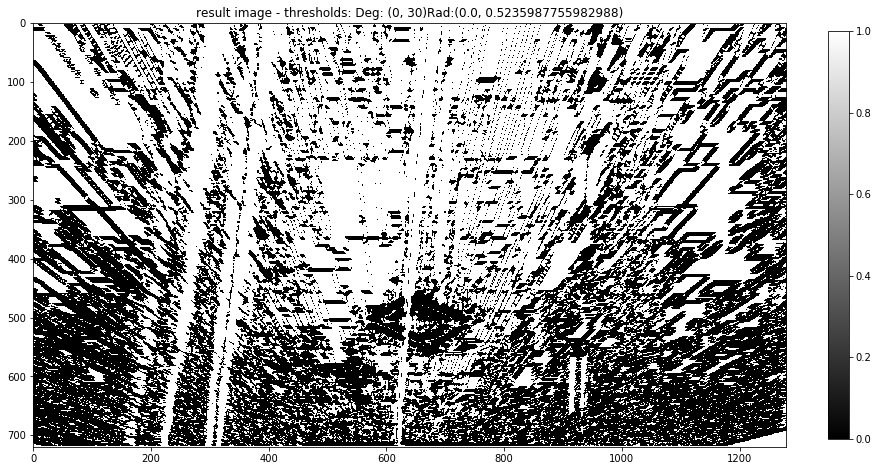

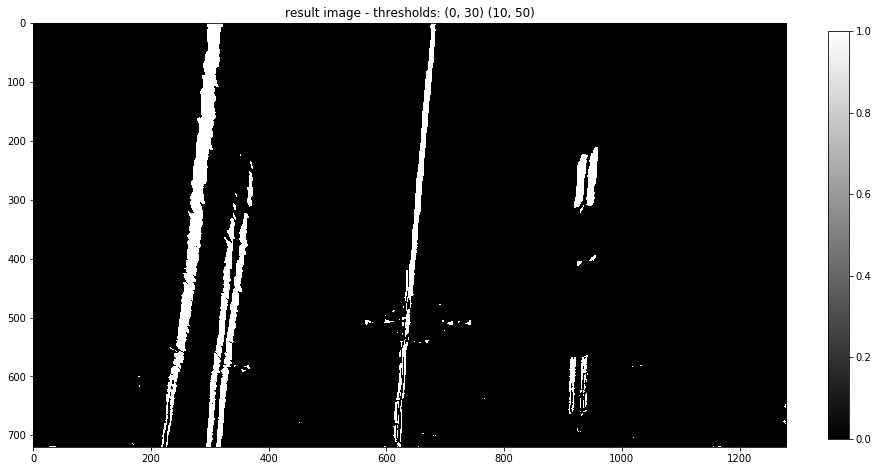

In [46]:
# test_dir_thr = (40,65); test_mag_thr = (35,255)
img_to_process = videoPipeline.imgWarped
test_ksize = 7
test_mag_thr = (5,100); ## Dark
test_mag_thr = (10,50); ## Light
test_dir_thr = (0,30)

mag_binary = grad_mag_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_mag_thr, display = True)
dir_binary = grad_dir_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_dir_thr, display = True)
cmb_mag_dir  = np.zeros_like(dir_binary)
cmb_mag_dir[ ((mag_binary == 1) & (dir_binary == 1)) ] = 1
display_one_cbar(cmb_mag_dir , title='result image - thresholds: '+str(test_dir_thr)+' '+str(test_mag_thr))

### Saturation Thresholding 

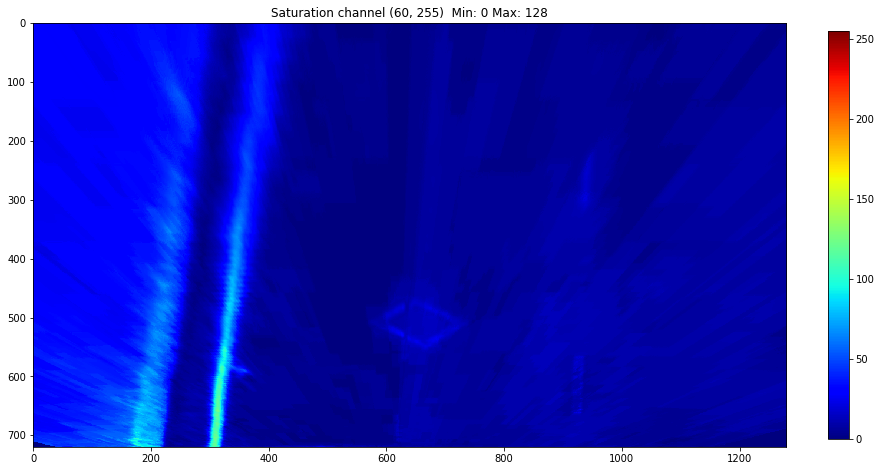

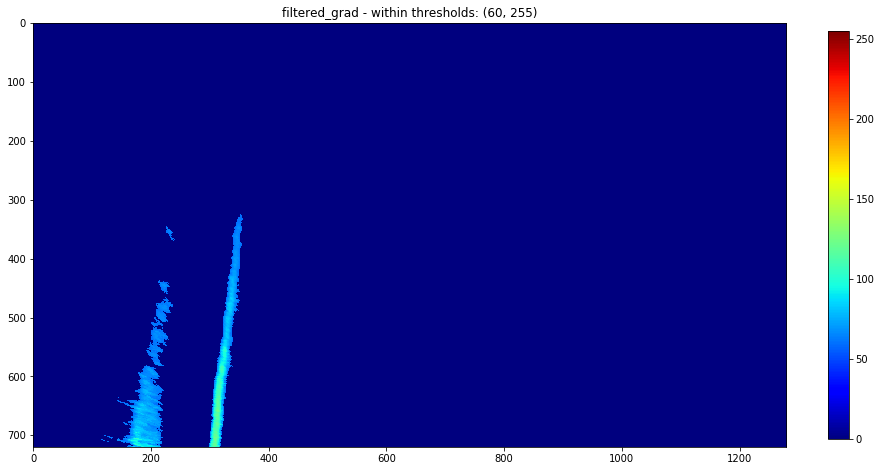

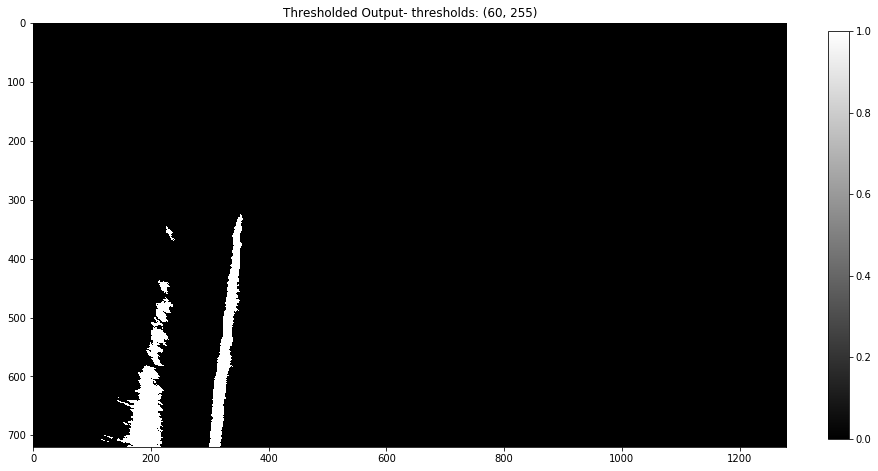

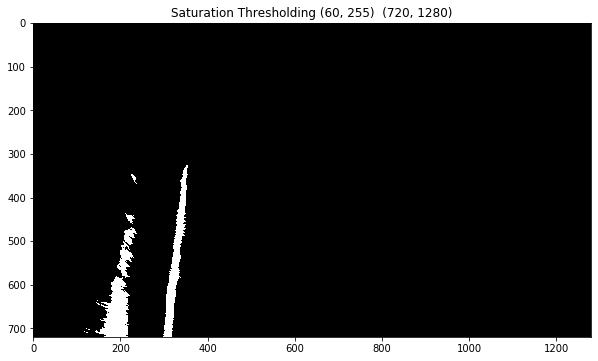

In [37]:
img_to_process = videoPipeline.imgWarped
test_sat_thr = (60, 255)
s_binary   = saturation_thresh(img_to_process, thresh=test_sat_thr, display = True)
display_one(s_binary, title = 'Saturation Thresholding '+str(test_sat_thr), size = 10)    

### Saturation Thresholding 

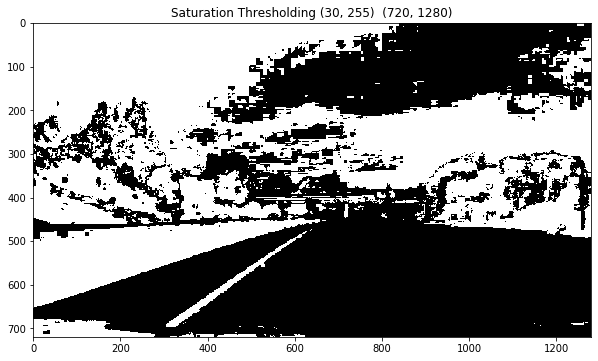

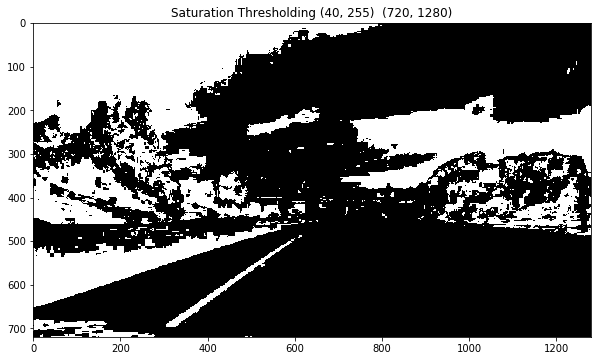

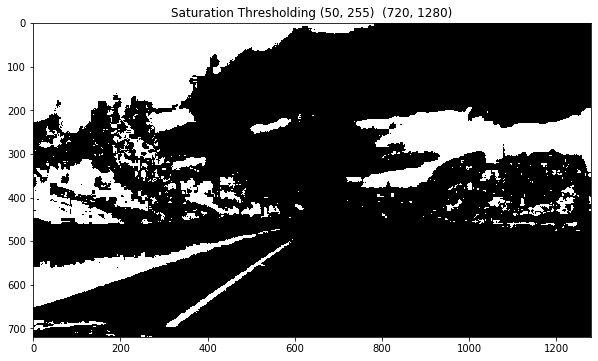

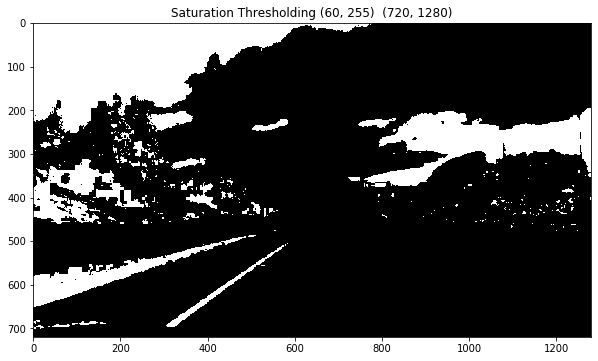

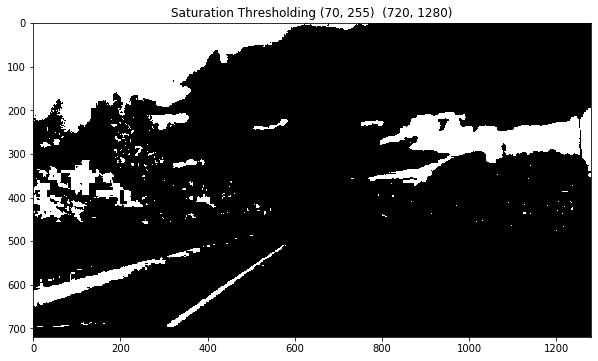

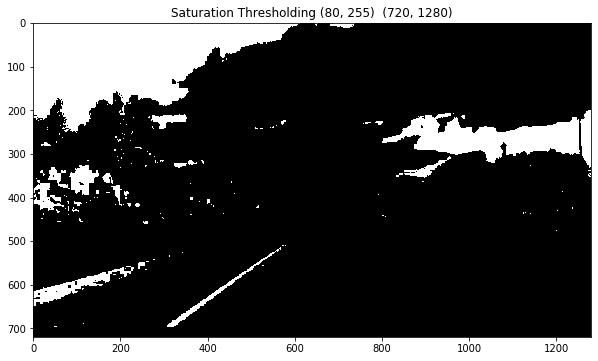

In [142]:
for low_thr in [30, 40, 50, 60, 70, 80]:
    sat_thr = (low_thr, 255)
    s_binary   = saturation_thresh(image, thresh=sat_thr)
    display_one(s_binary, title = 'Saturation Thresholding '+str(sat_thr), size = 10)    

### Saturation Thresholding 

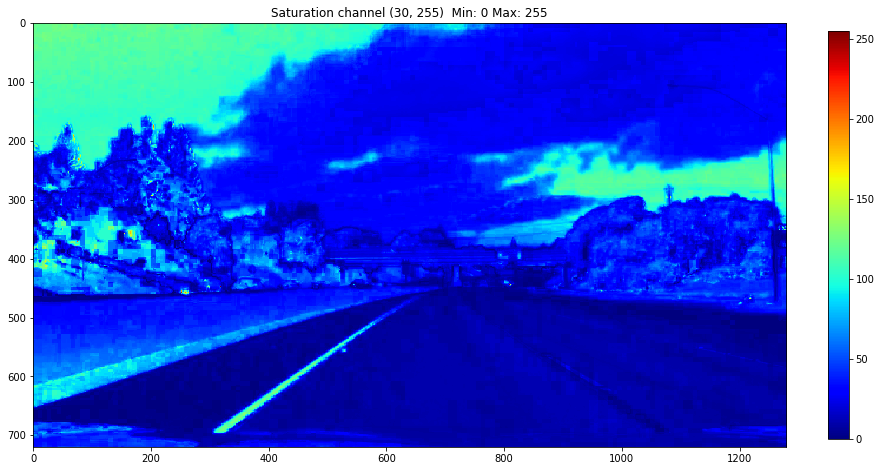

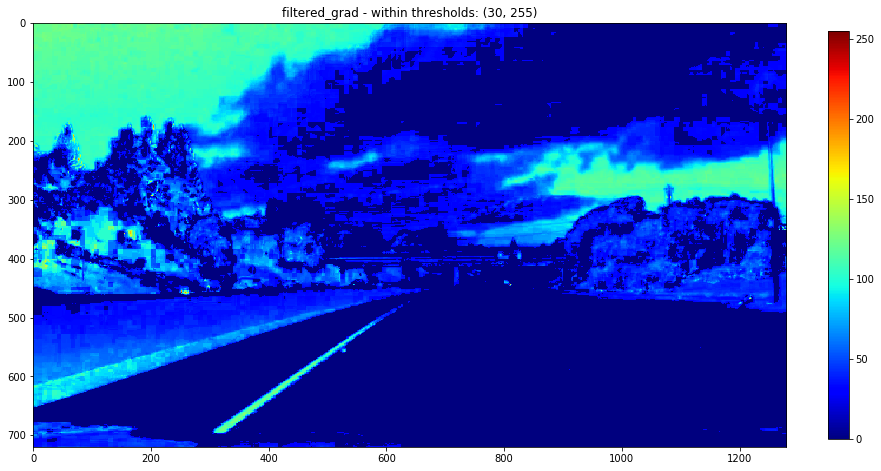

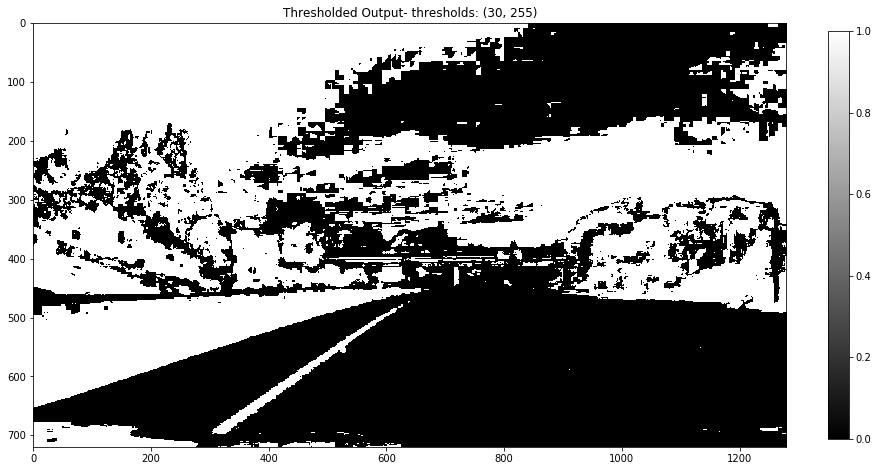

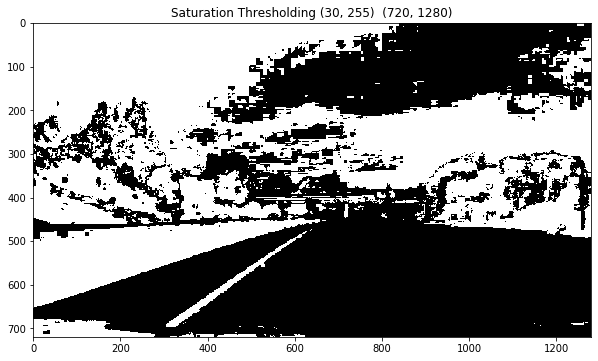

In [141]:
sat_thr = (30, 255)
s_binary   = saturation_thresh(image, thresh=sat_thr, display = True)
display_one(s_binary, title = 'Saturation Thresholding '+str(sat_thr), size = 10)    

### Hue Thresholding 

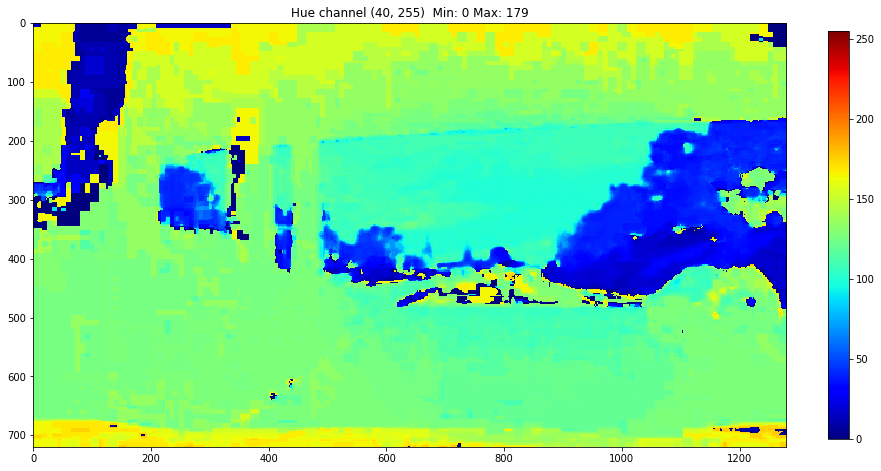

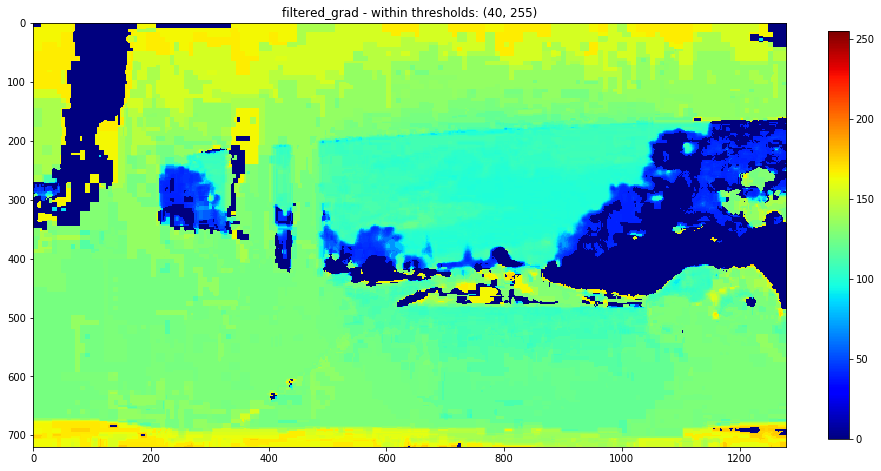

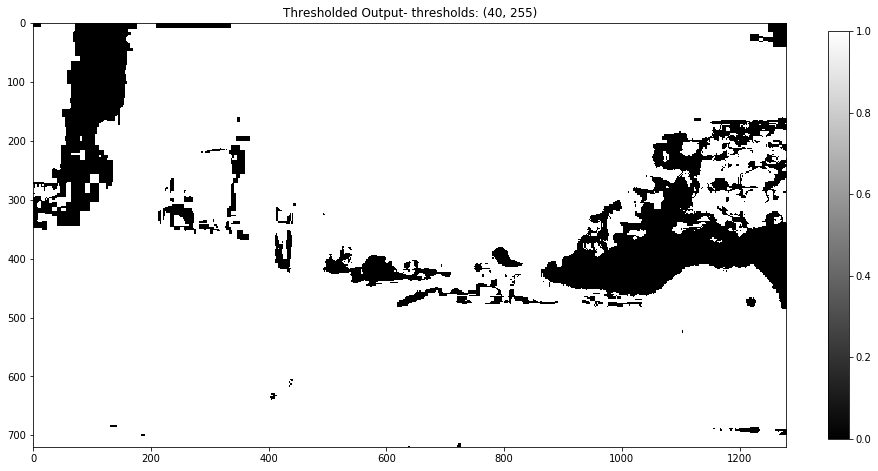

In [178]:
test_hue_thr = (40, 255)
s_binary   = hue_thresh(image, thresh=test_hue_thr, display = True)
# display_one(s_binary, title = 'Hue Thresholding '+str(test_hue_thr), size = 10)    

### Level Thresholding 

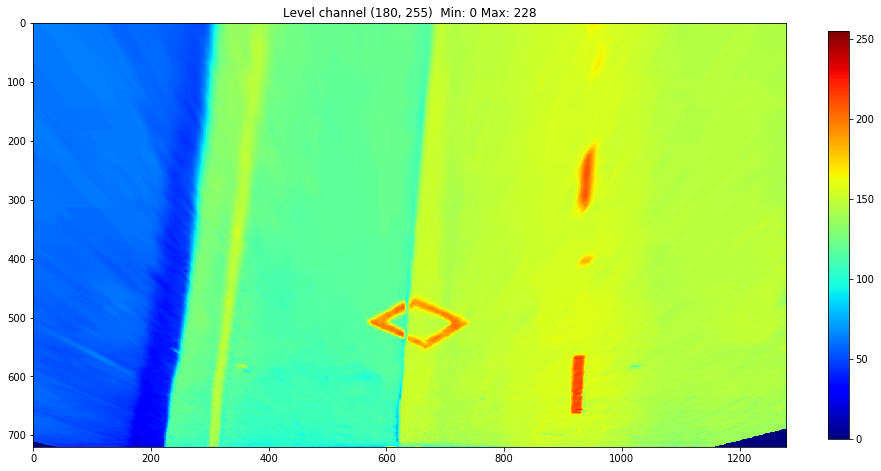

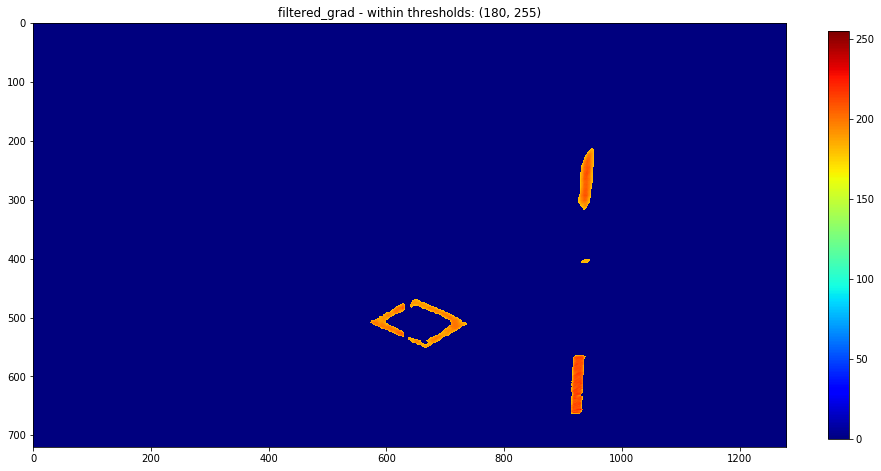

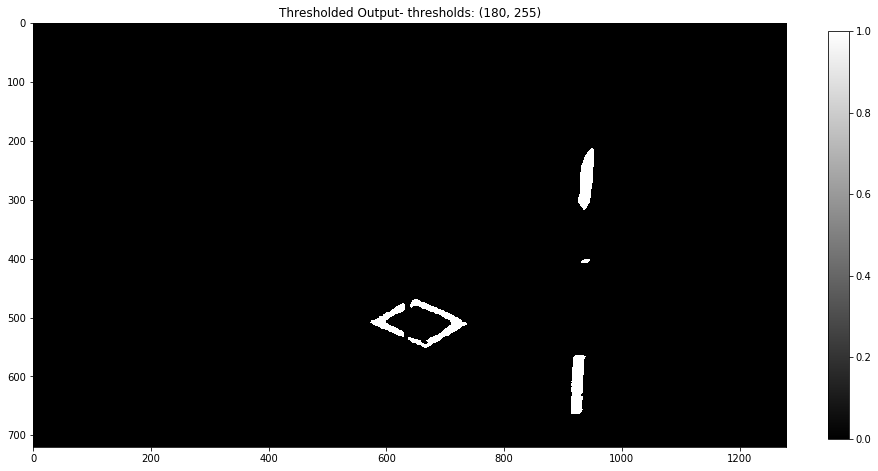

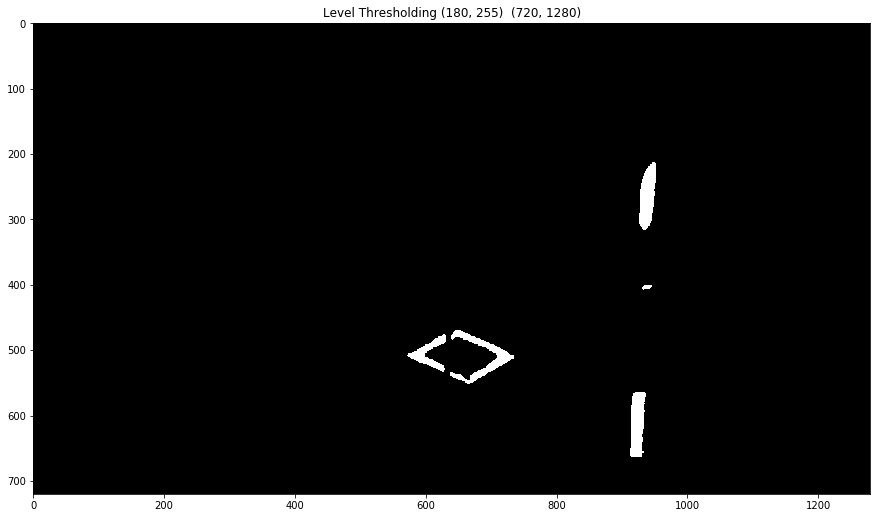

In [38]:
img_to_process = videoPipeline.imgWarped
test_lvl_thr = (180, 255)
s_binary   = level_thresh(img_to_process, thresh=test_lvl_thr, display = True)
display_one(s_binary, title = 'Level Thresholding '+str(test_lvl_thr))    

### HSV Value Thresholding 

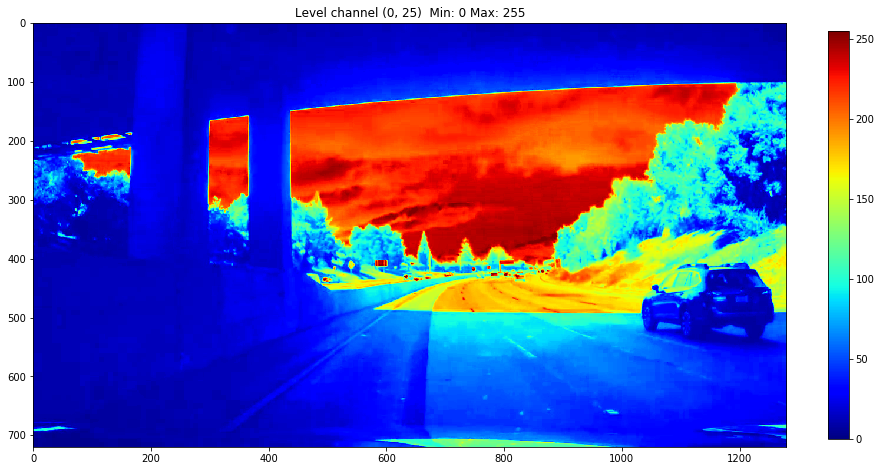

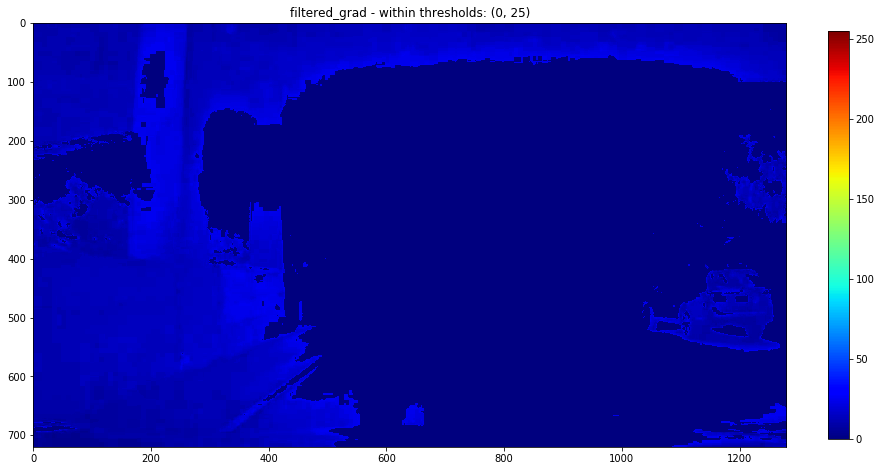

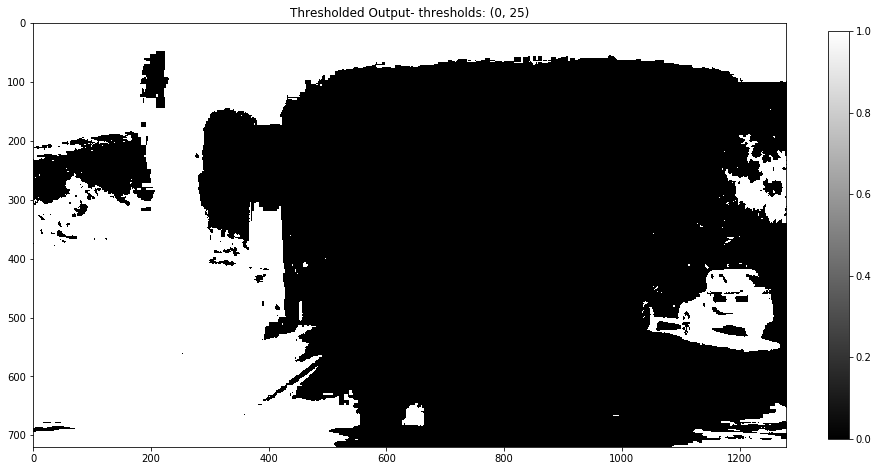

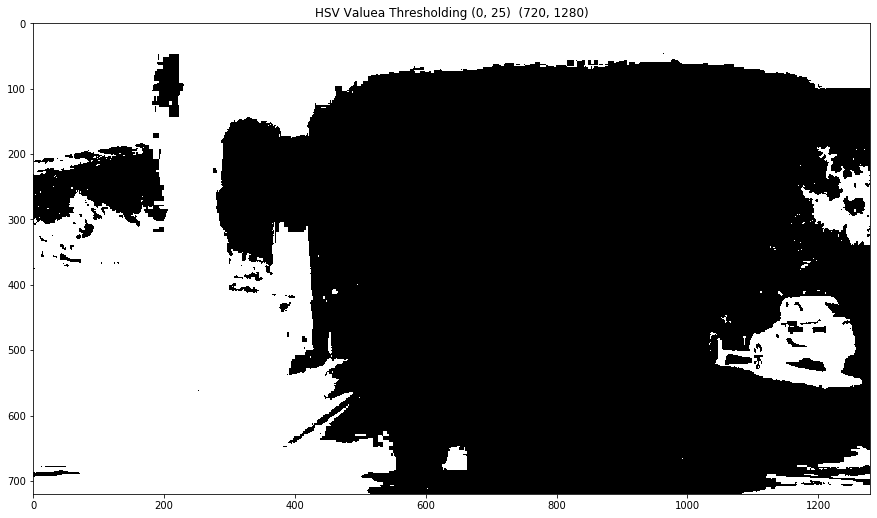

In [205]:
test_val_thr = (0, 25)
s_binary   = HSV_value_thresh(image, thresh=test_val_thr, display = True)
display_one(s_binary, title = 'HSV Valuea Thresholding '+str(test_val_thr))    

### YCrCb Y Thresholding 

In [207]:
from common.sobel import *

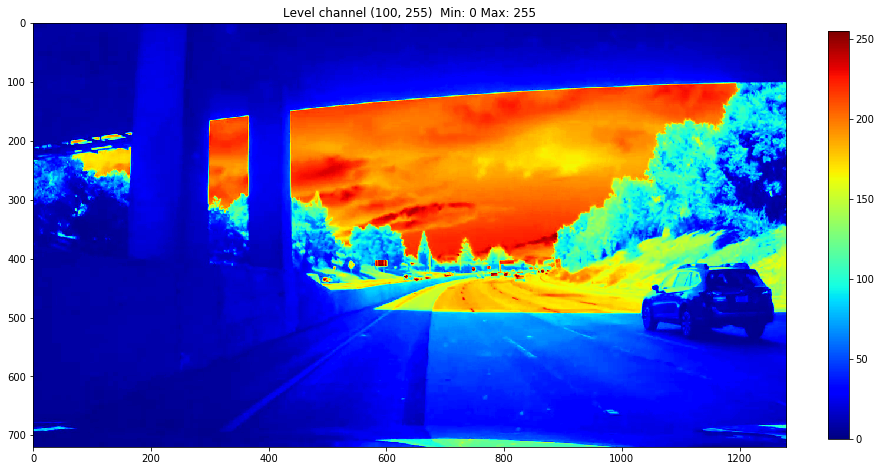

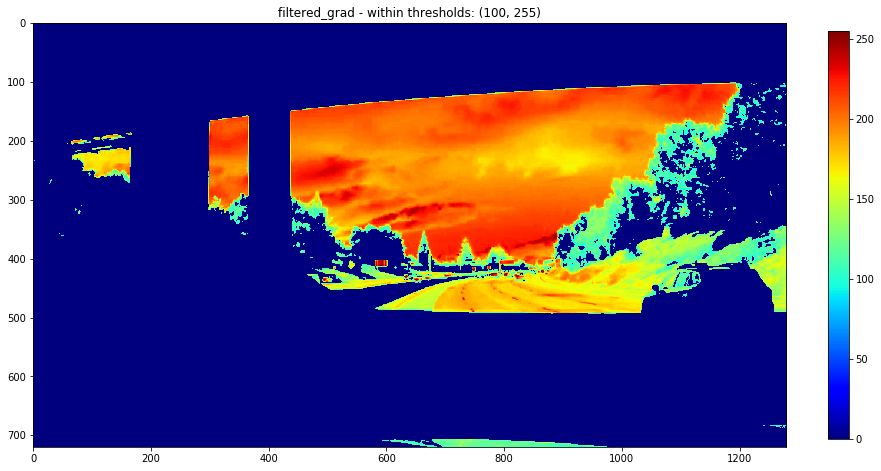

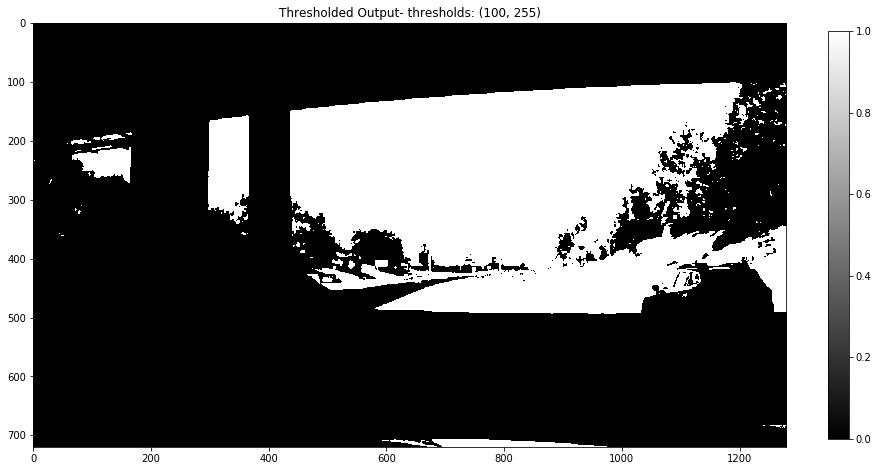

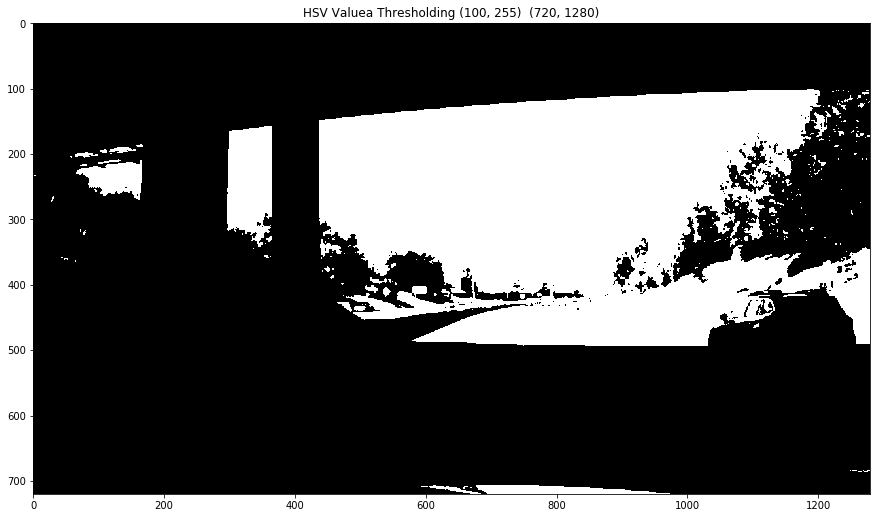

In [208]:
test_Y_thr = (100, 255)
s_binary   = YCrCb_Y_thresh(image, thresh=test_Y_thr, display = True)
display_one(s_binary, title = 'HSV Valuea Thresholding '+str(test_Y_thr))    

### YCrCb Cr Thresholding 

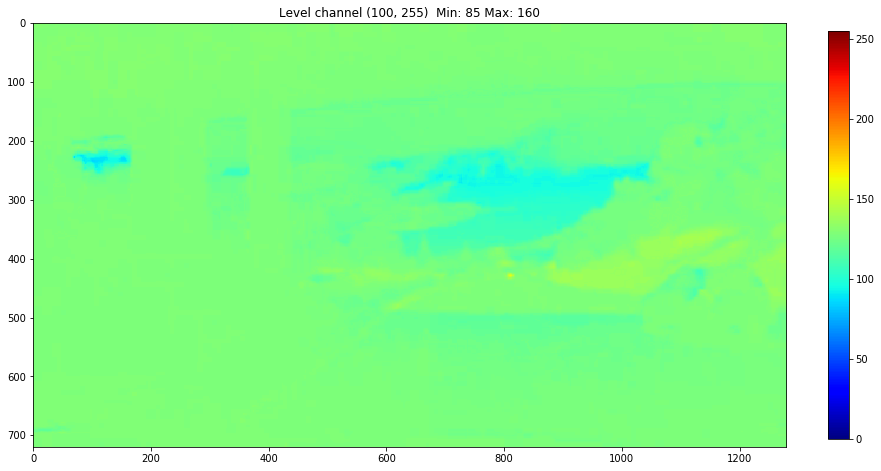

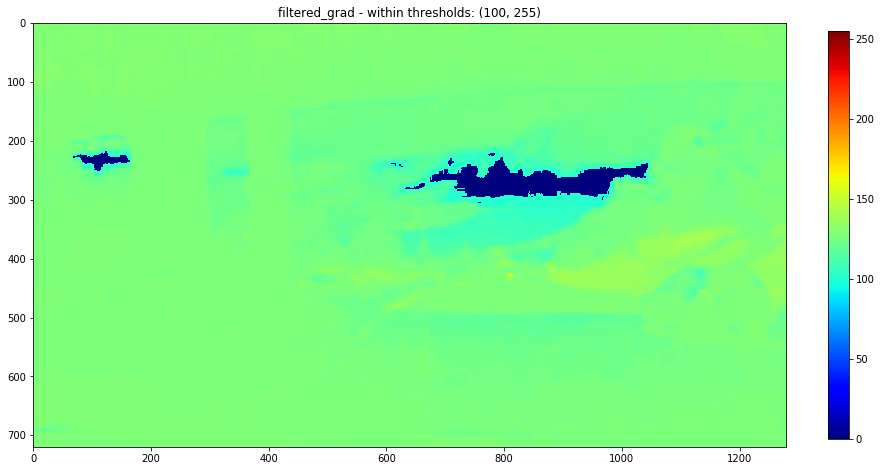

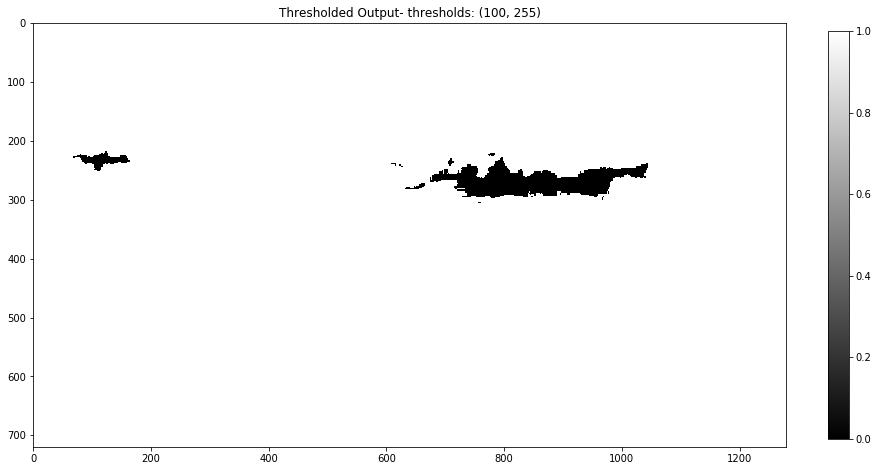

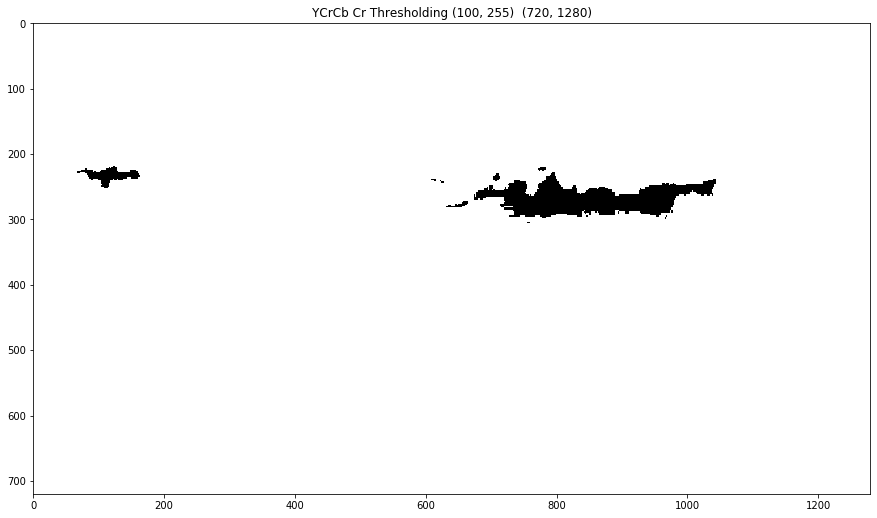

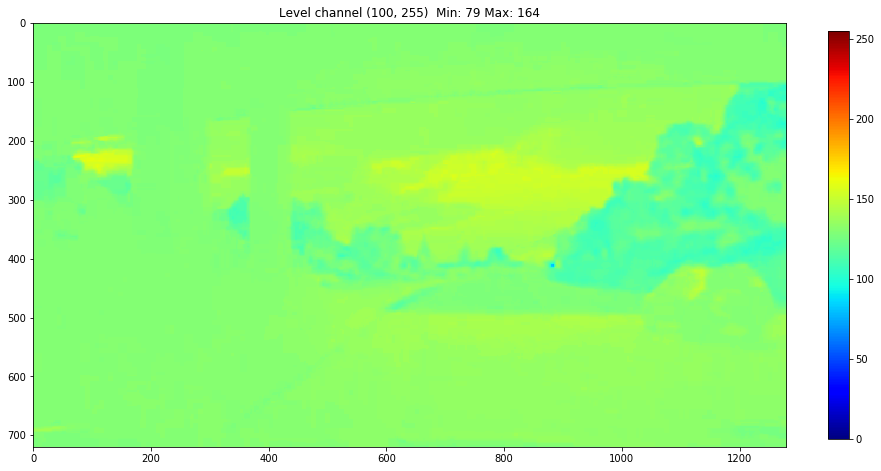

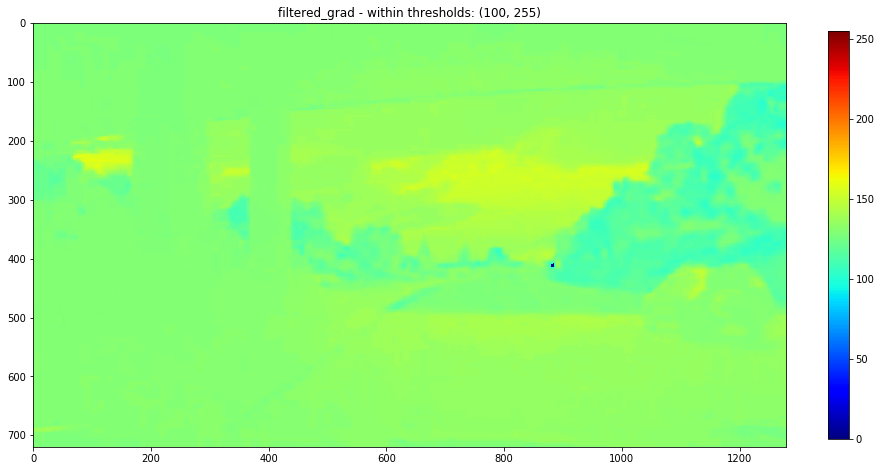

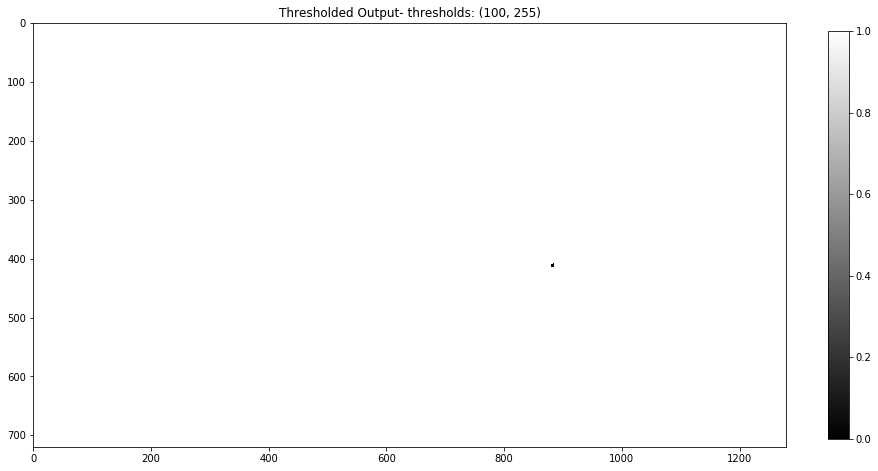

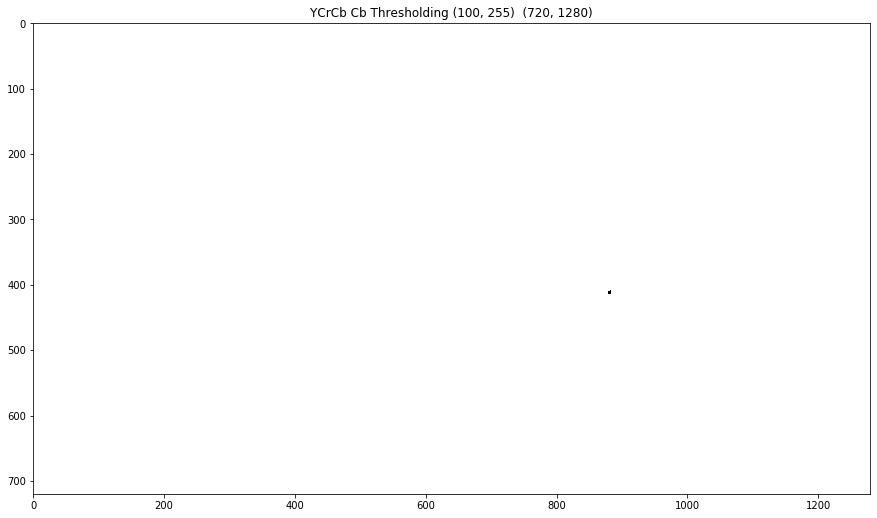

In [210]:
test_Cr_thr = (100, 255)
s_binary   = YCrCb_Cr_thresh(image, thresh=test_Cr_thr, display = True)
display_one(s_binary, title = 'YCrCb Cr Thresholding '+str(test_Cr_thr)) 

test_Cb_thr = (100, 255)
s_binary   = YCrCb_Cb_thresh(image, thresh=test_Cb_thr, display = True)
display_one(s_binary, title = 'YCrCb Cb Thresholding '+str(test_Cb_thr)) 

### Red Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


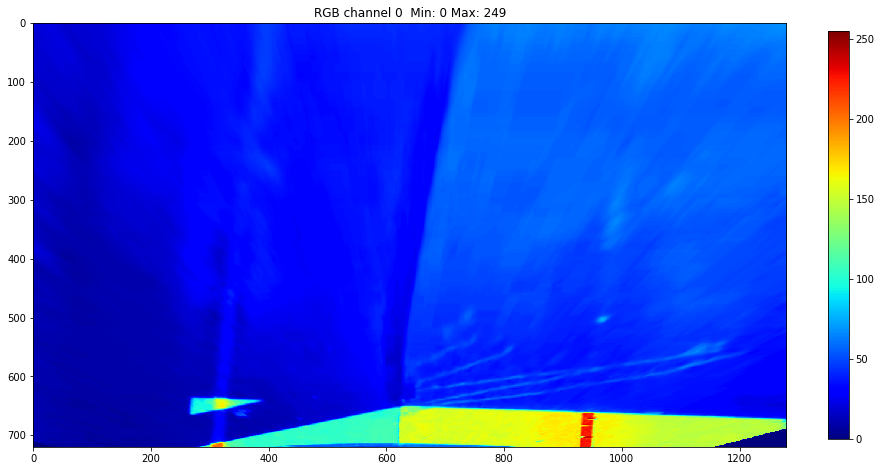

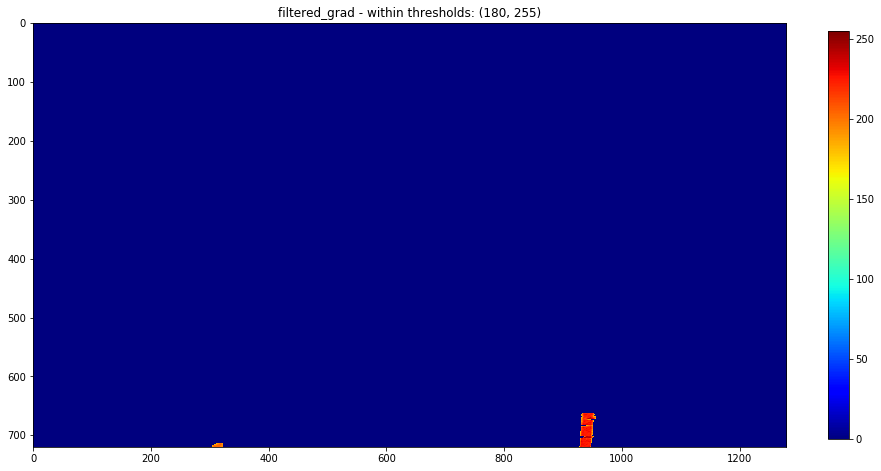

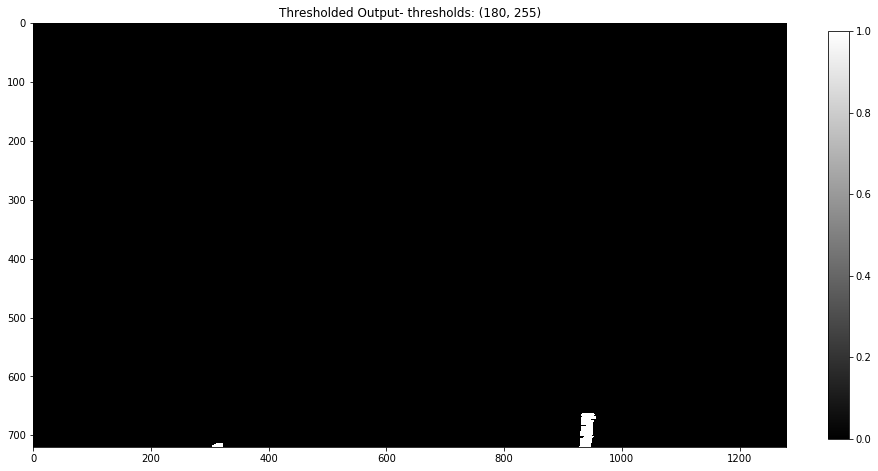

In [267]:
# from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr  = (180, 255)
red_binary = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 0, display = True)
# display_one_cbar(s_binary, title = 'Red Channel Thresholding '+str(rgb_thr) )    

### Green Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


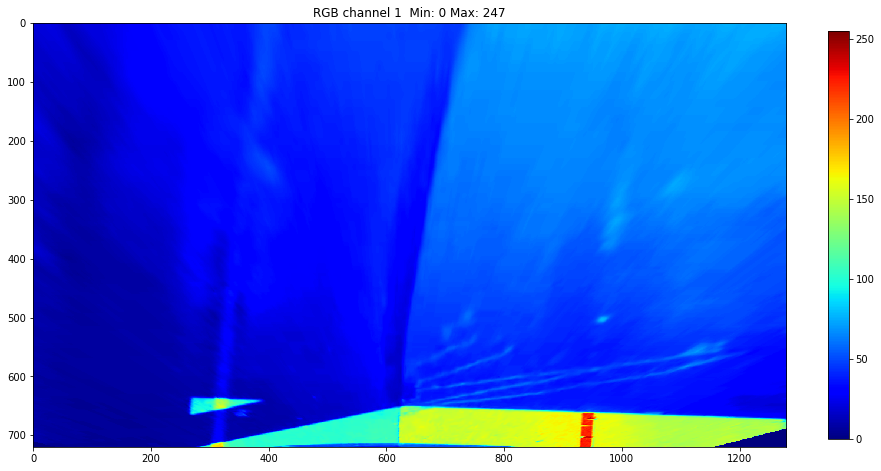

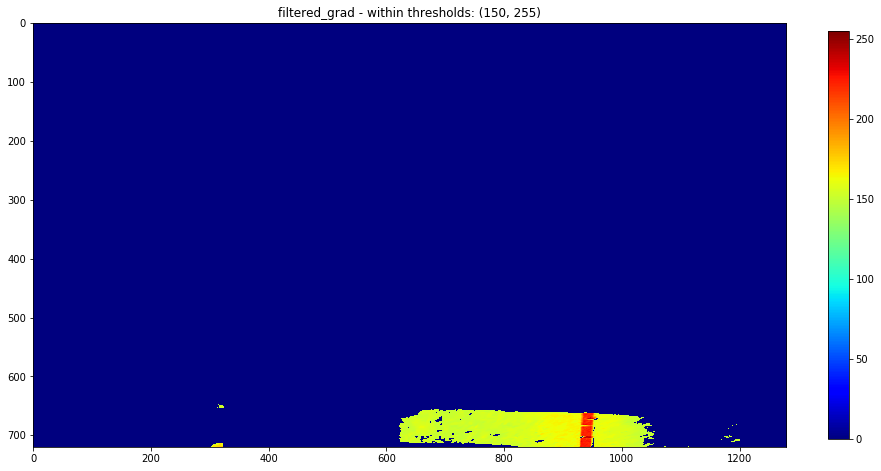

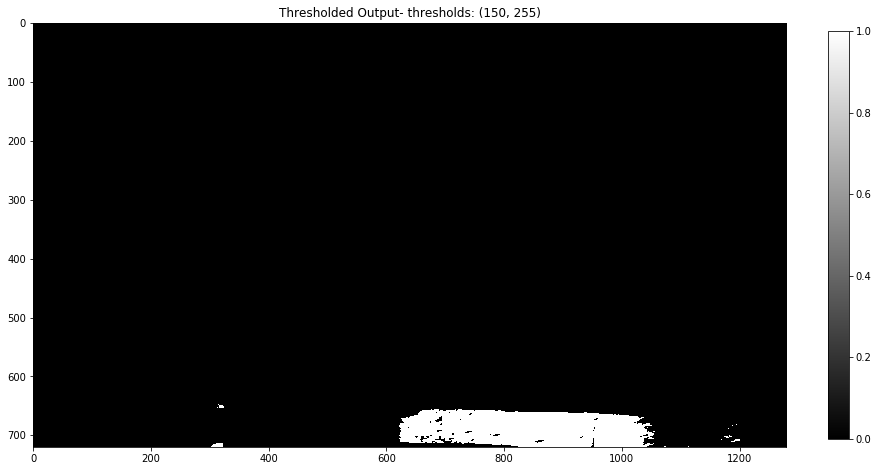

In [269]:
# from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr = (180, 255)
green_binary   = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 1, display = True)
# display_one_cbar(s_binary, title = 'Green Channel Thresholding '+str(rgb_thr) )    

### Blue Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


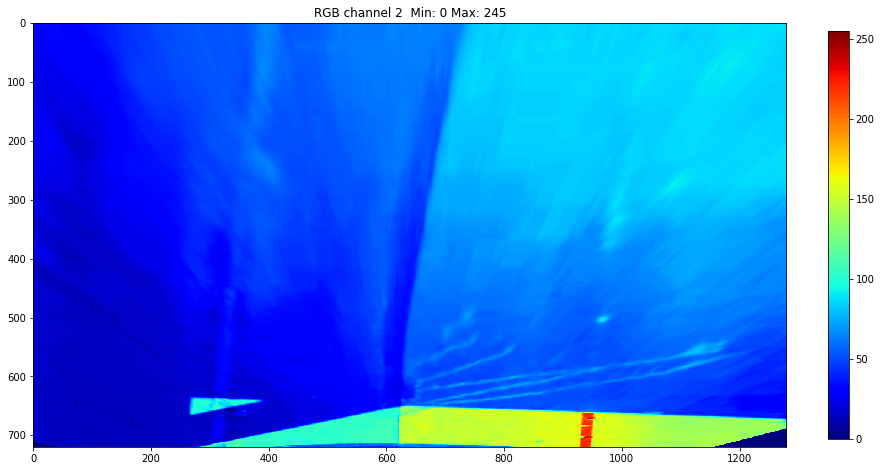

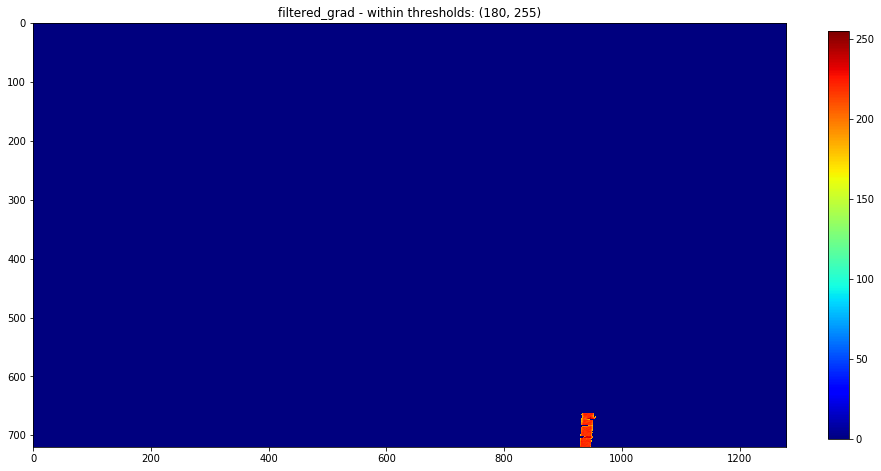

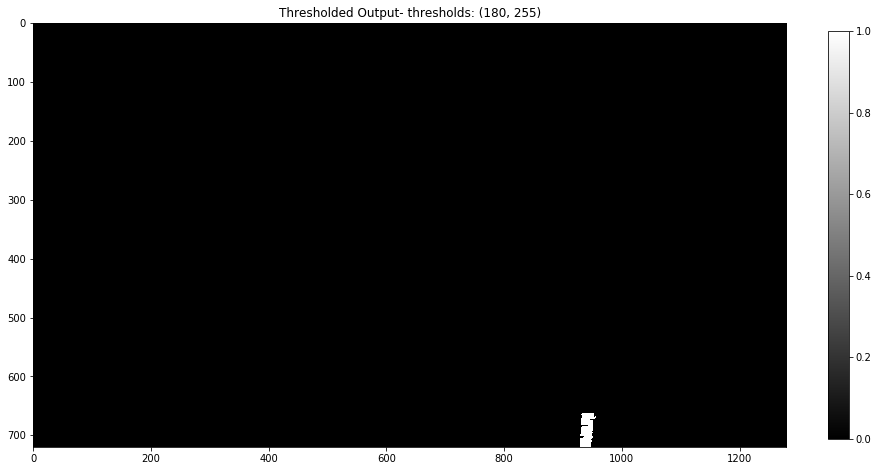

In [270]:
from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr = (180, 255)
blue_binary   = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 2, display = True)
# display_one_cbar(s_binary, title = 'BLUE Channel Thresholding '+str(rgb_thr) )    

In [58]:
from common.sobel import *

### RGB Thresholding

In [39]:
cmb_rgb_dir  = np.zeros_like(dir_binary)
cmb_rgb_dir[ (red_binary == 1) | (green_binary == 1)| (blue_binary ==1) ] = 1
display_one_cbar(cmb_rgb_dir , title='result image - thresholds: '+str(test_rgb_thr)+' '+str(test_rgb_thr))

rgb_or_output = RGB_thresh(img_to_process, thresh=test_rgb_thr, display = True)

NameError: name 'dir_binary' is not defined

### RGB Thresholding

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280, 3)
 s_channel    :  (720, 1280, 3)
 binary_output:  (720, 1280)
(720, 1280) 0 1


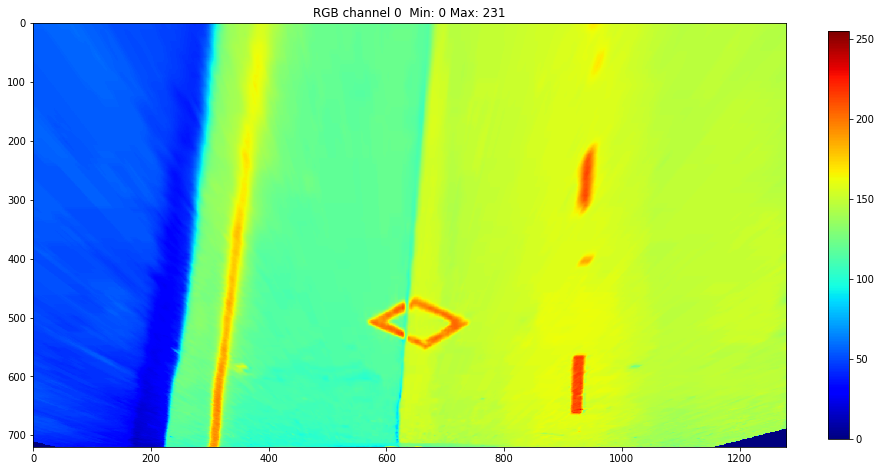

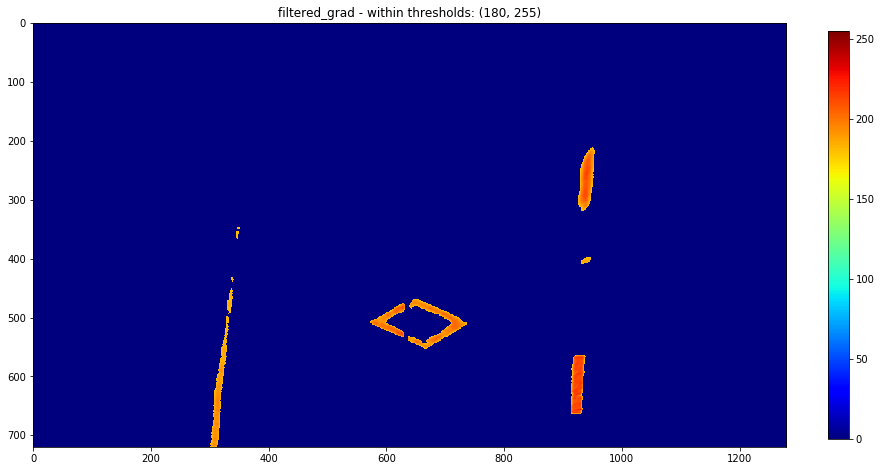

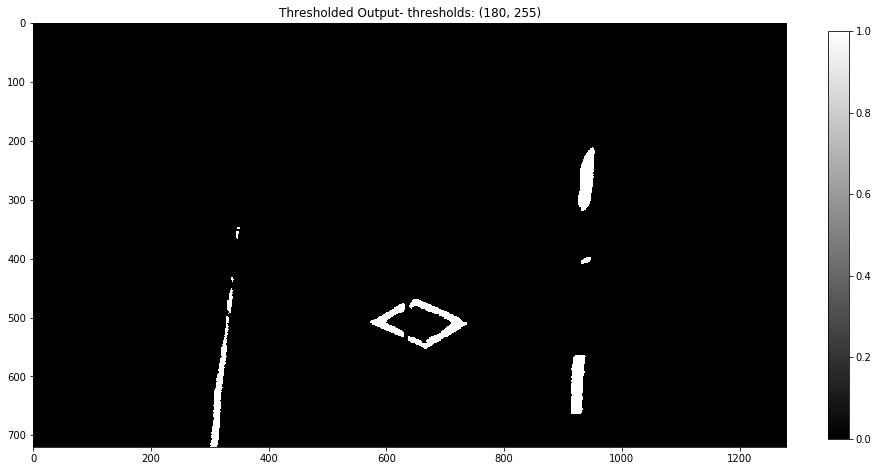

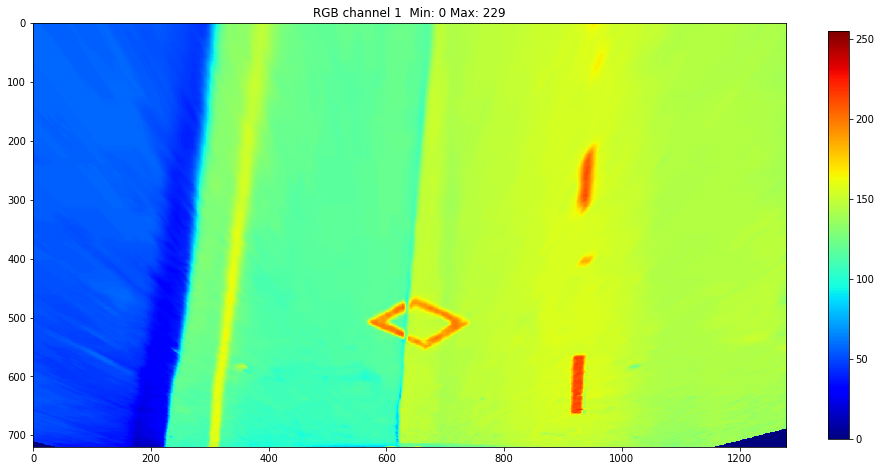

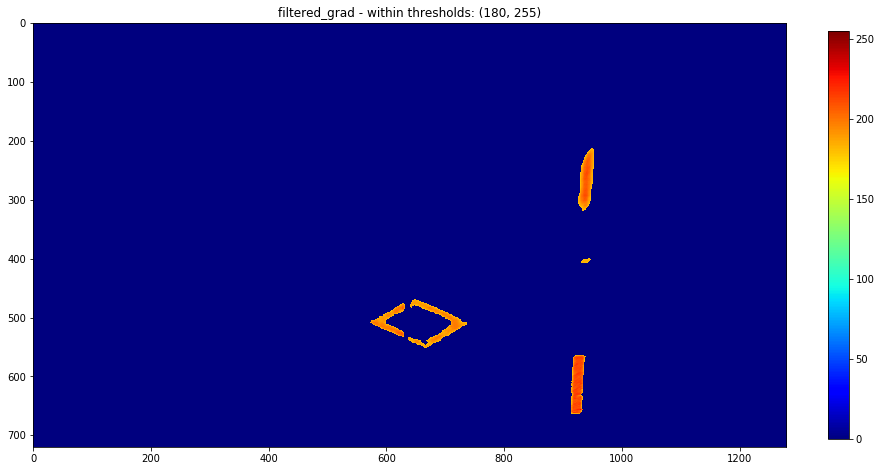

...

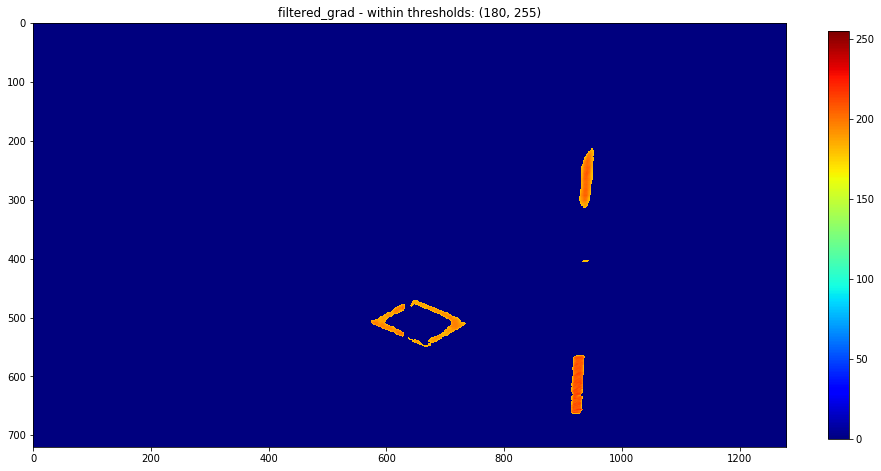

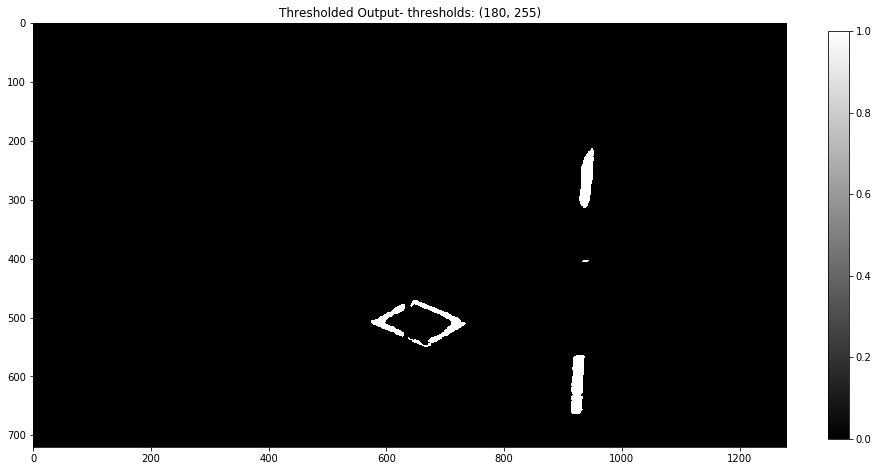

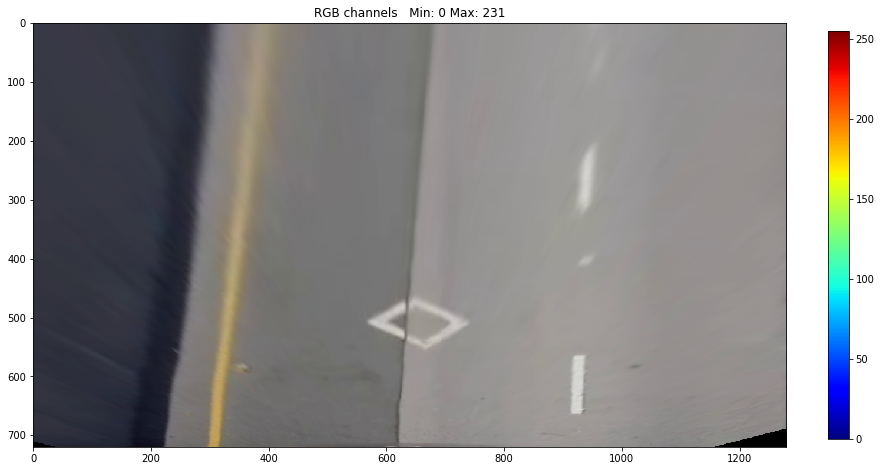

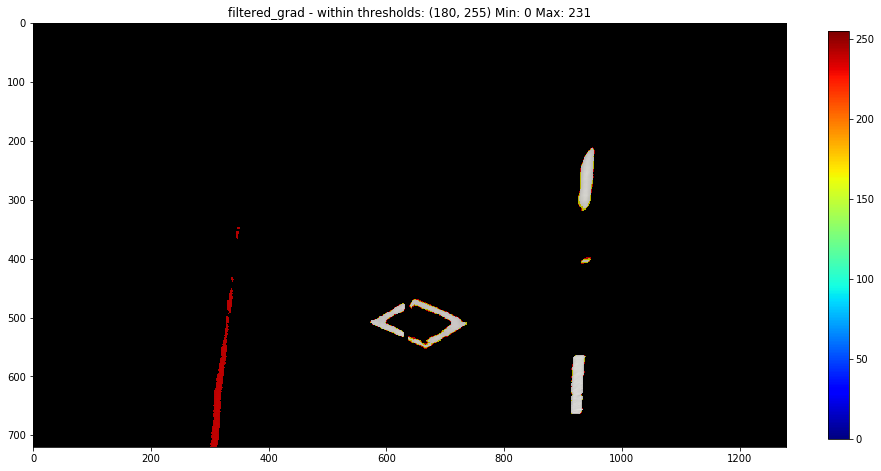

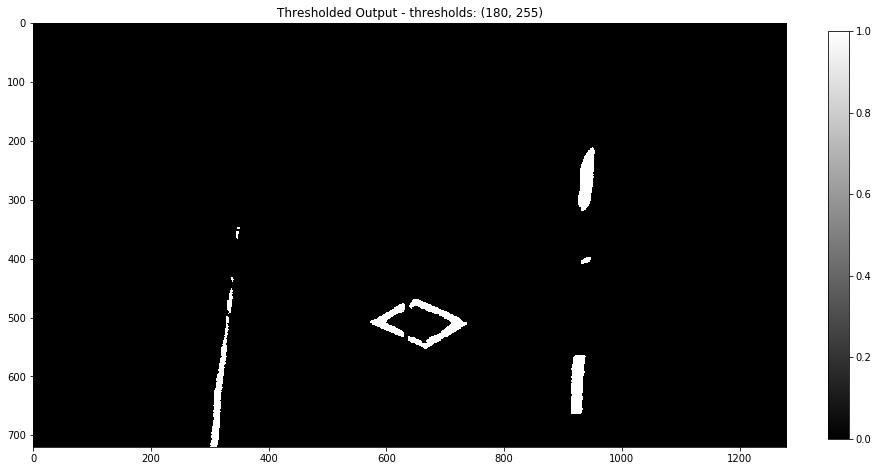

In [40]:
from common.sobel import *
test_rgb_thr = (180, 255)
rgb_binary   = RGB_thresh(img_to_process, thresh=test_rgb_thr,  display = True)
# display_one_cbar(s_binary, title = ' RGB Thresholding '+str(rgb_thr) )    

## Applying Multiple Thresholds 

In [77]:
from common.sobel import apply_thresholds

####  T1

In [462]:
# ksize = 19 # Choose a larger odd number to smooth gradient measurements
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
# theta1     = 45
# theta2     = 67

# ksize      = 5
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# dir_thr    = (40,65)
# sat_thr    = (90,255)

#--adjusted for challenge video -------------=
ksize      = 7
test_grad_x_thr = (30,255)
test_grad_y_thr = (70,255)
test_mag_thr    = (35,255)
test_dir_thr    = (40,65)
test_sat_thr    = (80,255)
test_lvl_thr    = (180,255)
test_rgb_thr    = (180,255)
test_rgb_or_thr = (180,255)
# sat_thr    = (100,255)
#-------------------------------------------=

In [463]:
# from common.utils import *
# blurKernel = 7
# imgBlurred = gaussian_blur(image, blurKernel)

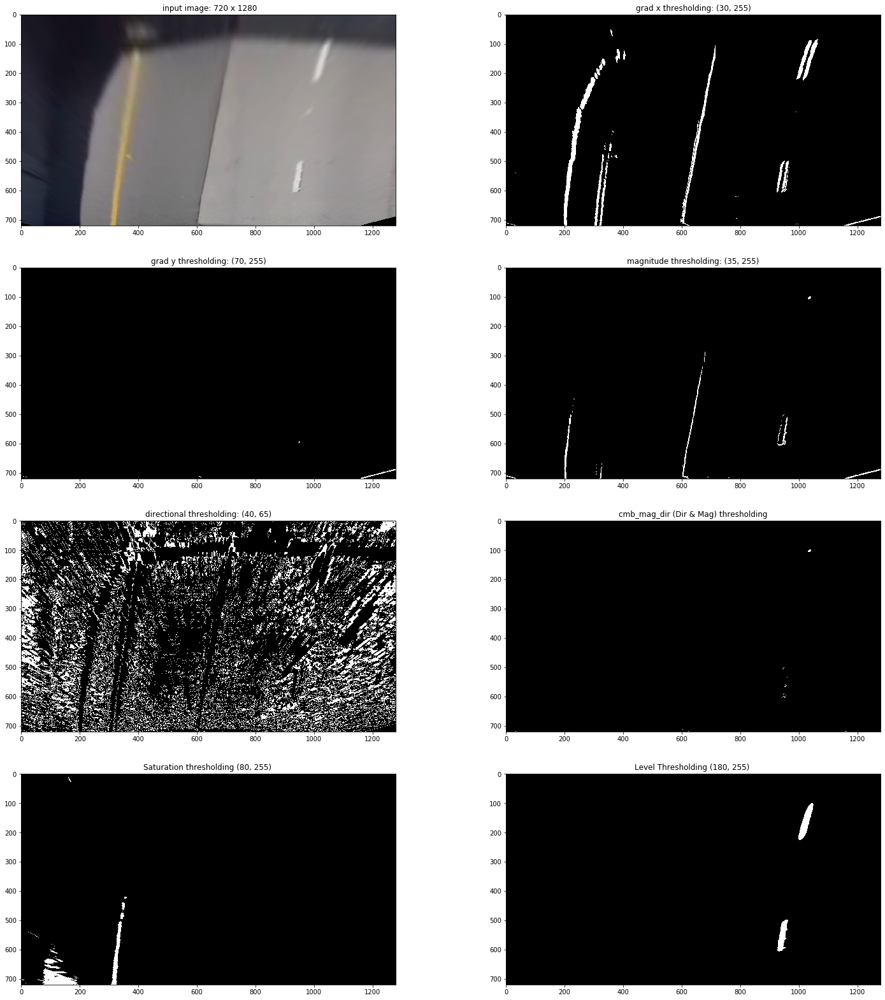

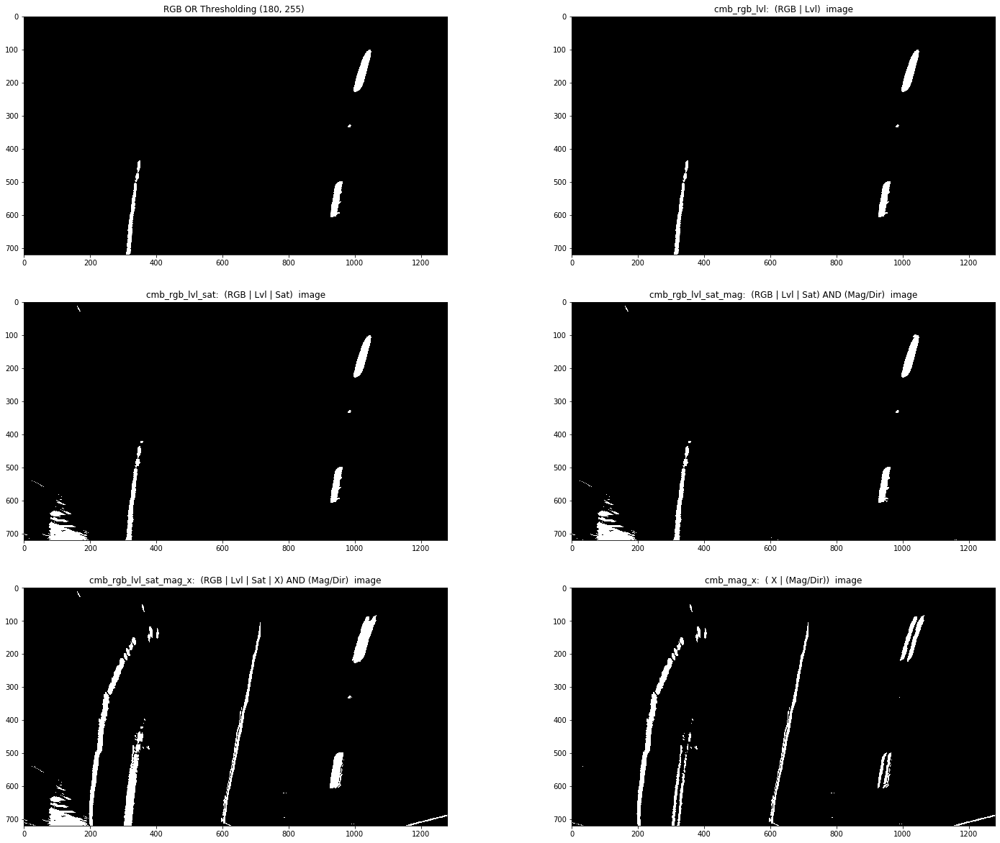

In [466]:
img_to_process = imgWarped
# T1 = apply_thresholds(imgBlurred, ksize=ksize, x_thr = grad_x_thr, y_thr = grad_y_thr, 
#                         mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, 
#                         lvl_thr = lvl_thr, rgb_thr = rgb_thr, debug = True);

T1 = apply_thresholds(img_to_process, ret = 'cmb_rgb_lvl_sat', ksize = ksize, debug = True,
                                       x_thr = test_grad_x_thr, y_thr = test_grad_y_thr, 
                                     mag_thr = test_mag_thr   , dir_thr = test_dir_thr,  
                                     sat_thr = test_sat_thr   , rgb_thr = test_rgb_thr,  
                                     lvl_thr = test_lvl_thr)


####  T2

In [ ]:
# mag_thr    = (35,255), dir_thr    = (40,65),  sat_thr    = (65,255)
    ## dark conditions--------------

#--adjusted for challenge video -------------=
ksize      = 7
# mag_thr = (50,255), dir_thr = (0,10), sat_thr = (80, 255), 
test_grad_x_thr = (30,255)
test_grad_y_thr = (70,255)
# test_mag_thr    = (10,50) 
# test_dir_thr    = (5,25)  

# test_mag_thr    = (40,150) 
test_mag_thr    = (25,250) 
test_dir_thr    = (0,30)

# test_sat_thr    = (70, 255)
# test_lvl_thr    = (180,255)
# test_rgb_thr    = (180,255)

test_sat_thr    = (110, 255)
#-------------------------------
# sat_thr    = (70, 255)
# lvl_thr    = (180, 255)
# rgb_thr    = (180,255)
test_lvl_thr    = (205, 255)
test_rgb_thr   = (205,255)
##----------------------------------

In [25]:
# WarpedNormalThresholds = {
#             'ksize'      : 7         , 
#             'x_thr'      : (30,255)  ,
#             'y_thr'      : (70,255)  ,
#             'mag_thr'    : (10,50)   ,
#             'dir_thr'    : (0,30)    ,
#             'sat_thr'    : (80, 255) ,
#             'lvl_thr'    : (180,255) ,
#             'rgb_thr'    : (180,255) 
# }

In [78]:
WarpedNormalThresholds = {
    'ksize'      : 7         , 
    'x_thr'      : (30,255)  ,
    'y_thr'      : (70,255)  ,
    'mag_thr'    : (10,50)   ,
    'dir_thr'    : (0,30)    ,
    'sat_thr'    : (60, 255) ,
    'lvl_thr'    : (180,255) ,
    'rgb_thr'    : (180,255) 
}

WarpedDarkThresholds = {
    'ksize'      : 7         ,
    'x_thr'      : (70,255)  ,
    'y_thr'      : (70,255)  ,
    'mag_thr'    : (5,100)  ,
    'dir_thr'    : (0,30)    ,
    'sat_thr'    : (130,255) ,
    'lvl_thr'    : (200,255) ,
    'rgb_thr'    : (200,255)
}

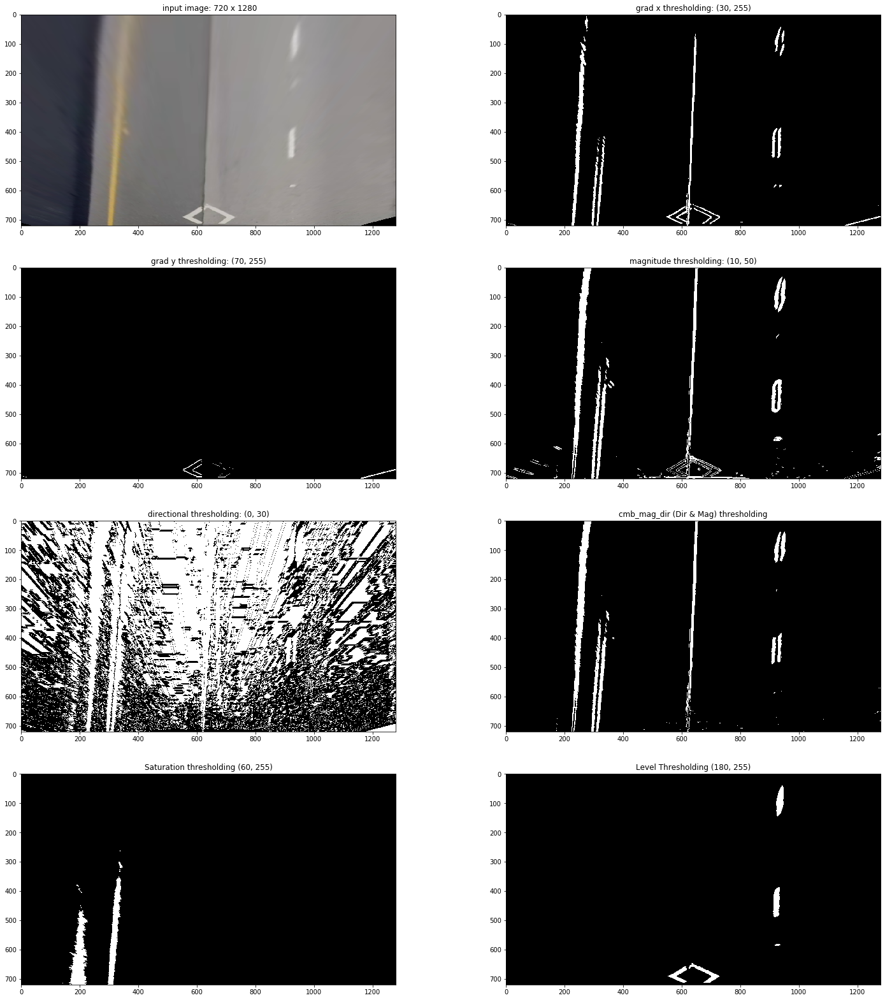

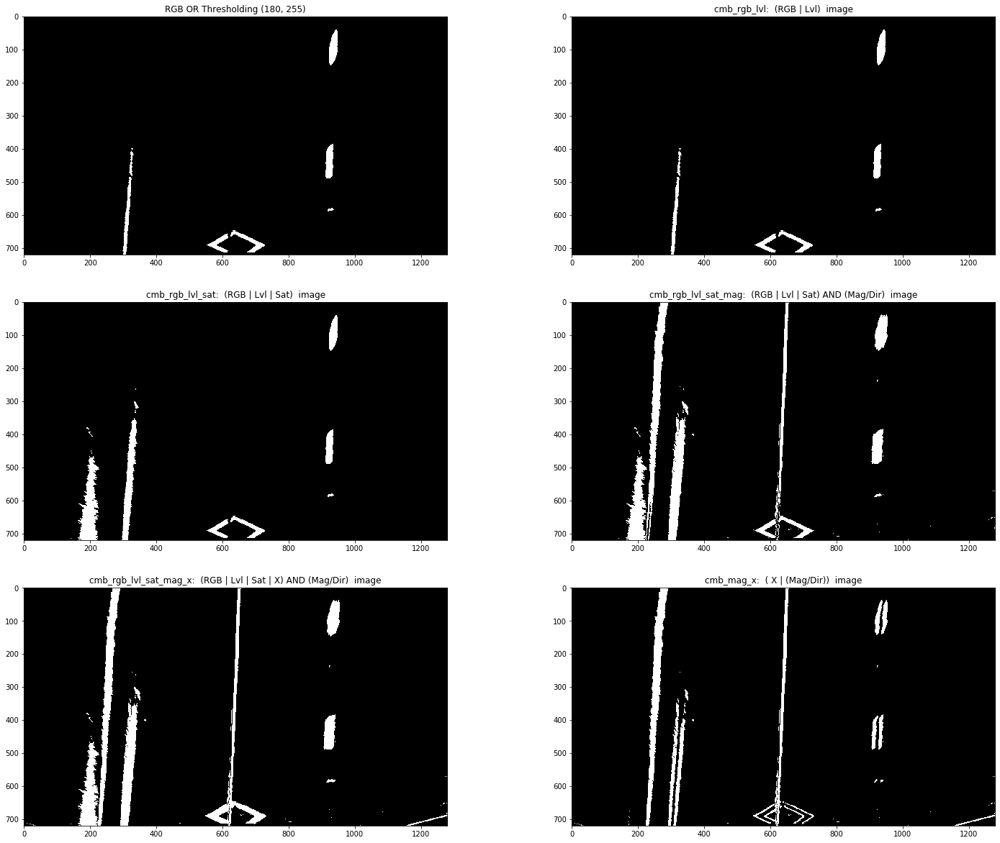

In [79]:
T2 = apply_thresholds(videoPipeline.imgWarped, WarpedNormalThresholds,debug = True)

In [299]:
# display_two(T1,T2)

In [283]:
# imgWarpedAdj = adjust_contrast(imgWarped, alpha = 0.7, beta = 0)
# display_two(imgWarped, imgWarpedAdj)
# display_one(videoPipeline.imgWarped)

## Curvature in Meters calculations

In [57]:
import numpy as np


def generate_data(ym_per_pix, xm_per_pix):
    '''
    Generates fake data to use for calculating lane curvature.
    In your own project, you'll ignore this function and instead
    feed in the output of your lane detection algorithm to
    the lane curvature calculation.
    '''
    # Set random seed number so results are consistent for grader
    # Comment this out if you'd like to see results on different random data!
    np.random.seed(0)
    # Generate some fake data to represent lane-line pixels
    ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
    quadratic_coeff = 3e-4 # arbitrary quadratic coefficient
    # For each y position generate random x position within +/-50 pix
    # of the line base position in each case (x=200 for left, and x=900 for right)
    leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])
    rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                    for y in ploty])

    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y

    # Fit a second order polynomial to pixel positions in each fake lane line
    ##### TO-DO: Fit new polynomials to x,y in world space #####
    ##### Utilize `ym_per_pix` & `xm_per_pix` here #####
    left_fit_cr  = np.polyfit(ploty * ym_per_pix, leftx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, rightx * xm_per_pix, 2)
    left_fit_cr_pxl  = np.polyfit(ploty , leftx , 2)
    right_fit_cr_pxl = np.polyfit(ploty , rightx, 2)    
    return ploty, left_fit_cr, right_fit_cr, left_fit_cr_pxl, right_fit_cr_pxl

def radius_of_curvature(y_eval, fit_coeffs):
    '''
    Calculate curvature using fit coefficients calculated in Meters 
    '''
    A,B,_ = fit_coeffs    
    return  ((1 + ((2*A*y_eval)+B)**2)** 1.5)/np.absolute(2*A)

def radius_of_curvature_meters(y_eval, fit_coeffs):
    MY = 30/720 # meters per pixel in y dimension
    MX= 3.7/700 # meters per pixel in x dimension
    A,B,_ = fit_coeffs   
    A = (A * MX)/ (MY**2)
    B = (B * MX/MY)
    return  ((1 + ((2*A*(y_eval*MY))+B)**2)** 1.5)/np.absolute(2*A)  
    
    
def measure_curvature_real():
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    ploty, left_fit_cr, right_fit_cr, left_fit_pxl, right_fit_pxl = generate_data(ym_per_pix, xm_per_pix)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    left1  = radius_of_curvature(y_eval, left_fit_pxl)
    right1 = radius_of_curvature(y_eval, right_fit_pxl)
    
    left2  = radius_of_curvature_meters(y_eval, left_fit_pxl)
    right2 = radius_of_curvature_meters(y_eval, right_fit_pxl)

    return left_curverad, right_curverad, left1, right1, left2, right2


# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad, left1, right1, left2, right2 = measure_curvature_real()

print(' L    : ', left_curverad, 'm    R     :', right_curverad, 'm')
print(' left1: ', left1, 'm   right1:', right1, 'm')
print(' left2: ', left2, 'm   right2:', right2, 'm')

# Should see values of 533.75 and 648.16 here, if using
# the default `generate_data` function with given seed number

 L    :  533.7525889210923 m    R     : 648.1574851434439 m
 left1:  1625.0601831657184 m   right1: 1976.2967307714246 m
 left2:  533.7525889210929 m   right2: 648.1574851434267 m


## Applying Multiple Thresholds 

In [42]:
# Choose a Sobel kernel size
ksize = 19 # Choose a larger odd number to smooth gradient measurements
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
ksize      = 19
grad_x_thr = (30,110)
grad_y_thr = (30,110)

mag_thr    = (65,255)

theta1     = 45
theta2     = 67
dir_thr    = (theta1, theta2)
sat_thr    = (130,255)

grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  255
grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  255


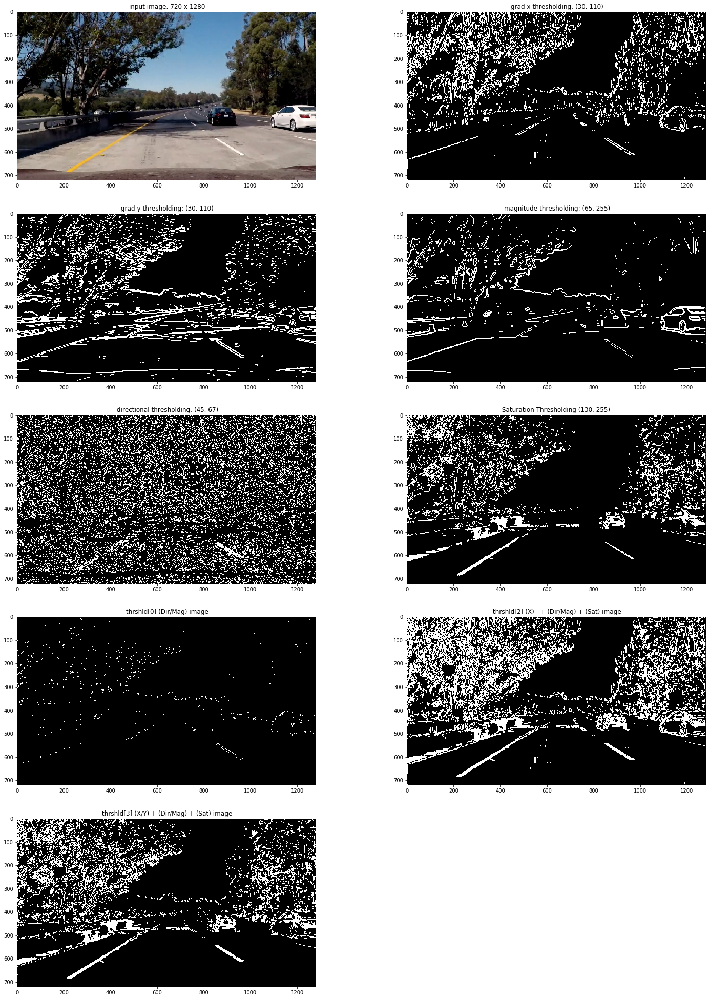

In [43]:
apply_thresholds(image, ksize=ksize, x_thr = grad_x_thr, y_thr = grad_y_thr, 
                        mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, debug = True);

In [ ]:
## STEP 4: Define region of interest and call masking fuction
height, width, _   = image.shape
camera_x           = width //2
camera_y           = height
x_offset_top_left  = 80
x_offset_top_right = 90
y_offset_top       = 350

x_offset_bot_left  = 380
x_offset_bot_right = 440
y_offset_bottom    = image.shape[0]

RoI_vertices_list = [(camera_x - x_offset_bot_left , y_offset_bottom-1), 
                     (camera_x - x_offset_top_left , y_offset_top), 
                     (camera_x + x_offset_top_right, y_offset_top), 
                     (camera_x + x_offset_bot_right, y_offset_bottom-1) ]
RoI_vertices      = np.array([RoI_vertices_list],dtype = np.int32)

imgMasked = region_of_interest(imgCanny, RoI_vertices)


## Read next Frame  and Process

In [ ]:
rc1, image = inVideo.getNextFrame(156)
if not rc1:
    print(' getNextFrame() failed : ',image, ' ending frame: ', inVideo.toFrame, 'curr frame num: ', inVideo.currFrameNum)  
else:    
    print(inVideo.frameTitle,' rc: ', rc1, ' output shape: ', image.shape)
    frame_title = inVideo.frameTitle

### PIPELINE 
imgUndist      = cameraConfig.undistortImage(image)
imgGammaCorr   = adjust_gamma(imgUndist, gamma=2.5)
imgContrastAdj = adjust_contrast(imgUndist, alpha = 1.7, beta = 5)
img_to_process = imgUndist
##----------------------------------------------------------------------------------------------
### Display undistorted color image & perpective transformed image -- With RoI line display
###----------------------------------------------------------------------------------------------
imgRoI   = displayRoILines(img_to_process, RoI_src_vertices_list, thickness = 2)
imgRoIWarped, _, _ = perspectiveTransform(imgRoI, src_points, dst_points, debug = False)
imgRoIWarped = displayRoILines(imgRoIWarped, RoI_dst_vertices_list, thickness = 2, color = 'green')

# display_one(imgRoI  , title = 'imgRoI -'+frame_title, winttl = frame_title, grid = 'major',size=size)
# display_one(imgRoIWarped  , title = 'imgRoIWarped -'+frame_title, winttl = frame_title, grid = 'major', size = size)
# display_two(imgRoI, imgRoIWarped)
debug2 = False
# compare_key = 'cmb_rgb_lvl_sat'
# compare_key = 'cmb_mag_x'
compare_key = 'cmb_rgb_lvl_sat_mag_x'

ksize      = 7
grad_x_thr = (30,255)
grad_y_thr = (70,255)
mag_thr    = (35,255)
dir_thr    = (40,65)
# sat_thr  = (65,255)
sat_thr    = (110,255)
lvl_thr    = (205, 255)
rgb_thr    = (205,255)


print('='*100)
print(' Apply thresholding BEFORE warping - ', frame_title)
print('='*100)      
output1 = apply_thresholds(img_to_process, ksize = ksize, debug = True,
                                       x_thr = grad_x_thr, y_thr = grad_y_thr, mag_thr = mag_thr,  
                                     dir_thr = dir_thr,  sat_thr = sat_thr,    
                                     rgb_thr = rgb_thr,  lvl_thr = lvl_thr)
imgThrshld = output1[compare_key]
imgThrshldWarped, M1, Minv1 = perspectiveTransform(imgThrshld, src_points, dst_points, debug = False)

imgWarped, M2, Minv2 = perspectiveTransform(img_to_process, src_points, dst_points, debug = False)

 Apply thresholding AFTER warping -  Frame: 156   Curr pos(ms): 5205.2


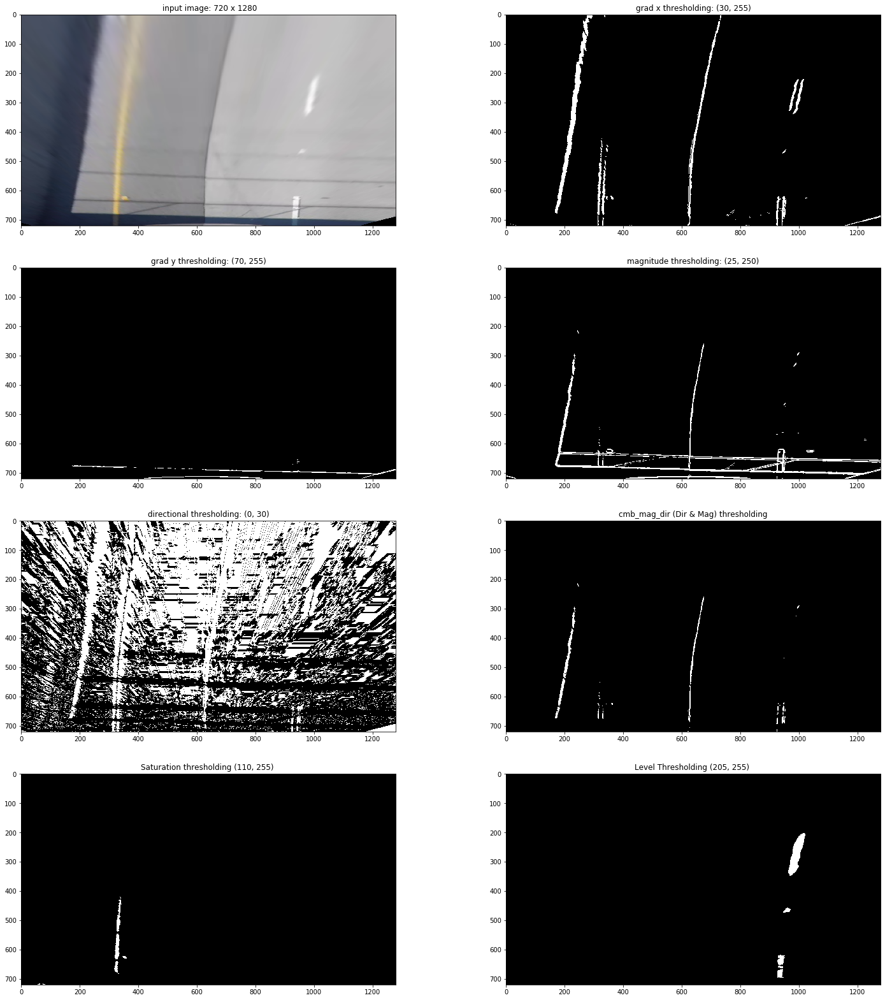

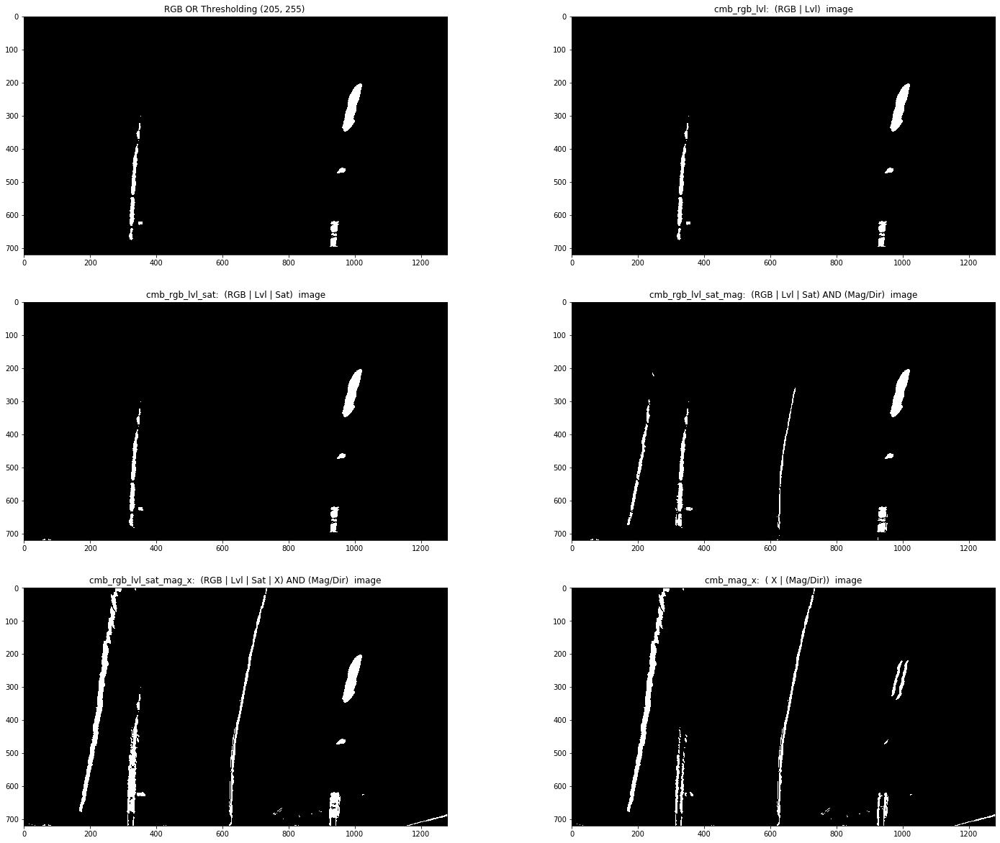

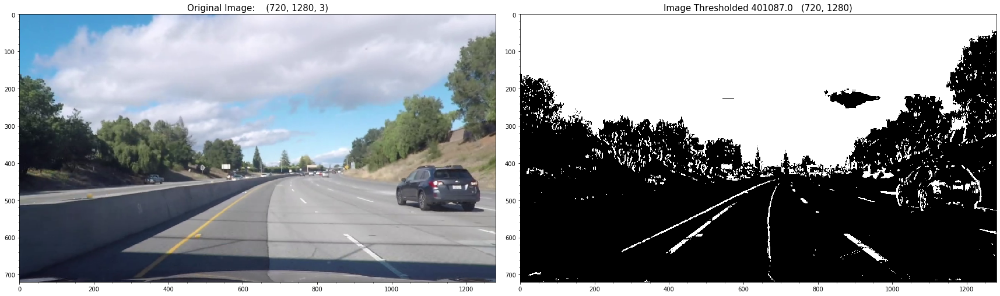

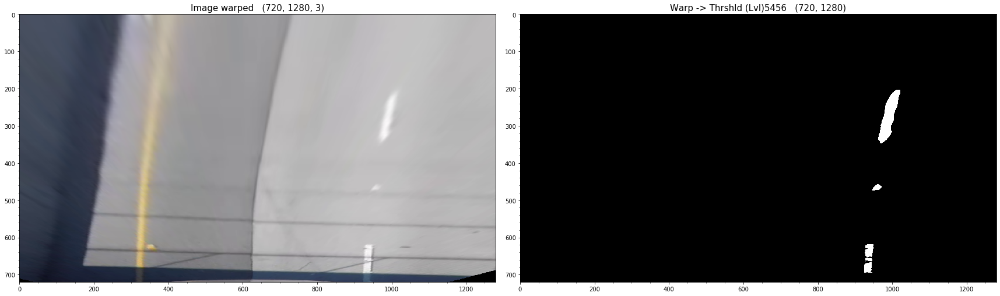

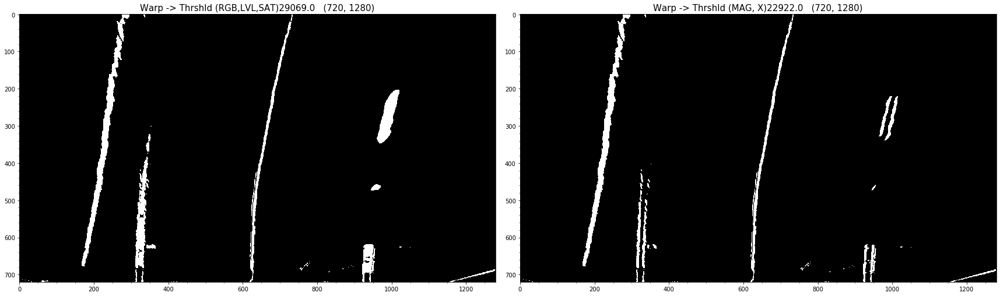

In [1093]:
## Warped Image Threshold params------
ksize_2      = 7
grad_x_thr_2 = (30,255)
grad_y_thr_2 = (70,255)
## Light Conditions ------------
mag_thr_2    = (10,50) 
dir_thr_2    = (0,30)  
## dark conditions--------------
mag_thr_2    = (25,250) 
# dir_thr_2    = (0,20)
#-------------------------------
# sat_thr_2    = (70, 255)
# lvl_thr_2    = (180, 255)
# rgb_thr_2    = (180,255)
sat_thr_2    = (110, 255)
lvl_thr_2    = (205, 255)
rgb_thr_2    = (205,255)
##----------------------------------
print('='*100)
print(' Apply thresholding AFTER warping - ',frame_title)
print('='*100)      

output2  = apply_thresholds(imgWarped, ksize = ksize_2, debug = True,
                                              x_thr = grad_x_thr_2, y_thr = grad_y_thr_2, sat_thr = sat_thr_2, 
                                            mag_thr = mag_thr_2, dir_thr = dir_thr_2,  
                                            rgb_thr = rgb_thr_2, lvl_thr = lvl_thr_2 )

imgWarpedThrshld     = output2[compare_key]
imgWarpedThrshldLvl  = output2['cmb_lvl'] 
imgWarpedThrshldSat  = output2['cmb_sat'] 
imgWarpedThrshldDark = output2['cmb_mag_x']


# display_two(image, imgUndist)
# display_two(imgGammaCorr, imgContrastAdj)
ttlT   = np.sum(imgThrshld)
ttlWTS = np.sum(imgWarpedThrshldSat)
ttlWTL = np.sum(imgWarpedThrshldLvl)
ttlWT  = np.sum(imgWarpedThrshld)
ttlWTD = np.sum(imgWarpedThrshldDark)
display_two(imgUndist,  imgThrshld, title2 =  'Image Thresholded '+str(ttlT))
display_two(imgWarped, imgWarpedThrshldLvl, title1 = 'Image warped', title2 = 'Warp -> Thrshld (Lvl)'+str(ttlWTL))
display_two(imgWarpedThrshld, imgWarpedThrshldDark, title1 = 'Warp -> Thrshld (RGB,LVL,SAT)'+str(ttlWT), title2 = 'Warp -> Thrshld (MAG, X)'+str(ttlWTD))

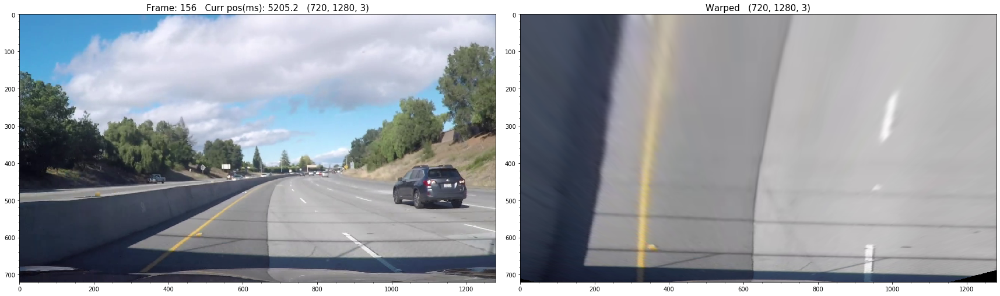

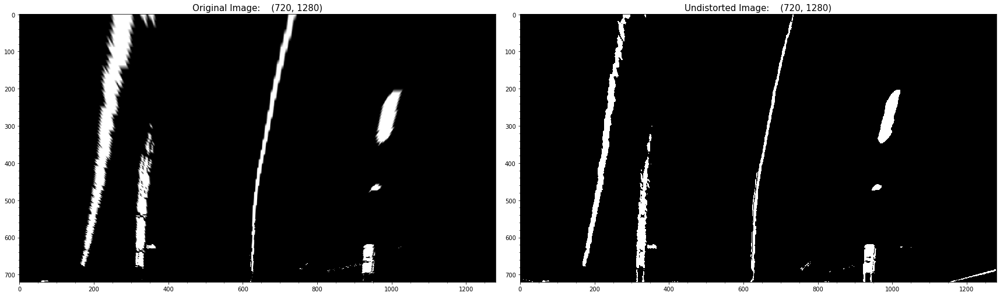

In [1089]:
display_two(image, imgWarped,  title1 = frame_title, title2 = 'Warped')

display_two(imgThrshldWarped, imgWarpedThrshld)

In [1025]:
# debug2 = True
# # try_image = imgGammaCorr
# try_image = imgContrastAdj
# print('='*100)
# print(' Apply thresholding BEFORE warping')
# print('='*100)      
# imgThrshld = apply_thresholds(try_image, ret = 'cmb_rgb_lvl_sat', ksize = ksize, debug = debug2,
#                                        x_thr = grad_x_thr, y_thr = grad_y_thr, mag_thr = mag_thr,  
#                                      dir_thr = dir_thr,  sat_thr = sat_thr,    
#                                      rgb_thr = rgb_thr,  lvl_thr = lvl_thr)

# imgThrshldWarped, M1, Minv1 = perspectiveTransform(imgThrshld, src_points, dst_points, debug = False)

# imgWarped, M2, Minv2 = perspectiveTransform(try_image, src_points, dst_points, debug = False)
# print('='*100)
# print(' Apply thresholding AFTER warping')
# print('='*100)      
# imgWarpedThrshld  = apply_thresholds(imgWarped, ret = 'cmb_rgb_lvl_sat', ksize = ksize_2, debug = debug2,
#                                               x_thr = grad_x_thr_2, y_thr = grad_y_thr_2, 
#                                             mag_thr = mag_thr_2, dir_thr = dir_thr_2, sat_thr = sat_thr_2, 
#                                             rgb_thr = rgb_thr_2, lvl_thr = lvl_thr_2 )

## Image info

In [471]:
# Hue = imgWarpedHLS[:,:,0]
# Lvl = imgWarpedHLS[:,:,1]
# Sat = imgWarpedHLS[:,:,2]
# Red = imgWarped[:,:,0]
# Grn = imgWarped[:,:,1]
# Blu = imgWarped[:,:,2]
# print(' Hue       :  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Hue.shape, Hue.min(),Hue.max(), Hue.mean(), np.median(Hue)))
# print(' Level     :  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Lvl.shape, Lvl.min(),Lvl.max(), Lvl.mean(), np.median(Lvl)))
# print(' Saturation:  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Sat.shape, Sat.min(),Sat.max(), Sat.mean(), np.median(Sat)))
# print(' Red       :  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Red.shape, Red.min(),Red.max(), Red.mean(), np.median(Red)))
# print(' Green     :  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Gen.shape, Grn.min(),Grn.max(), Grn.mean(), np.median(Grn)))
# print(' Blue      :  Shape: {}    Min: {}   Max: {}   Avg:{}  Median: {}'.format(Blu.shape, Blu.min(),Blu.max(), Blu.mean(), np.median(Blu)))

 Undist RGB Mean: 106.54  Warped RGBMean: 110.14 
 Normal Conditions is  True  use threshold result: cmb_mag_x


In [195]:

RGBMean = np.ndarray((0,3))
HLSMean = np.ndarray((0,3))
print(HLSMean.shape)

(0, 3)


In [349]:

inVideo.setNextFrame(0)
print(inVideo.fromFrame, inVideo.toFrame)

 Next frame to read set to :  0.0
 Frame range starting from:  0  ending at frame:  484
 self.rangeFinished :  484  Next frame:  0.0  ... Make sure pipeline is RESET
0 484


In [350]:
rc1, image = inVideo.getNextFrame()

In [354]:
print(' '+inVideo.frameTitle)
imgUndist       = cameraConfig.undistortImage(image)
imgUndistHLS = cv2.cvtColor(imgUndist, cv2.COLOR_RGB2HLS)
imgWarped, _, _ = perspectiveTransform(imgUndist, src_points, dst_points, debug = False)
imgWarpedHLS = cv2.cvtColor(imgWarped, cv2.COLOR_RGB2HLS)
print()
print(' image mean       : ', image.mean())
print(' imgUndist min    : ', imgUndist.min())
print(' imgUndist max    : ', imgUndist.max())
print(' imgUndist pctl   : ', np.percentile(imgUndist, [25,50,75]))

print()
print(' image mean       : ', image.mean(axis=(0,1)))
print()
print(' imgUndist mean   : ', imgUndist.mean(axis=  (0,1)))
print(' imgUndist min    : ', imgUndist.min(axis = (0,1)))
print(' imgUndist max    : ', imgUndist.max(axis = (0,1)))
print(' imgUndist pctl   : ', np.percentile(imgUndist, [25,50,75], axis = (0,1)))
print(' imgUndist pctl   : ', np.percentile(imgUndist[:,:,0], [25,50,75]))
print(' imgUndist pctl   : ', np.percentile(imgUndist[:,:,1], [25,50,75]))
print(' imgUndist pctl   : ', np.percentile(imgUndist[:,:,2], [25,50,75]))
# print(' imgUndistHLS mean: ', imgUndistHLS.mean(axis=  (0,1)))
# print(' imgUndistHLS min : ', imgUndistHLS.min(axis=  (0,1)))
# print(' imgUndistHLS max : ', imgUndistHLS.max(axis=  (0,1)))

print()
print(' imgWarped mean   : ', imgWarped.mean(axis=  (0,1)))
print(' imgWarped mean   : ', imgWarped.min(axis=  (0,1)))
print(' imgWarped mean   : ', imgWarped.max(axis=  (0,1)))
print(' imgWarped pctl   : ', np.percentile(imgWarped, [25,50,75], axis = (0,1)))
# print(' imgWarpedHLS mean: ', imgWarpedHLS.mean(axis=(0,1)))
# print(' imgWarpedHLS min : ', imgWarpedHLS.min(axis=(0,1)))
# print(' imgWarpedHLS max : ', imgWarpedHLS.max(axis=(0,1)))

 Frame: 0   Curr pos(ms): 0.0

 image mean       :  123.4318580005787
 imgUndist min    :  0
 imgUndist max    :  254
 imgUndist pctl   :  [   76.0000   140.0000   168.0000]

 image mean       :  [  115.2495   123.0871   131.9590]

 imgUndist mean   :  [  116.7659   124.2983   132.5376]
 imgUndist min    :  [         0          2          5]
 imgUndist max    :  [       254        253        248]
 imgUndist pctl   :  [[   69.0000    88.0000    81.0000]
 [  133.0000   140.0000   146.0000]
 [  159.0000   163.0000   181.0000]]
 imgUndist pctl   :  [   69.0000   133.0000   159.0000]
 imgUndist pctl   :  [   88.0000   140.0000   163.0000]
 imgUndist pctl   :  [   81.0000   146.0000   181.0000]

 imgWarped mean   :  [  144.4067   139.9519   137.3028]
 imgWarped mean   :  [         0          0          0]
 imgWarped mean   :  [       223        221        220]
 imgWarped pctl   :  [[  137.0000   132.0000   130.0000]
 [  148.0000   143.0000   142.0000]
 [  154.0000   150.0000   147.0000]]


In [200]:
HLSMean = np.vstack((HLSMean, imgWarpedHLS.mean(axis=(0,1))))
RGBMean = np.vstack((RGBMean, imgWarped.mean(axis=(0,1))))
print(image.mean(axis=(0,1)).shape)
print(imgWarpedHLS.mean(axis=(0,1)).shape)

Frame: 1   Curr pos(ms): 33.37
[   43.7440   140.9118     8.7379]
[  115.2320   122.9480   131.8762]
(3,)
(3,)


In [202]:
print(HLSMean.shape, HLSMean)
print()
print(RGBMean.shape, RGBMean)

(2, 3) [[   38.1150   140.7954     8.8722]
 [   43.7440   140.9118     8.7379]]

(2, 3) [[  144.4067   139.9519   137.3028]
 [  144.4532   139.9328   137.5369]]


In [249]:
import time
del plots

NameError: name 'plots' is not defined

In [398]:
del saveInfo
del saveInfoV2
del init_plots_dict
# del plots_dict

In [421]:
def plot_curves_for_one_class(class_data, class_id, class_name, scores,  
                                            ax = None , legend = 'upper right', 
                                            min_x = 0.0, max_x = 500, 
                                            min_y = 0.0, max_y = 260, 
                                              y_line = 115, labels = None):
    if ax is None:
        plt.figure(figsize=(15,7))
        ax = plt.gca()

    # for idx, score_key in enumerate(sorted(class_data)):
    for idx, (score_key, score_label) in enumerate(zip(scores, labels)):
        # if  scores is not None and score_key not in  scores:
            # continue        
#         print('score_key is: {:20s}  len: {:10.4f}'.format(score_key, len(class_data[class_id][score_key])))
        label      = '{:15s} Mean Value: {:6.2f}'.format(score_label, np.mean(class_data[class_id][score_key]))
        
        score_idx  = scores.index(score_key)
        # print('idx: ', idx, ' Score_key: ' , score_key, 'Score Index: ' , score_idx, 'color:', SCORE_COLORS[score_key])
        
        #### ax = plot_pr_curve(precisions, recalls, label= label, color=COLORS[idx*2], ax=ax)
        ax.plot(class_data[class_id][score_key], label=label) ### ,  color=SCORE_COLORS[score_key])

    avg_mean = np.mean(class_data[class_id]['Avg'])
    ax.set_title(' {} mean value: {:7.3f}  '.format(class_name, avg_mean), fontsize=14)
    ax.set_xlabel('Frame', fontsize= 12)
    ax.set_ylabel('Value', fontsize= 12)
    ax.tick_params(axis='both', labelsize = 16)
    ax.set_xlim([min_x,max_x])
    ax.set_ylim([min_y,max_y])
    leg = plt.legend(loc=legend,frameon=True, fontsize = 12, markerscale = 6)
    leg.set_title('IoU Thr {:.2f}'.format(12),prop={'size':11})
                  
    for xval in np.linspace(min_x, max_x, 11):
        plt.vlines(xval, min_y, max_y, color='gray', alpha=0.3, linestyles='dashed', linewidth=2)   
    for yval in [y_line]: ## np.linspace(105, 125, 5):
        print(yval)
        plt.hlines(yval, min_x, max_x, color='red', alpha=0.5, linestyles='dashed', linewidth=1)    
    plt.hlines(int(avg_mean), min_x, max_x, color='black', alpha=0.5, linestyles='dashed', linewidth=1)    
    return 

In [417]:
def plot_mAP_by_scores(all_data, scores = None, class_ids = None,  class_names = None, 
                        columns=   2 , iou = 0.5, legend = 'upper right',  labels = None, 
                        min_x  = 0.0 , max_x = 1.05, 
                        min_y  = 0.0 , max_y = 1.05,
                        size_x =   8 , size_y = 6):
    
    if class_ids is None:
        disp_classes = all_data.keys()
    else:
        disp_classes = class_ids
        
    if scores is None:
        disp_scores  = [ 'mrcnn_score_orig' , 'mrcnn_score_norm', 'mrcnn_score_0', 'mrcnn_score_1', 'mrcnn_score_2', 'fcn_score_0', 'fcn_score_1', 'fcn_score_2']
    else:
        disp_scores   = scores

    if labels is None:
        disp_labels = disp_scores
    else:
        disp_labels = labels
        
    all_precs = {}
    all_mAPs  = {}
    
    num_disp_classes = len(disp_classes)
    columns = min(columns, num_disp_classes)
    rows    = math.ceil(num_disp_classes/columns)
    print('col/rows: ', columns, rows)
    fig = plt.figure(figsize=(size_x *columns, size_y * rows))


    for idx, class_id in enumerate(disp_classes):
        row = idx // columns
        col = idx  % columns
        subplot = (row * columns) + col +1
        ax= fig.add_subplot(rows, columns, subplot)
        
        class_precs = plot_pr_curves_by_scores_for_one_class(all_data[class_id], class_id, class_names[class_id], 
                                scores = disp_scores, iou = iou, ax = ax, legend = legend,
                                min_x = min_x, max_x = max_x, 
                                min_y = min_y, max_y = max_y, 
                                labels = disp_labels)    
        all_precs[class_id] = class_precs
        # ax.autoscale_view()
        
    ## Print Summary 
    ttl = ' AP @ IoU {:.2f} Thresholds for Computed Scores '.format(iou)
    ttl_scores = ''.join([" {:>17s}".format(scr)  for scr in disp_scores])
    print()
    print('{:^150}'.format(ttl))
    print()
    print('{:-^150}'.format('  scores  '))
    print('{:2s} - {:17s} {}'.format('Id','ClassName',ttl_scores))
    print('{:-^150}'.format(''))
    for cls in disp_classes:
        if cls == 0:
            continue
        scores = ''.join([" {:>17.2%}".format(all_precs[cls][scr])  for scr in disp_scores])
        print('{:2d} - {:17s} {} '.format(cls , class_names[cls], scores ))

    ## print average of each score
    if len(disp_classes) > 1:
        for scr in disp_scores:
            all_mAPs[scr] = np.mean([float('{:6.4f}'.format(all_precs[cls][scr])) for cls in all_precs if cls != 0])

        #         print('scr', scr, 'map:', mAP[scr], np.mean(mAP[scr]))
        # print('{:-^170}'.format(''))  
        print()
        scores = ''.join([" {:>17.2%}".format(all_mAPs[scr])  for scr in disp_scores])
        print('{:22s} {} '.format(' average for score.', scores ))
        print('{:-^150}'.format(''))
    
    ## print mAP calculated across all detections
    if 0 in all_precs:
        scores = ''.join([" {:>17.2%}".format(all_precs[0][scr]) for scr in disp_scores])
        print('{:22s} {}'.format( class_names[0], scores))
        print('{:-^150}'.format(''))  


        
    plt.subplots_adjust(top=0.98, bottom=0.02, left=0.02, right=0.98, hspace=0.35, wspace=0.15)   
    plt.show()         
    

In [402]:
def saveInfo(plots_dict, key, data):
    pcntl = np.percentile(data,[25, 50, 75] )
    plots_dict[key]['Min'].append(data.min())
    plots_dict[key]['Max'].append(data.max())
    plots_dict[key]['Avg'].append(data.mean())
    plots_dict[key]['25p'].append(pcntl[0])
    plots_dict[key]['50p'].append(pcntl[1])
    plots_dict[key]['75p'].append(pcntl[2])
    return

In [403]:
def saveInfoV1(plots_dict, key, data):
    pcntl = np.percentile(data,[25, 50, 75])
    min_data = data.min()
    max_data = data.max()
    avg_data = data.mean()
    plots_dict[key]['Min'].append(min_data)
    plots_dict[key]['Max'].append(max_data)
    plots_dict[key]['Avg'].append(avg_data)
    plots_dict[key]['25p'].append(pcntl[0])
    plots_dict[key]['50p'].append(pcntl[1])
    plots_dict[key]['75p'].append(pcntl[2])
        
def saveInfoV2(plots_dict, keys, data):
    pcntl = np.percentile(data,[25, 50, 75], axis = (0,1) )
    min_data = data.min(axis=(0,1))
    max_data = data.max(axis=(0,1))
    avg_data = data.mean(axis=(0,1))
#     print(min_data, '  ', max_data, '  ', avg_data)
#     print(type(plots_undist_v2), type(plots_undist_v2['Red']), type(plots_undist_v2['Red']['Min']))
    
    for i,key in enumerate(keys):
#         print('i:',i, 'j:', j,' keys: ', keys, min_data[i], max_data[i], avg_data[i], type(plots_dict[j]), type(plots_dict[j]['Min']))
        plots_dict[key]['Min'].append(min_data[i])
        plots_dict[key]['Max'].append(max_data[i])
        plots_dict[key]['Avg'].append(avg_data[i])
        plots_dict[key]['25p'].append(pcntl[0,i])
        plots_dict[key]['50p'].append(pcntl[1,i])
        plots_dict[key]['75p'].append(pcntl[2,i])

In [404]:
def init_plots_dict():
    plots_dict = {}
    for key1 in ['Hue', 'Lvl', 'Sat', 'Red', 'Grn', 'Blu', 'RGB']:
        plots_dict.setdefault(key1, {})
        for key2 in ['Min', 'Max', 'Avg', '25p', '50p', '75p']:
            plots_dict[key1].setdefault(key2, [])

            
#     for i in plots_dict.keys():
#         print(i)
    return plots_dict

In [357]:
inVideo.close()
# inVideo.setNextFrame(100)
# print(inVideo.)
inVideo = VideoFile(sampleVideos[0], mode = 'input', fromFrame = 0)

 input video file closed

 VideoFile init() routine
 ------------------------
 input args:  {'fromFrame': 0}

 Information on : .\challenge_video.mp4
 ---------------------------------------
 Width     :  1280.0  Height  :  720.0  Frame Rate:  29.97  Codec     :  828601953.0  Ttl number of frames:  484.0
 Next_frame:  0.0  time(ms):  0.0
 FromFrame :  0    toFrame :  484    ttlFrames:  484
 Next frame to read set to :  0.0
 Frame range starting from:  0  ending at frame:  484
 self.rangeFinished :  484  Next frame:  0.0  ... Make sure pipeline is RESET
 openVideoFile complete  .\challenge_video.mp4
 videoFile _init() complete  .\challenge_video.mp4


###  Method 1

In [362]:
inVideo.setNextFrame(0)
inVideo.toFrame = inVideo.ttlFrames
print(inVideo.fromFrame, inVideo.toFrame)

 Next frame to read set to :  0.0
 Frame range starting from:  0  ending at frame:  484
 self.rangeFinished :  484  Next frame:  0.0  ... Make sure pipeline is RESET
0 484


In [363]:
st0 = time.time()
plots_undist_v2 = init_plots_dict()
plots_warped_v2 = init_plots_dict()
HLS_key = ['Hue', 'Lvl', 'Sat']
RGB_key = ['Red', 'Grn', 'Blu']
end0 = time.time()
delta0 = end0- st0
print('{:8.6f}'.format(delta0))

0.000000


In [364]:
start1 = time.time()
rc1, image = inVideo.getNextFrame()

while rc1:

    imgUndist       = cameraConfig.undistortImage(image)
    imgUndistHLS = cv2.cvtColor(imgUndist, cv2.COLOR_RGB2HLS)

    imgWarped, _, _ = perspectiveTransform(imgUndist, src_points, dst_points, debug = False)
    imgWarpedHLS = cv2.cvtColor(imgWarped, cv2.COLOR_RGB2HLS)
    
    saveInfoV1(plots_undist_v2, 'RGB', imgUndist)    
    saveInfoV2(plots_undist_v2, RGB_key, imgUndist)
    saveInfoV2(plots_undist_v2, HLS_key, imgUndistHLS)

    saveInfoV1(plots_warped_v2, 'RGB', imgWarped)
    saveInfoV2(plots_warped_v2, RGB_key, imgWarped)
    saveInfoV2(plots_warped_v2, HLS_key, imgWarpedHLS)
    if inVideo.currFrameNum % 10 == 0 :
        print(inVideo.frameTitle,' rc: ', rc1)
    rc1, image = inVideo.getNextFrame()
else:    
    end1 = time.time()
    print(' getNextFrame() failed : ',image, ' ending frame: ', inVideo.toFrame, 'curr frame num: ', inVideo.currFrameNum)  
delta1 = end1 - start1

print('took {:10.5f} seconds '.format(delta1))

Frame: 0   Curr pos(ms): 0.0  rc:  True
Frame: 10   Curr pos(ms): 333.67  rc:  True
Frame: 20   Curr pos(ms): 667.33  rc:  True
Frame: 30   Curr pos(ms): 1001.0  rc:  True
Frame: 40   Curr pos(ms): 1334.67  rc:  True
Frame: 50   Curr pos(ms): 1668.33  rc:  True
Frame: 60   Curr pos(ms): 2002.0  rc:  True
Frame: 70   Curr pos(ms): 2335.67  rc:  True
Frame: 80   Curr pos(ms): 2669.33  rc:  True
Frame: 90   Curr pos(ms): 3003.0  rc:  True
Frame: 100   Curr pos(ms): 3336.67  rc:  True
Frame: 110   Curr pos(ms): 3670.33  rc:  True
Frame: 120   Curr pos(ms): 4004.0  rc:  True
Frame: 130   Curr pos(ms): 4337.67  rc:  True
Frame: 140   Curr pos(ms): 4671.33  rc:  True
Frame: 150   Curr pos(ms): 5005.0  rc:  True
Frame: 160   Curr pos(ms): 5338.67  rc:  True
Frame: 170   Curr pos(ms): 5672.33  rc:  True
Frame: 180   Curr pos(ms): 6006.0  rc:  True
Frame: 190   Curr pos(ms): 6339.67  rc:  True
Frame: 200   Curr pos(ms): 6673.33  rc:  True
Frame: 210   Curr pos(ms): 7007.0  rc:  True
Frame: 220  

###  Method 2

In [342]:
inVideo.setNextFrame(0)
print(inVideo.fromFrame, inVideo.toFrame)

 Next frame to read set to :  0.0
 Frame range starting from:  0  ending at frame:  484
 self.rangeFinished :  484  Next frame:  0.0  ... Make sure pipeline is RESET
0 484


In [ ]:
# plots_undist = init_plots_dict()
# plots_warped = init_plots_dict()

In [343]:
start2 = time.time()
rc1, image = inVideo.getNextFrame()

while rc1:

    imgUndist       = cameraConfig.undistortImage(image)
    imgUndistHLS = cv2.cvtColor(imgUndist, cv2.COLOR_RGB2HLS)

    imgWarped, _, _ = perspectiveTransform(imgUndist, src_points, dst_points, debug = False)
    imgWarpedHLS = cv2.cvtColor(imgWarped, cv2.COLOR_RGB2HLS)
 
    
    for i,j in enumerate(HLS_key):
        saveInfo(plots_undist, j, imgUndistHLS[:,:,i])

    for i,j in enumerate(RGB_key):
        saveInfo(plots_undist, j, imgUndist[:,:,i])

    for i,j in enumerate(HLS_key):
        saveInfo(plots_warped, j, imgWarpedHLS[:,:,i])

    for i,j in enumerate(RGB_key):
        saveInfo(plots_warped, j, imgWarped[:,:,i])

    if inVideo.currFrameNum % 10 == 0 :
        print(inVideo.frameTitle,' rc: ', rc1)
    rc1, image = inVideo.getNextFrame()
else:    
    end2 = time.time()
    print(' getNextFrame() failed : ',image, ' ending frame: ', inVideo.toFrame, 'curr frame num: ', inVideo.currFrameNum)  
delta2 = end2 - start2

print('took {:10.5f} seconds '.format(delta1))

Frame: 0   Curr pos(ms): 0.0  rc:  True
Frame: 10   Curr pos(ms): 333.67  rc:  True
Frame: 20   Curr pos(ms): 667.33  rc:  True
Frame: 30   Curr pos(ms): 1001.0  rc:  True
Frame: 40   Curr pos(ms): 1334.67  rc:  True
Frame: 50   Curr pos(ms): 1668.33  rc:  True
Frame: 60   Curr pos(ms): 2002.0  rc:  True
Frame: 70   Curr pos(ms): 2335.67  rc:  True
Frame: 80   Curr pos(ms): 2669.33  rc:  True
Frame: 90   Curr pos(ms): 3003.0  rc:  True
Frame: 100   Curr pos(ms): 3336.67  rc:  True
Frame: 110   Curr pos(ms): 3670.33  rc:  True
Frame: 120   Curr pos(ms): 4004.0  rc:  True
Frame: 130   Curr pos(ms): 4337.67  rc:  True
Frame: 140   Curr pos(ms): 4671.33  rc:  True
Frame: 150   Curr pos(ms): 5005.0  rc:  True
Frame: 160   Curr pos(ms): 5338.67  rc:  True
Frame: 170   Curr pos(ms): 5672.33  rc:  True
Frame: 180   Curr pos(ms): 6006.0  rc:  True
Frame: 190   Curr pos(ms): 6339.67  rc:  True
Frame: 200   Curr pos(ms): 6673.33  rc:  True
Frame: 210   Curr pos(ms): 7007.0  rc:  True
Frame: 220  

In [345]:
for key1 in ['Hue', 'Lvl', 'Sat', 'Red', 'Grn', 'Blu', 'RGB']:
    for key2 in ['Min', 'Max', 'Avg', '25p', '50p', '75p']:            
        print(key1, key2 , plots_undist[key1][key2] ==  plots_undist_v2[key1][key2])
print()
print('=='*30)
print('Warped')
print('=='*30)
for key1 in ['Hue', 'Lvl', 'Sat', 'Red', 'Grn', 'Blu', 'RGB']:
    for key2 in ['Min', 'Max', 'Avg', '25p', '50p', '75p']:            
        print(key1, key2 , plots_warped[key1][key2] ==  plots_warped_v2[key1][key2])


Hue Min True
Hue Max True
Hue Avg True
Hue 25p True
Hue 50p True
Hue 75p True
Lvl Min True
Lvl Max True
Lvl Avg True
Lvl 25p True
Lvl 50p True
Lvl 75p True
Sat Min True
Sat Max True
Sat Avg True
Sat 25p True
Sat 50p True
Sat 75p True
Red Min True
Red Max True
Red Avg True
Red 25p True
Red 50p True
Red 75p True
Grn Min True
Grn Max True
Grn Avg True
Grn 25p True
Grn 50p True
Grn 75p True
Blu Min True
Blu Max True
Blu Avg True
Blu 25p True
Blu 50p True
Blu 75p True

Warped
Hue Min True
Hue Max True
Hue Avg True
Hue 25p True
Hue 50p True
Hue 75p True
Lvl Min True
Lvl Max True
Lvl Avg True
Lvl 25p True
Lvl 50p True
Lvl 75p True
Sat Min True
Sat Max True
Sat Avg True
Sat 25p True
Sat 50p True
Sat 75p True
Red Min True
Red Max True
Red Avg True
Red 25p True
Red 50p True
Red 75p True
Grn Min True
Grn Max True
Grn Avg True
Grn 25p True
Grn 50p True
Grn 75p True
Blu Min True
Blu Max True
Blu Avg True
Blu 25p True
Blu 50p True
Blu 75p True


### Plot Distortion Corrected Image Stats

115
115
115
115
115
115
115


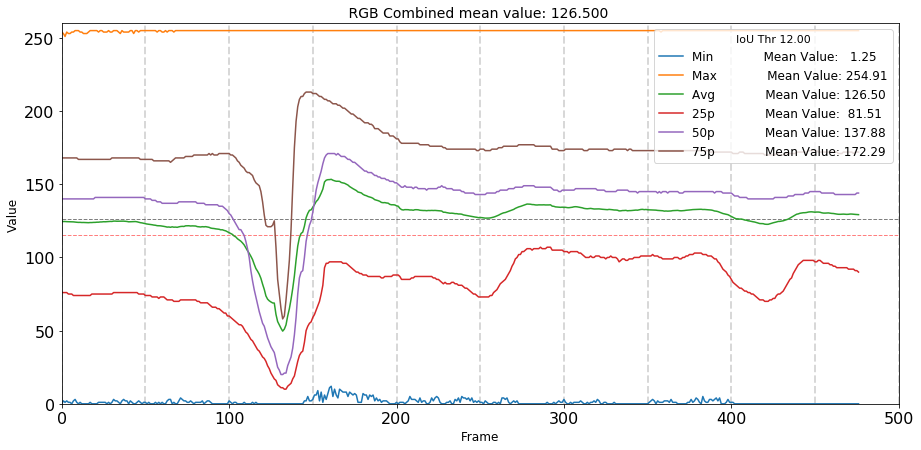

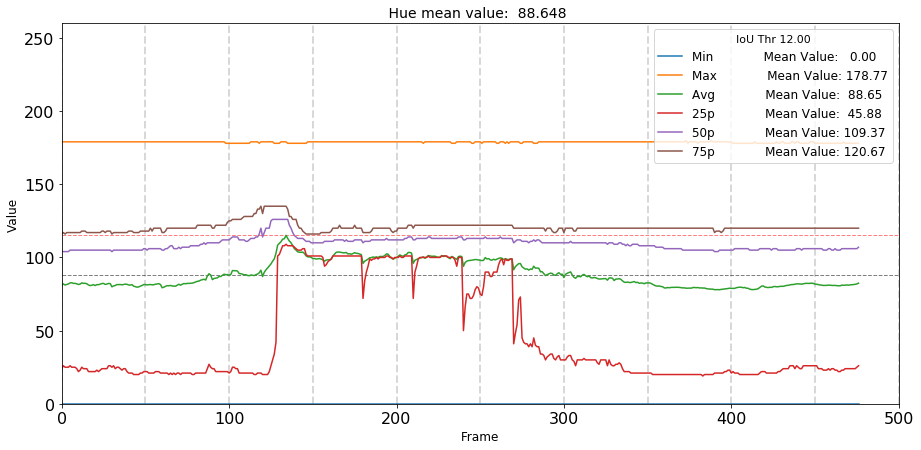

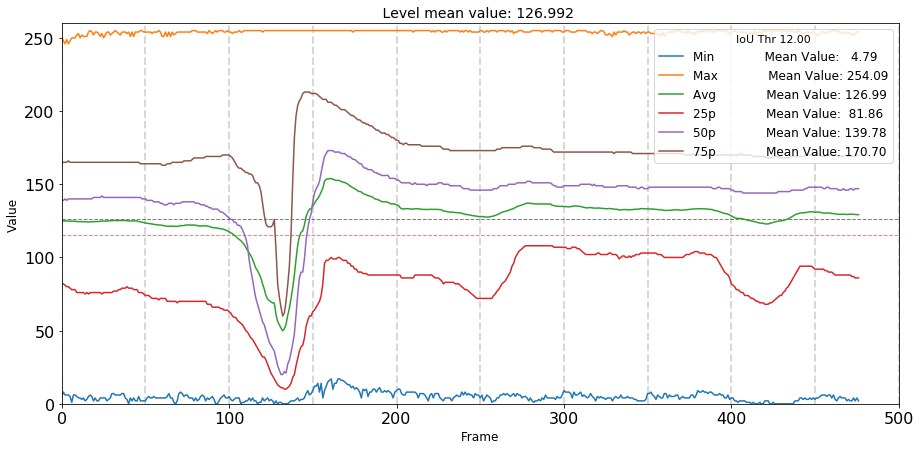

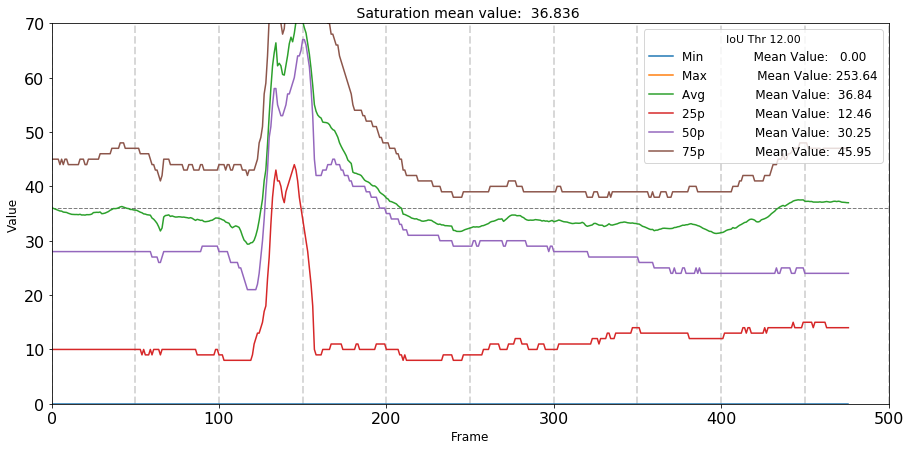

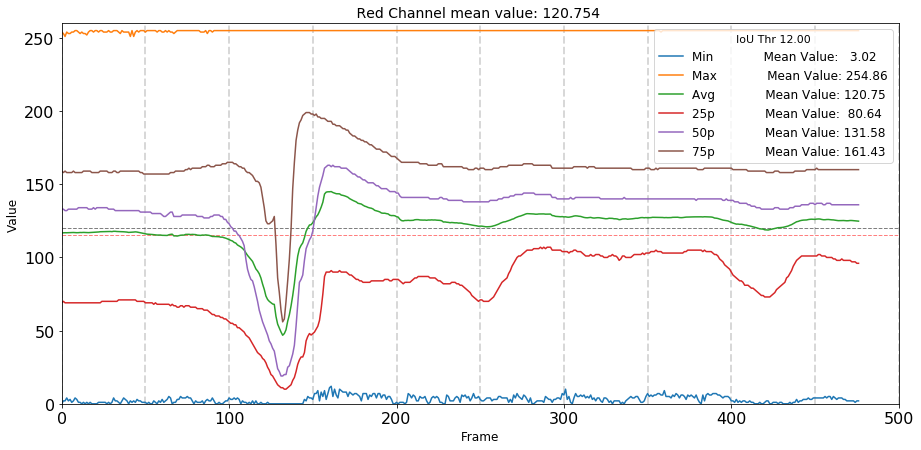

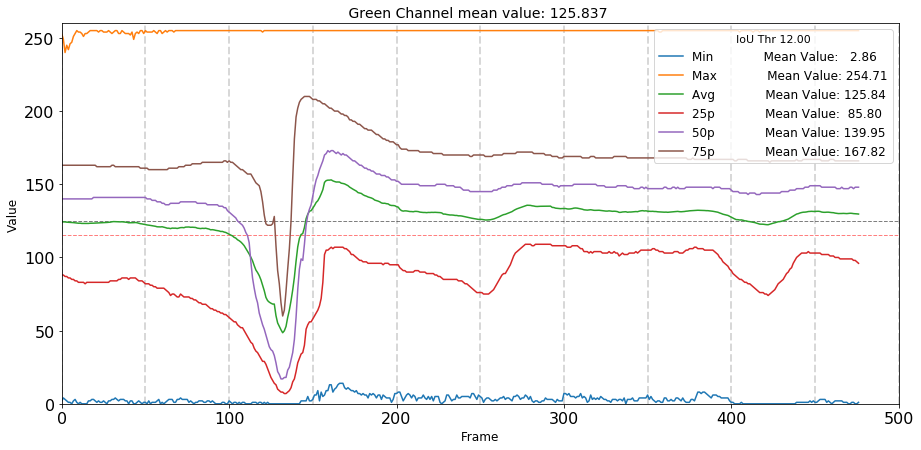

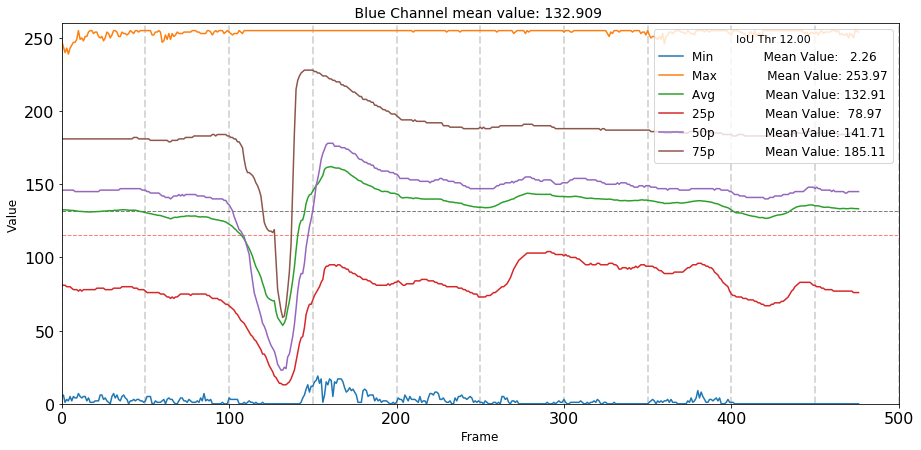

In [422]:
plots = plots_undist_v2
key2 = ['Min', 'Max', 'Avg', '25p', '50p', '75p']
labels = ['Min', 'Max', 'Avg', '25p', '50p', '75p']
plot_curves_for_one_class(plots, 'RGB', 'RGB Combined', key2, labels = labels)
plot_curves_for_one_class(plots, 'Hue', 'Hue', key2, labels = labels)
plot_curves_for_one_class(plots, 'Lvl', 'Level', key2, labels = labels)
plot_curves_for_one_class(plots, 'Sat', 'Saturation', key2, labels = labels, max_y = 70)
plot_curves_for_one_class(plots, 'Red', 'Red Channel', key2, labels = labels)
plot_curves_for_one_class(plots, 'Grn', 'Green Channel', key2, labels = labels)
plot_curves_for_one_class(plots, 'Blu', 'Blue Channel', key2, labels = labels)

### Plot Distortion Corrected & Warped Image Stats

115
115
115
115
115
115
115


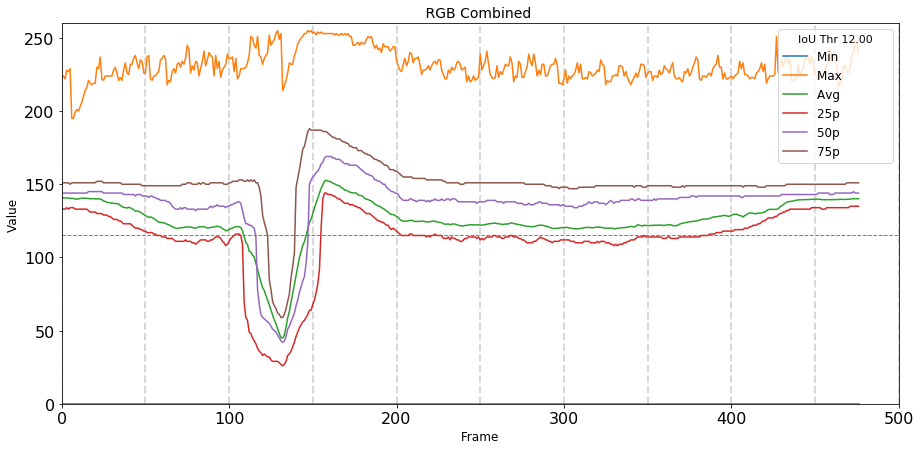

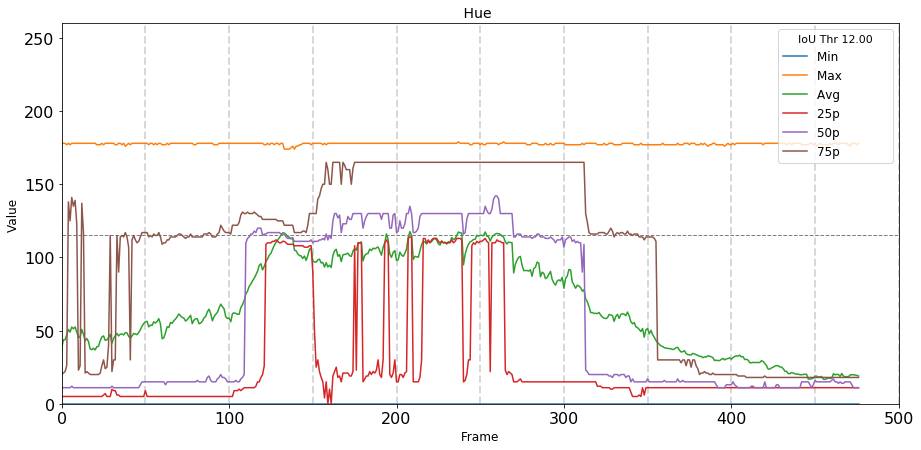

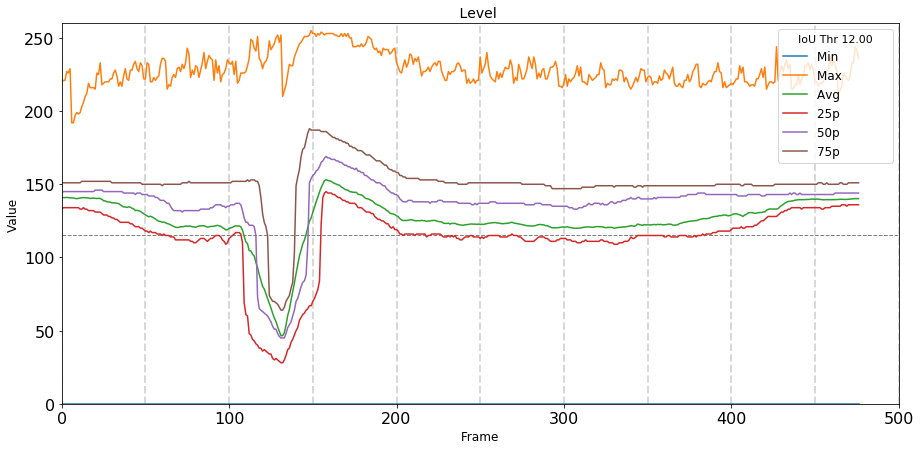

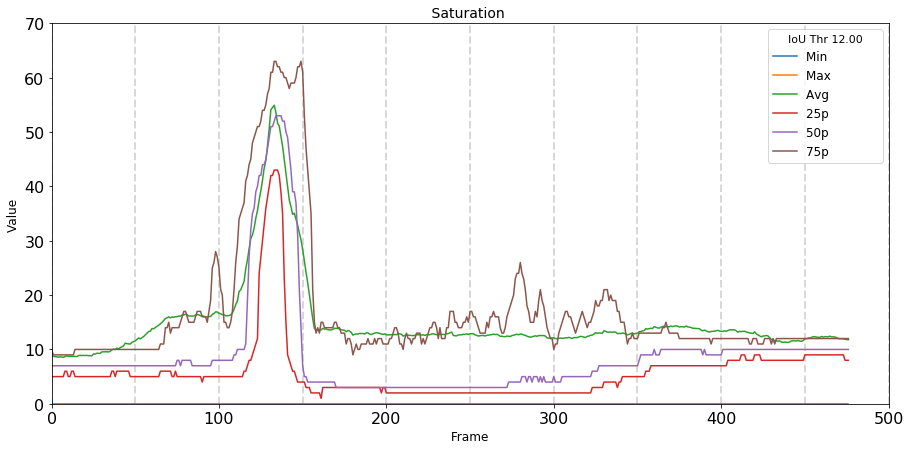

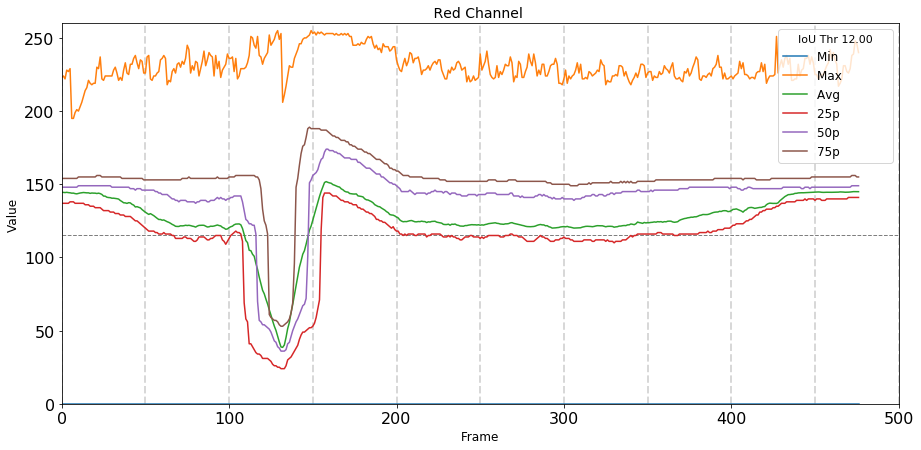

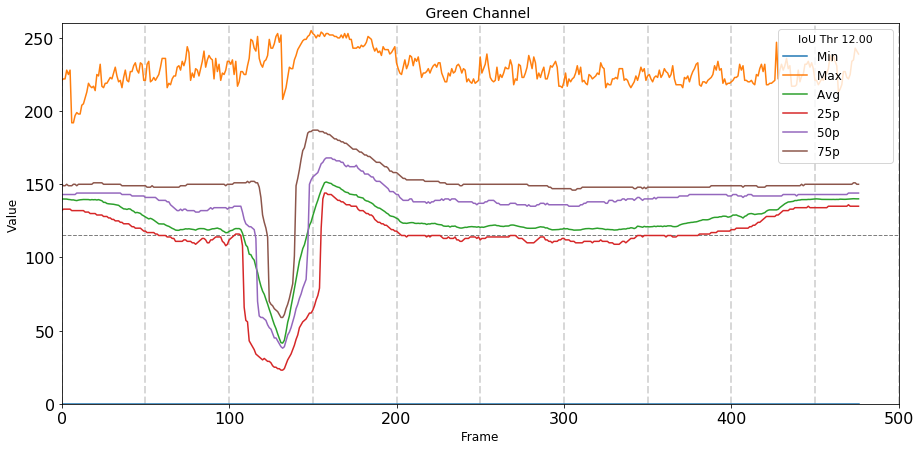

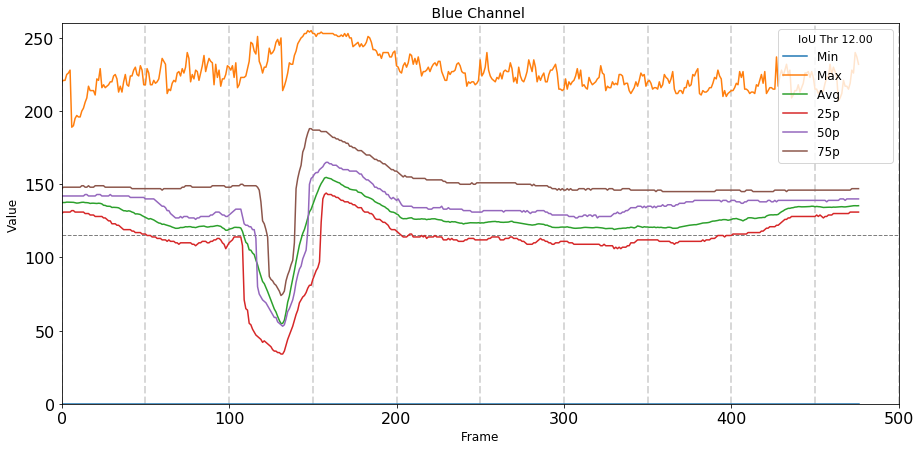

In [382]:
plots = plots_warped_v2
key2 = ['Min', 'Max', 'Avg', '25p', '50p', '75p']
labels = ['Min', 'Max', 'Avg', '25p', '50p', '75p']
plot_curves_for_one_class(plots, 'RGB', 'RGB Combined', key2, labels = labels)
plot_curves_for_one_class(plots, 'Hue', 'Hue', key2, labels = labels)
plot_curves_for_one_class(plots, 'Lvl', 'Level', key2, labels = labels)
plot_curves_for_one_class(plots, 'Sat', 'Saturation', key2, labels = labels, max_y = 70)
plot_curves_for_one_class(plots, 'Red', 'Red Channel', key2, labels = labels)
plot_curves_for_one_class(plots, 'Grn', 'Green Channel', key2, labels = labels)
plot_curves_for_one_class(plots, 'Blu', 'Blue Channel', key2, labels = labels)

In [149]:
# for i,j in plots.items():
#     print('{:5s}:  Min: {}   Max: {}   Avg:{:8.3f}     25%: {:5.1f}   50%: {:5.1f}   75%: {:5.1f}'.format(i, j['Min'], j['Max'], j['Avg'], j['25p'], j['50p'], j['75p']))    

In [169]:
# for i in plots['Hue'].keys():
#     print(i, len(plots['Hue'][i]))

In [170]:
# Hue = imgWarpedHLS[:,:,0]
# Lvl = imgWarpedHLS[:,:,1]
# Sat = imgWarpedHLS[:,:,2]
# Red = imgWarped[:,:,0]
# Grn = imgWarped[:,:,1]
# Blu = imgWarped[:,:,2]
# pct = [25, 50, 75]
# for i in [Hue, Lvl, Sat, Red, Grn, Blu]:
#     print('   :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(i.shape, i.min(),i.max(), i.mean(), np.percentile(i, pct)))    
# print(' Hue       :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Hue.shape, Hue.min(),Hue.max(), Hue.mean(), np.percentile(Hue, pct)))
# print(' Level     :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Lvl.shape, Lvl.min(),Lvl.max(), Lvl.mean(), np.percentile(Lvl, pct)))
# print(' Saturation:  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Sat.shape, Sat.min(),Sat.max(), Sat.mean(), np.percentile(Sat, pct)))
# print(' Red       :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Red.shape, Red.min(),Red.max(), Red.mean(), np.percentile(Red, pct)))
# print(' Green     :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Grn.shape, Grn.min(),Grn.max(), Grn.mean(), np.percentile(Grn, pct)))
# print(' Blue      :  Shape: {}    Min: {}   Max: {}   Avg:{:8.3f}  (25/50/75) pctls: {}'.format(Blu.shape, Blu.min(),Blu.max(), Blu.mean(), np.percentile(Blu, pct)))